**DemandModelling Part 2**

In [1]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-

# =============================================================================
# data prep pipeline (oop version) — patched
# =============================================================================

from __future__ import annotations

# stdlib
from dataclasses import dataclass, field
from pathlib import Path
from typing import Dict, List, Optional
import io  # needed to capture df.info() text

# third-party
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ---------------- Theme (no trailing commas!) ----------------
PRIMARY_COLOR    = "#12436D"  # Dark blue
TURQUOISE_COLOR  = "#28A197"  # Turquoise
DARK_PINK_COLOR  = "#801650"  # Dark pink
ORANGE_COLOR     = "#F46A25"  # Orange
DARK_GREY        = "#3D3D3D"  # Dark grey
LIGHT_PURPLE     = "#A285D1"  # Light purple
LIGHT_BG         = "#F5F5F5"  # Light gray background
DARK_TEXT        = "#333333"  # Dark text

PALETTE = [
    PRIMARY_COLOR, TURQUOISE_COLOR, DARK_PINK_COLOR, ORANGE_COLOR,
    DARK_GREY, LIGHT_PURPLE
]
YEAR_COLORS = {2020: PRIMARY_COLOR, 2021: TURQUOISE_COLOR, 2022: DARK_PINK_COLOR, 2023: ORANGE_COLOR}

def set_theme():
    plt.rcParams.update({
        "figure.figsize": (11, 6),
        "figure.dpi": 120,
        "figure.facecolor": "#ffffff",
        "axes.facecolor": "#ffffff",
        "axes.edgecolor": DARK_GREY,
        "axes.labelcolor": DARK_TEXT,
        "axes.titlesize": 16,
        "axes.titleweight": "bold",
        "grid.color": "#E6E6E6",
        "grid.alpha": 0.8,
        "axes.grid": True,
        "font.size": 12,
        "legend.frameon": False,
        "legend.edgecolor": "#00000000",
    })
    plt.rcParams['axes.prop_cycle'] = plt.cycler(color=PALETTE)
    # Times New Roman everywhere
    plt.rcParams.update({'font.family':'serif','font.serif':['Times New Roman','Times','serif']})

set_theme()

# =============================================================================
# configuration
# =============================================================================

@dataclass
class PrepConfig:
    """configuration for the data preparation pipeline.

    one-line summary:
        holds io paths, thresholds, and column rules for a reproducible run.

    args:
        csv_path: absolute or relative path to the input csv file.
        missing_drop_threshold: percentage (0–100) over which columns are dropped.
        rename_map: mapping from old column names to new names.
        drop_columns: explicit columns to drop after renaming (if present).
        random_seed: seed used to keep any stochastic steps reproducible.

    returns:
        none.
    """

    csv_path: Path
    missing_drop_threshold: float = 50.0
    rename_map: Dict[str, str] = field(
        default_factory=lambda: {
            # rename for clarity and consistency
            "segment_1_value": "primary_space_heating_fuel",
            "segment_2_value": "has_PV",
        }
    )
    drop_columns: List[str] = field(
        default_factory=lambda: ["segmentation_variable_1", "segmentation_variable_2", "summary_time"]
    )
    random_seed: int = 42


# =============================================================================
# pipeline
# =============================================================================

class DataPrepPipeline:
    """end-to-end data preparation and diagnostics for the energy dataset.

    one-line summary:
        loads, profiles, cleans, and returns a tidy dataframe with logs.

    args:
        config: instance of `PrepConfig` containing all run parameters.

    returns:
        none. use `.run()` to execute and retrieve the final dataframe.

    raises:
        filenotfounderror: if the csv path does not exist.
        valueerror: if input df is empty or badly formatted.
    """

    def __init__(self, config: PrepConfig):
        # keep run settings together for easy reproducibility
        self.cfg = config
        # seed numpy to keep any randomness deterministic
        np.random.seed(self.cfg.random_seed)

        # internal state holder
        self.df: Optional[pd.DataFrame] = None

    # -------------------------------------------------------------------------
    # io
    # -------------------------------------------------------------------------
    def load(self) -> pd.DataFrame:
        """load the csv with basic validation.

        returns:
            loaded dataframe.

        raises:
            filenotfounderror: if the file path is missing.
            valueerror: if the file loads but is empty.
        """
        path = Path(self.cfg.csv_path)
        if not path.exists():
            # fail early with a clear message
            raise FileNotFoundError(f"csv not found at: {path}")

        # read once; let pandas infer types reasonably
        df = pd.read_csv(path)

        if df.empty:
            # empty data is usually a bad sign worth stopping for
            raise ValueError("loaded dataframe is empty.")

        # store in state for subsequent steps
        self.df = df
        self._log(f"loaded shape: {df.shape[0]} rows × {df.shape[1]} cols")
        return df

    # -------------------------------------------------------------------------
    # quick diagnostics
    # -------------------------------------------------------------------------
    def basic_profile(self) -> dict:
        """produce a lightweight profile summary for sanity checks.

        returns:
            dictionary with head, info (as string), and describe summary.
        """
        self._ensure_loaded()

        # capture df.info() text into a string
        buf = io.StringIO()
        self.df.info(buf=buf)
        info_text = buf.getvalue()

        summary = {
            "shape": self.df.shape,
            "columns": list(self.df.columns),
            "dtypes": self.df.dtypes.astype(str).to_dict(),
            "info": info_text,
            "describe_numeric": self.df.describe().to_dict(),
            "head": self.df.head().to_dict(orient="records"),
        }

        self._log("generated basic profile.")
        return summary

    def inspect_categoricals(self) -> dict:
        """inspect object columns with counts and cardinalities.

        returns:
            mapping of column name to a small dict of stats.
        """
        self._ensure_loaded()

        cat_cols = self.df.select_dtypes(include="object").columns.tolist()
        out = {}
        for col in cat_cols:
            vc = self.df[col].value_counts(dropna=False)
            out[col] = {
                "nunique": int(self.df[col].nunique(dropna=False)),
                "top_values": vc.head(20).to_dict(),  # keep it compact
            }

        # special peek for 'quantity' if present
        if "quantity" in self.df.columns:
            out["_quantity_unique_preview"] = pd.unique(self.df["quantity"]).tolist()

        self._log(f"inspected {len(cat_cols)} categorical columns.")
        return out

    # -------------------------------------------------------------------------
    # missingness handling
    # -------------------------------------------------------------------------
    def missing_profile(self) -> pd.Series:
        """compute missing percentage per column.

        returns:
            series indexed by column with missing percentage (0–100).
        """
        self._ensure_loaded()

        missing_pct = self.df.isna().mean().mul(100).sort_values(ascending=False)
        self._log("computed missingness profile.")
        return missing_pct

    def drop_high_missing(self, missing_pct: Optional[pd.Series] = None) -> List[str]:
        """drop columns over the configured missingness threshold.

        args:
            missing_pct: optional precomputed missing series to reuse.

        returns:
            list of columns dropped.
        """
        self._ensure_loaded()

        if missing_pct is None:
            missing_pct = self.missing_profile()

        threshold = self.cfg.missing_drop_threshold
        to_drop = missing_pct[missing_pct > threshold].index.tolist()

        # drop in place if any
        if to_drop:
            self.df.drop(columns=to_drop, inplace=True, errors="ignore")
            self._log(f"dropped {len(to_drop)} high-missing columns (> {threshold}%): {to_drop}")
        else:
            self._log("no columns exceeded missingness threshold.")

        return to_drop

    # -------------------------------------------------------------------------
    # schema cleanup
    # -------------------------------------------------------------------------
    def rename_columns(self) -> Dict[str, str]:
        """rename columns using the configured mapping.

        returns:
            the mapping actually applied (only existing keys).
        """
        self._ensure_loaded()

        existing_map = {k: v for k, v in self.cfg.rename_map.items() if k in self.df.columns}
        if existing_map:
            self.df.rename(columns=existing_map, inplace=True)
            self._log(f"renamed columns: {existing_map}")
        else:
            self._log("no columns matched for renaming.")

        return existing_map

    def drop_columns(self) -> List[str]:
        """drop configured columns if they are present.

        returns:
            list of columns actually dropped.
        """
        self._ensure_loaded()

        present = [c for c in self.cfg.drop_columns if c in self.df.columns]
        if present:
            self.df.drop(columns=present, inplace=True, errors="ignore")
            self._log(f"dropped redundant columns: {present}")
        else:
            self._log("no redundant columns found to drop.")

        return present

    # -------------------------------------------------------------------------
    # orchestrator
    # -------------------------------------------------------------------------
    def run(self) -> pd.DataFrame:
        """run the full pipeline in the intended order.

        returns:
            cleaned dataframe ready for downstream work.
        """
        self.load()

        # quick, non-fatal diagnostics (kept for exploration)
        _ = self.basic_profile()
        _ = self.inspect_categoricals()

        # missingness → drop too-empty columns, then tidy names, then drop noise
        miss = self.missing_profile()
        _ = self.drop_high_missing(miss)
        _ = self.rename_columns()
        _ = self.drop_columns()

        self._log(f"final shape: {self.df.shape[0]} rows × {self.df.shape[1]} cols")
        return self.df.copy(deep=True)

    # -------------------------------------------------------------------------
    # internals
    # -------------------------------------------------------------------------
    def _ensure_loaded(self) -> None:
        """ensure dataframe is loaded before any operation.

        raises:
            runtimeerror: if `self.df` is None.
        """
        if self.df is None:
            # nudge the caller to run load()/run() first
            raise RuntimeError("dataframe is not loaded; call .load() or .run() first.")

    @staticmethod
    def _log(msg: str) -> None:
        """lightweight logger for consistent, quiet console messages.

        args:
            msg: message to print.

        returns:
            none.
        """
        print(f"[prep] {msg}")


# =============================================================================
# usage example (script entrypoint)
# =============================================================================

def main() -> None:
    """script entrypoint to run the pipeline end-to-end.

    returns:
        none.
    """
    # # todo: issue #1 add cli args via argparse if needed.

    # set up config; path can be relative to cwd
    cfg = PrepConfig(
        csv_path=Path("/Users/akanksha/Downloads/ERP_DSM_Dissertation_2025/data/csv/serl_daily_energy_use_in_gb_domestic_buildings_2020_to_2023_aggregated_statistics.csv"),
        missing_drop_threshold=50.0,
    )

    # run the pipeline
    pipe = DataPrepPipeline(cfg)
    cleaned = pipe.run()

    # small peek to confirm things look ok
    print("\n== preview of cleaned data ==")
    print(cleaned.head(10))


if __name__ == "__main__":
    # keep top-level side effects minimal and predictable
    main()


[prep] loaded shape: 531180 rows × 21 cols
[prep] generated basic profile.
[prep] inspected 11 categorical columns.
[prep] computed missingness profile.
[prep] no columns exceeded missingness threshold.
[prep] renamed columns: {'segment_1_value': 'primary_space_heating_fuel', 'segment_2_value': 'has_PV'}
[prep] dropped redundant columns: ['segmentation_variable_1', 'segmentation_variable_2', 'summary_time']
[prep] final shape: 531180 rows × 18 cols

== preview of cleaned data ==
              quantity            unit aggregation_period weekday_weekend  \
0                  Gas         kWh/day               2020            both   
1                  Gas         kWh/day               2020            both   
2                  Gas         kWh/day               2020            both   
3                  Gas      kWh/m2/day               2020            both   
4                  Gas      kWh/m2/day               2020            both   
5                  Gas      kWh/m2/day               2

In [3]:
df = pd.read_csv("/Users/akanksha/Downloads/ERP_DSM_Dissertation_2025/code/forcasting.csv")

In [9]:
from __future__ import annotations

# =============================================================================
# Malloc settings (must be first; harmless if unsupported)
# =============================================================================
import os
from pathlib import Path

try:
    os.environ["MallocStackLogging"] = "0"
    os.environ["MallocScribble"] = "1"
    os.environ["MallocGuardEdges"] = "1"
except Exception:
    pass


# =============================================================================
# Configuration
# =============================================================================
# Paths
DATA_PATH: Path = Path(
    "/Users/akanksha/Downloads/ERP_DSM_Dissertation_2025/code/forcasting.csv"
)
OUTPUT_DIR: Path = Path(
    "/Users/akanksha/Downloads/ERP_DSM_Dissertation_2025/code/"
)

# Time handling
TIME_COL: str = "aggregation_period"  # monthly 'YYYY-MM' or datetime
TIME_FORMAT_SUFFIX: str = "-01"       # append to parse month-start if needed

# Compound entity key (only parts present in the data will be used)
ENTITY_PARTS: list[str] = [
    "quantity",
    "segmentation_variable_3",
    "segment_3_value",
    "primary_space_heating_fuel",
    "has_PV",
    "weekday_weekend",
    "unit",
]

# Base numeric columns to engineer from
NUMERIC_BASE_COLS: list[str] = [
    "mean",
    "median",
    "75th_percentile",
    "mean_temp",
    "mean_hdd",
    "mean_solar",
]

# Time-series feature windows
ROLL_WINDOWS: list[int] = [6, 12]
LAGS: list[int] = [1, 3]

# Embedding (UMAP)
# Use a moderate neighbor count for more global context; low min_dist tightens clusters.
UMAP_N_NEIGHBORS: int = 15
UMAP_MIN_DIST: float = 0.1
UMAP_METRIC: str = "manhattan"  # often robust for tabular/TS after scaling

# Clustering (HDBSCAN)
# min_cluster_size = max(50, HDBSCAN_MIN_CLUSTER_FRAC * n_points)
HDBSCAN_MIN_CLUSTER_FRAC: float = 0.002
HDBSCAN_MIN_SAMPLES: int | None = 5        # None => defaults to min_cluster_size
HDBSCAN_SELECTION: str = "eom"             # faster than 'leaf' for overview

# Visualization sampling (keep plots snappy)
SCATTER_SAMPLE: int = 50_000
PER_CLUSTER_SAMPLE: int = 10_000
TOP_CLUSTERS: int = 10

# Scale / speed knobs
MAX_POINTS_FOR_EMBED: int = 50_000  # cap rows for UMAP/HDBSCAN; then propagate
KNN_PROPAGATE_K: int = 5             # neighbors for label propagation
RANDOM_SEED: int = 42

# =============================================================================
# Data loading / preprocessing
# =============================================================================
def load_monthly_data(path: Path) -> pd.DataFrame:
    df = pd.read_csv(path)

    # Parse month
    if np.issubdtype(df[TIME_COL].dtype, np.datetime64):
        df["period"] = pd.to_datetime(df[TIME_COL]).dt.to_period("M").dt.to_timestamp()
    else:
        # Handle strings like '2020' and '2020-01' → keep monthly only
        mask = df[TIME_COL].astype(str).str.len() >= 7
        df = df.loc[mask].copy()
        df["period"] = pd.to_datetime(df[TIME_COL].astype(str) + TIME_FORMAT_SUFFIX, errors="coerce")

    df = df.dropna(subset=["period"]).copy()

    # Build entity
    parts = [c for c in ENTITY_PARTS if c in df.columns]
    df["entity"] = df[parts].astype(str).agg("|".join, axis=1)

    # Basic QC: keep rows with enough stats if present
    if "n_rounded" in df.columns:
        df = df[df["n_rounded"].fillna(0) > 10].copy()

    # Sort for temporal ops
    df = df.sort_values(["entity", "period"]).reset_index(drop=True)
    return df

# =============================================================================
# Visualization (inline only) — optimized
# =============================================================================
def _sample(df: pd.DataFrame, n: int, seed: int = RANDOM_SEED) -> pd.DataFrame:
    """Return at most `n` random rows from df (stable seed)."""
    if (n is None) or (len(df) <= n):
        return df
    return df.sample(n, random_state=seed)


def viz_embedding_scatter(
    df: pd.DataFrame,
    title: str,
    sample: Optional[int] = SCATTER_SAMPLE,
    size: float = 8.0,
    alpha: float = 0.6,
) -> None:
    """Scatter of 2D embeddings colored by cluster label."""
    req = {"emb_x", "emb_y", "cluster"}
    if not req.issubset(df.columns):
        print("viz_embedding_scatter: required columns missing, skipping.")
        return

    use = _sample(df[["emb_x", "emb_y", "cluster"]], sample)
    plt.figure(figsize=(8, 6))
    plt.scatter(
        use["emb_x"].to_numpy(),
        use["emb_y"].to_numpy(),
        c=use["cluster"].to_numpy(),
        s=size,
        alpha=alpha,
        linewidths=0,
    )
    plt.title(title)
    plt.xlabel("Dim 1")
    plt.ylabel("Dim 2")
    plt.tight_layout()
    plt.show()


def viz_embedding_hexbin(
    df: pd.DataFrame,
    gridsize: int = 60,
    mincnt: int = 1,
) -> None:
    """Hexbin density view of the embedding."""
    req = {"emb_x", "emb_y"}
    if not req.issubset(df.columns):
        print("viz_embedding_hexbin: required columns missing, skipping.")
        return

    plt.figure(figsize=(8, 6))
    hb = plt.hexbin(
        df["emb_x"].to_numpy(),
        df["emb_y"].to_numpy(),
        gridsize=gridsize,
        mincnt=mincnt,
    )
    plt.title("Embedding density (hexbin)")
    plt.xlabel("Dim 1")
    plt.ylabel("Dim 2")
    cb = plt.colorbar(hb)
    cb.set_label("Count")
    plt.tight_layout()
    plt.show()


def viz_cluster_sizes(df: pd.DataFrame, top_k: int = 25) -> None:
    """Bar chart of largest cluster sizes (log scale)."""
    if "cluster" not in df.columns:
        print("viz_cluster_sizes: 'cluster' column missing, skipping.")
        return

    counts = df["cluster"].value_counts().sort_values(ascending=False)
    top = counts.head(top_k)

    plt.figure(figsize=(10, 4))
    plt.bar(top.index.astype(str), top.values)
    plt.yscale("log")
    plt.title(f"Top {top_k} cluster sizes (log scale)")
    plt.xlabel("Cluster label (-1 = noise)")
    plt.ylabel("Count")
    plt.tight_layout()
    plt.show()


def viz_top_clusters(
    df: pd.DataFrame,
    top_k: int = TOP_CLUSTERS,
    per_plot_sample: int = PER_CLUSTER_SAMPLE,
    point_size: float = 10.0,
) -> None:
    """Scatter per top cluster (by size)."""
    req = {"emb_x", "emb_y", "cluster"}
    if not req.issubset(df.columns):
        print("viz_top_clusters: required columns missing, skipping.")
        return

    counts = df[df["cluster"] != -1]["cluster"].value_counts().head(top_k)
    for c in counts.index:
        sub = _sample(df.loc[df["cluster"] == c, ["emb_x", "emb_y"]], per_plot_sample)
        plt.figure(figsize=(8, 6))
        plt.scatter(
            sub["emb_x"].to_numpy(),
            sub["emb_y"].to_numpy(),
            s=point_size,
            alpha=0.7,
            linewidths=0,
        )
        plt.title(f"Embedding: cluster {c} (n={len(sub)})")
        plt.xlabel("Dim 1")
        plt.ylabel("Dim 2")
        plt.tight_layout()
        plt.show()


def viz_composition(
    df: pd.DataFrame,
    by: str = "quantity",
    top_clusters: int = 10,
    top_cats: int = 8,
) -> None:
    """
    Stacked bar of category composition within the largest clusters.
    """
    req = {"cluster", by}
    if not req.issubset(df.columns):
        print(f"viz_composition: required columns {req} missing, skipping.")
        return

    sub = df[df["cluster"] != -1].copy()
    if sub.empty:
        print("viz_composition: no non-noise rows, skipping.")
        return

    top_cl = sub["cluster"].value_counts().head(top_clusters).index
    sub = sub[sub["cluster"].isin(top_cl)]
    top_vals = sub[by].value_counts().head(top_cats).index
    sub.loc[~sub[by].isin(top_vals), by] = "Other"

    comp = (
        sub.groupby(["cluster", by]).size().unstack(fill_value=0)
           .pipe(lambda x: x.div(x.sum(axis=1), axis=0))
           .sort_index()
    )

    # Manual stacked bars (faster & clearer)
    plt.figure(figsize=(10, 5))
    left = np.zeros(len(comp))
    xticks = np.arange(len(comp))
    for cat in comp.columns:
        vals = comp[cat].to_numpy()
        plt.bar(xticks, vals, bottom=left, label=cat)
        left += vals

    plt.title(f"Cluster composition by '{by}' (top {top_clusters} clusters)")
    plt.xlabel("Cluster")
    plt.ylabel("Share")
    plt.xticks(xticks, comp.index.astype(str))
    plt.legend(title=by, ncol=2)
    plt.tight_layout()
    plt.show()


def viz_monthly_heatmap(df: pd.DataFrame, top_clusters: int = 25) -> None:
    """
    Heatmap of monthly counts by cluster (largest clusters only).
    """
    req = {"cluster", "period"}
    if not req.issubset(df.columns):
        print("viz_monthly_heatmap: required columns missing, skipping.")
        return

    dd = df.copy()
    dd["month"] = pd.to_datetime(dd["period"]).dt.to_period("M").dt.to_timestamp()
    top = dd[dd["cluster"] != -1]["cluster"].value_counts().head(top_clusters).index
    dd = dd[dd["cluster"].isin(top)]
    if dd.empty:
        print("viz_monthly_heatmap: nothing to plot after filtering, skipping.")
        return

    mat = (
        dd.pivot_table(
            index="month", columns="cluster", values="period", aggfunc="count"
        ).fillna(0)
    )

    plt.figure(figsize=(12, 6))
    plt.imshow(mat.values, aspect="auto", interpolation="nearest")
    plt.title("Monthly counts by cluster (heatmap)")
    plt.xlabel("Cluster")
    plt.ylabel("Month")
    plt.yticks(range(len(mat.index)), [d.strftime("%Y-%m") for d in mat.index])
    plt.xticks(range(len(mat.columns)), mat.columns.astype(str), rotation=90)
    plt.colorbar(label="Count")
    plt.tight_layout()
    plt.show()


def viz_cluster_profiles(
    df: pd.DataFrame,
    value_col: str = "mean",
    top_clusters: int = TOP_CLUSTERS,
    show_iqr: bool = True,
) -> None:
    """
    For each of the largest clusters, plot monthly median of `value_col`
    (with optional IQR band).
    """
    req = {"cluster", "period", value_col}
    if not req.issubset(df.columns):
        print(f"viz_cluster_profiles: required columns {req} missing, skipping.")
        return

    dd = df[df["cluster"] != -1].copy()
    if dd.empty:
        print("viz_cluster_profiles: no non-noise rows, skipping.")
        return

    dd["month"] = pd.to_datetime(dd["period"]).dt.to_period("M").dt.to_timestamp()
    top = dd["cluster"].value_counts().head(top_clusters).index

    for c in top:
        sub = dd.loc[dd["cluster"] == c, ["month", value_col]]
        grp = sub.groupby("month")[value_col]
        med = grp.median()
        if med.empty:
            continue

        plt.figure(figsize=(9, 4))
        plt.plot(med.index, med.values, linewidth=2)
        if show_iqr:
            q1 = grp.quantile(0.25).reindex(med.index).to_numpy()
            q3 = grp.quantile(0.75).reindex(med.index).to_numpy()
            plt.fill_between(med.index, q1, q3, alpha=0.25)

        plt.title(f"Cluster {c} – median {value_col} over time")
        plt.xlabel("Month")
        plt.ylabel(value_col)
        plt.tight_layout()
        plt.show()
        
# =============================================================================
# Embedding + clustering
# =============================================================================

def compute_embedding(X_scaled: np.ndarray) -> Tuple[np.ndarray, str]:
    """
    PCA (randomized, up to 20 comps) -> UMAP(2D, cosine) for tabular TS.
    Falls back to 2D PCA if umap-learn is not available.
    """
    # PCA preconditioning keeps UMAP fast/stable
    n_pc = int(min(20, X_scaled.shape[1]))
    pc = PCA(n_components=n_pc, svd_solver="randomized", random_state=RANDOM_SEED).fit_transform(X_scaled)

    try:
        import umap  # type: ignore
        reducer = umap.UMAP(
            n_neighbors=UMAP_N_NEIGHBORS,
            min_dist=UMAP_MIN_DIST,
            n_components=2,
            metric=UMAP_METRIC,     # <-- fixed typo (was "mmetric")
            random_state=RANDOM_SEED,
            n_jobs=-1,              # parallel NN search if backend supports it
        )
        emb = reducer.fit_transform(pc)
        method = "umap"
    except Exception:
        # Fallback: just the first two PCs
        emb = pc[:, :2]
        method = "pca"

    return emb, method


def cluster_embedding(emb: np.ndarray) -> Tuple[np.ndarray, str]:
    """
    HDBSCAN with dynamic min_cluster_size (fraction of n points).
    Falls back to DBSCAN with a 5-NN distance heuristic for eps.
    """
    # Compute dynamic min_cluster_size from fraction, with floor at 50
    try:
        import hdbscan  # type: ignore

        min_size = max(50, int(HDBSCAN_MIN_CLUSTER_FRAC * len(emb)))
        clusterer = hdbscan.HDBSCAN(
            min_cluster_size=min_size,
            min_samples=HDBSCAN_MIN_SAMPLES,       # None => defaults to min_cluster_size
            cluster_selection_method=HDBSCAN_SELECTION,
            core_dist_n_jobs=-1,                   # parallelize core distances
            prediction_data=True,
        )
        labels = clusterer.fit_predict(emb)
        method = "hdbscan"
        return labels, method

    except Exception:
        # Fallback: DBSCAN with eps from 5-NN distances
        from sklearn.cluster import DBSCAN
        from sklearn.neighbors import NearestNeighbors

        nbrs = NearestNeighbors(n_neighbors=5).fit(emb)
        distances, _ = nbrs.kneighbors(emb)

        # Use a high quantile for eps to reduce over-noising on dense manifolds
        # and multiply slightly to be permissive
        d5 = distances[:, -1]
        eps = float(np.quantile(d5, 0.90) * 1.3)

        labels = DBSCAN(eps=eps, min_samples=20, n_jobs=-1).fit_predict(emb)
        method = "dbscan"
        return labels, method

# =============================================================================
# Feature engineering 
# =============================================================================

def _ensure_numeric_cols(df: pd.DataFrame, cols: Iterable[str]) -> List[str]:
    """Return the subset of `cols` that exist in `df` and are numeric."""
    return [c for c in cols if c in df.columns and pd.api.types.is_numeric_dtype(df[c])]


def add_lag_features(df: pd.DataFrame,
                     cols: Iterable[str],
                     lags: Iterable[int]) -> pd.DataFrame:
    """
    Add per-entity lag features for all `cols` in a vectorized manner.
    Creates columns like `<col>_lag{L}`.
    """
    use_cols = _ensure_numeric_cols(df, cols)
    if not use_cols or not lags:
        return df

    out = df.copy()
    g = out.groupby("entity", sort=False)[use_cols]

    # Build all lagged frames and concat once for speed
    lag_frames = []
    for L in lags:
        shifted = g.shift(L)
        shifted.columns = [f"{c}_lag{L}" for c in use_cols]
        lag_frames.append(shifted)

    out = pd.concat([out] + lag_frames, axis=1)
    return out


def add_rolling_features(df: pd.DataFrame,
                         cols: Iterable[str],
                         windows: Iterable[int]) -> pd.DataFrame:
    """
    Add per-entity rolling mean/std for all `cols` and each window in `windows`.
    Creates `<col>_rollmean_{w}` and `<col>_rollstd_{w}`.
    """
    use_cols = _ensure_numeric_cols(df, cols)
    if not use_cols or not windows:
        return df

    out = df.copy()
    g = out.groupby("entity", sort=False)[use_cols]

    roll_frames = []
    for w in windows:
        roll = g.rolling(w, min_periods=max(2, w // 2))
        mean_vals = roll.mean().reset_index(level=0, drop=True)
        std_vals = roll.std().reset_index(level=0, drop=True)
        mean_vals.columns = [f"{c}_rollmean_{w}" for c in use_cols]
        std_vals.columns = [f"{c}_rollstd_{w}" for c in use_cols]
        roll_frames.extend([mean_vals, std_vals])

    out = pd.concat([out] + roll_frames, axis=1)
    return out


def drop_warmup(df: pd.DataFrame,
                roll_windows: Optional[Iterable[int]] = None,
                lags: Optional[Iterable[int]] = None) -> pd.DataFrame:
    """
    Drop the first `warmup` rows per entity so lag/rolling features are valid.
    `warmup` is max(max(roll_windows), max(lags)).
    """
    roll_windows = list(roll_windows or [])
    lags = list(lags or [])
    warmup = max(max(roll_windows, default=0), max(lags, default=0))
    if warmup <= 0:
        return df.reset_index(drop=True)

    # Faster than groupby-apply+iloc
    mask = df.groupby("entity").cumcount() >= warmup
    return df.loc[mask].reset_index(drop=True)


def standardize_feature_matrix(feat: pd.DataFrame) -> Tuple[np.ndarray, List[str], StandardScaler]:
    """
    Build matrix from engineered features only, fill gaps, and scale.
    Returns (X_scaled, feature_names, scaler).
    """
    feat_cols = [
        c for c in feat.columns
        if pd.api.types.is_numeric_dtype(feat[c])
        and any(k in c for k in ("_lag", "rollmean_", "rollstd_", "_pct_change", "_norm"))
    ]
    if not feat_cols:
        raise ValueError("No engineered numeric features available to scale.")

    X = feat[feat_cols].astype(float)
    # Forward/backward fill down the time order (per entire frame),
    # then zero-fill any remaining leading/trailing gaps.
    X_filled = X.ffill().bfill().fillna(0.0)


    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X_filled)
    return X_scaled, feat_cols, scaler


def drop_highly_correlated_features(feat: pd.DataFrame,
                                    threshold: float = 0.95) -> pd.DataFrame:
    """
    Drop engineered *numeric* features whose absolute pairwise correlation
    exceeds `threshold`. Only considers columns created by lags/rollings
    (and optionally pct_change/norm if present).
    """
    eng_cols = [
        c for c in feat.columns
        if pd.api.types.is_numeric_dtype(feat[c])
        and any(k in c for k in ("_lag", "rollmean_", "rollstd_", "_pct_change", "_norm"))
    ]
    if len(eng_cols) < 2:
        return feat

    X = feat[eng_cols].astype(float)
    corr = X.corr().abs()
    upper = corr.where(np.triu(np.ones(corr.shape), k=1).astype(bool))

    to_drop = [col for col in upper.columns if any(upper[col] > threshold)]
    if to_drop:
        print(f"Dropping {len(to_drop)} high-corr features (>{threshold})")
        feat = feat.drop(columns=to_drop)

    return feat


def add_seasonality_features(df: pd.DataFrame,
                             time_col: str = "period") -> pd.DataFrame:
    """
    Add cyclic encodings for month/quarter to capture seasonality.
    `time_col` must be datetime-like or parseable to datetime.
    """
    out = df.copy()
    dt = pd.to_datetime(out[time_col])
    month = dt.dt.month
    quarter = dt.dt.quarter

    out["month_sin"] = np.sin(2 * np.pi * month / 12.0)
    out["month_cos"] = np.cos(2 * np.pi * month / 12.0)
    out["quarter_sin"] = np.sin(2 * np.pi * quarter / 4.0)
    out["quarter_cos"] = np.cos(2 * np.pi * quarter / 4.0)
    return out


def add_relative_change_features(df: pd.DataFrame, cols: List[str]) -> pd.DataFrame:
    """
    Add per-entity percent change features for each numeric col in `cols`.
    Creates `<col>_pct_change`, with inf values replaced by NaN.
    """
    use_cols = _ensure_numeric_cols(df, cols)
    if not use_cols:
        return df

    out = df.copy().sort_values(["entity", "period"])
    g = out.groupby("entity", sort=False)
    for col in use_cols:
        pct = g[col].pct_change().replace([np.inf, -np.inf], np.nan)
        out[f"{col}_pct_change"] = pct

    return out


def merge_external_data(df: pd.DataFrame,
                        external_path: Path,
                        on_cols: List[str]) -> pd.DataFrame:
    """
    Merge an external CSV containing a `period` column (parsed to datetime)
    and any other keys listed in `on_cols`.
    """
    ext = pd.read_csv(external_path)
    if "period" in ext.columns:
        ext["period"] = pd.to_datetime(ext["period"])
    missing = [c for c in on_cols if c not in ext.columns]
    if missing:
        raise ValueError(f"External data missing join keys: {missing}")
    return df.merge(ext, on=on_cols, how="left")




Loading data...
Loaded 366098 rows with 8206 unique entities
Data loading time: 1.56 seconds
Engineering features...
Dropping 19 high-corr features (>0.95)
Feature engineering time: 3.12 seconds
Preparing feature matrix...
Using 23 features for embedding
Feature matrix preparation time: 0.10 seconds
Dataset too large (268425 rows), sampling 50000 points...
Computing embedding...
Used umap for dimensionality reduction
Embedding computation time: 38.13 seconds
Clustering embedding...
Used hdbscan for clustering
Found 195 clusters (including noise)
Clustering time: 3.23 seconds
Propagating labels to full dataset...
Generating visualizations...


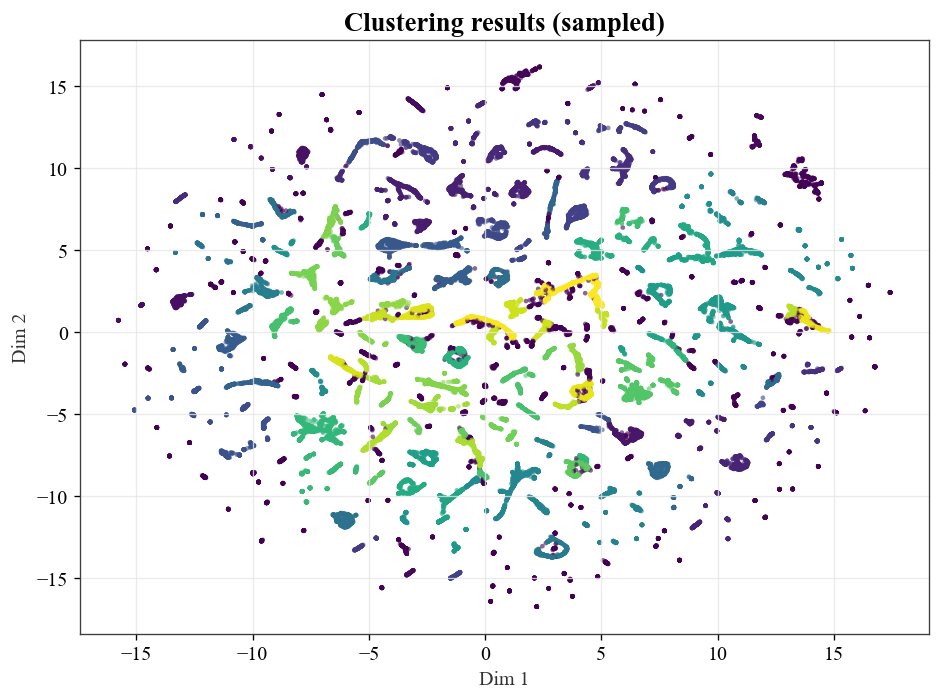

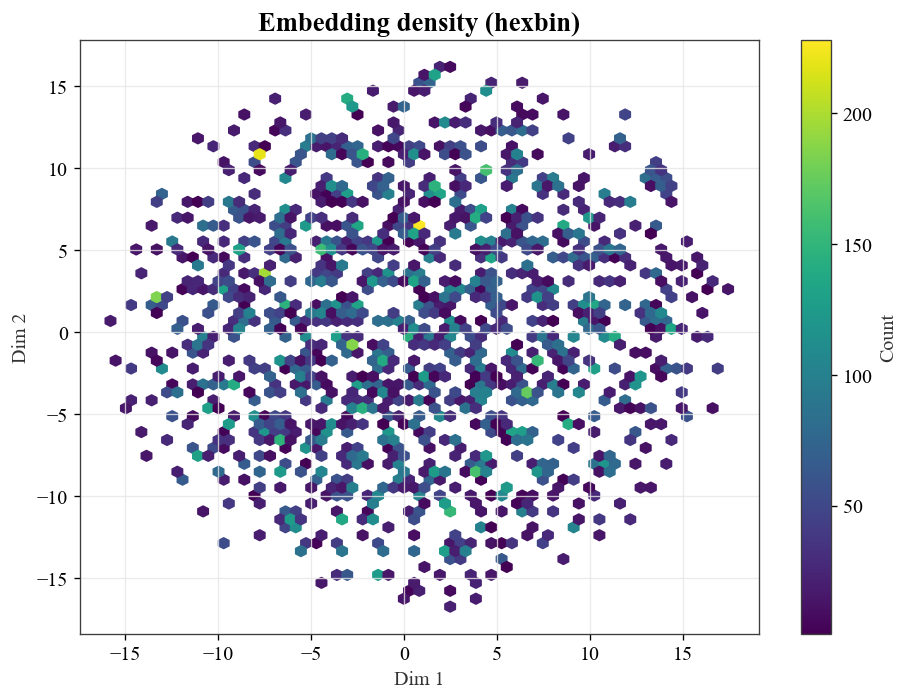

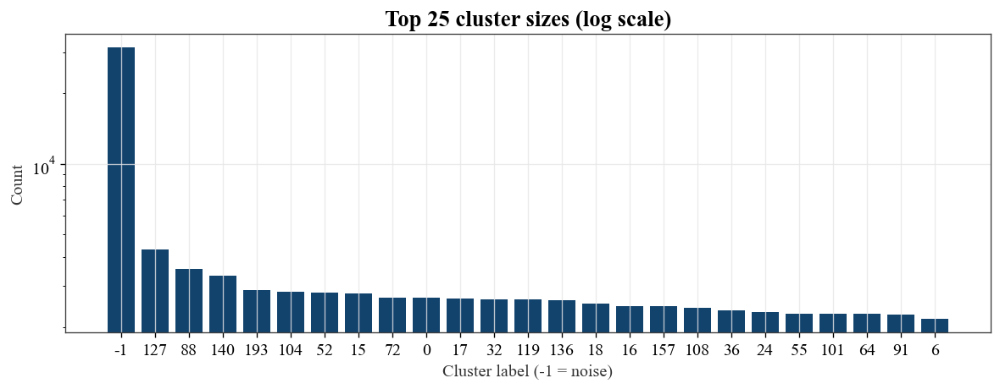

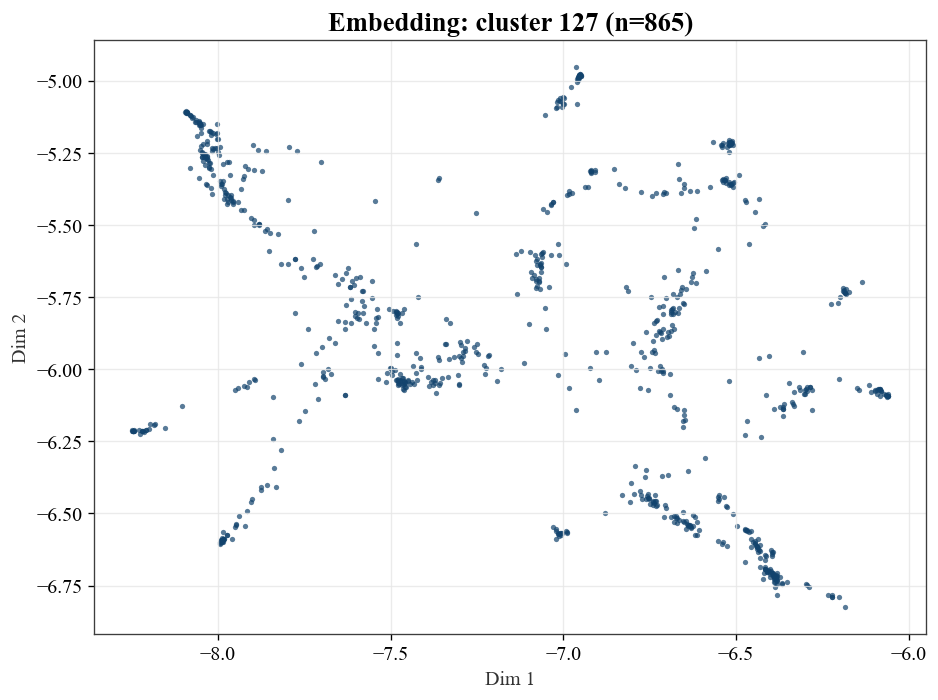

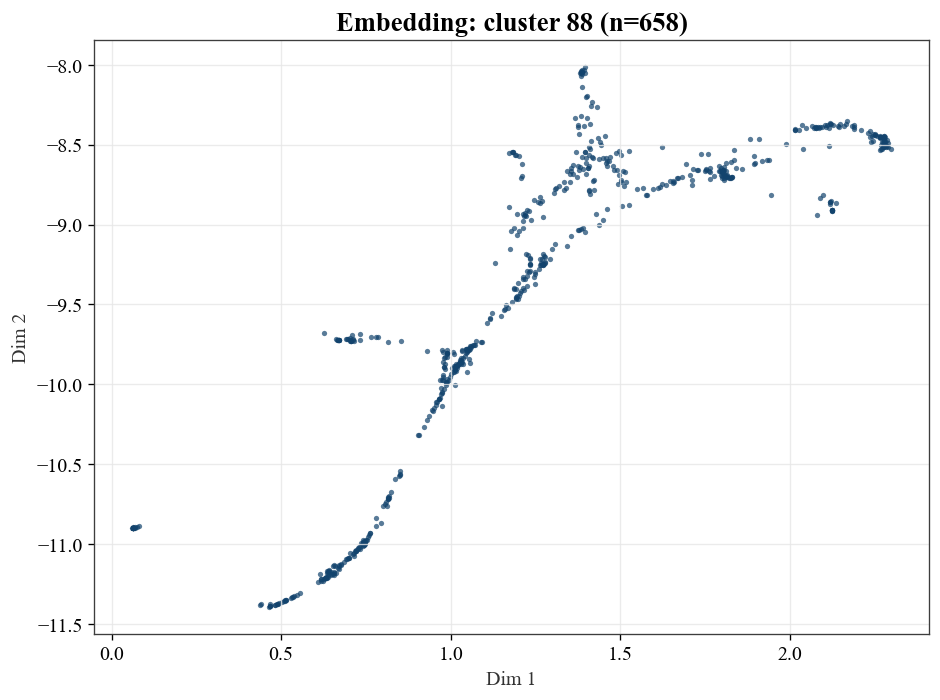

...

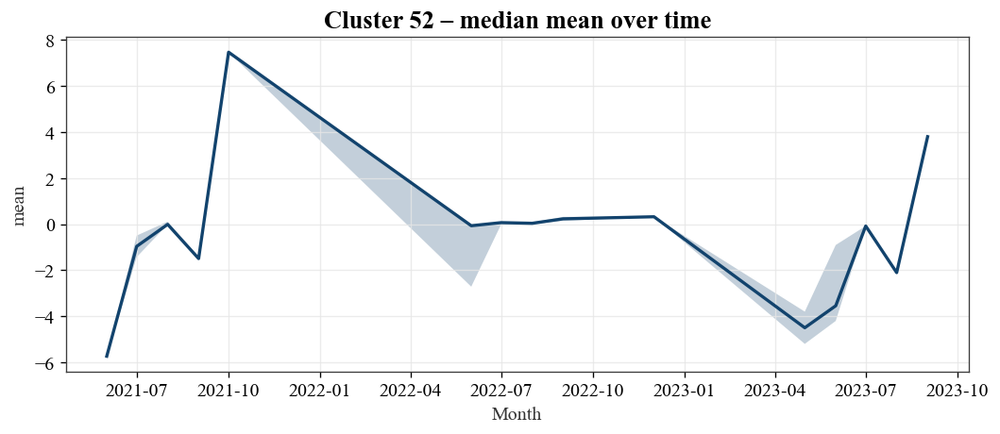

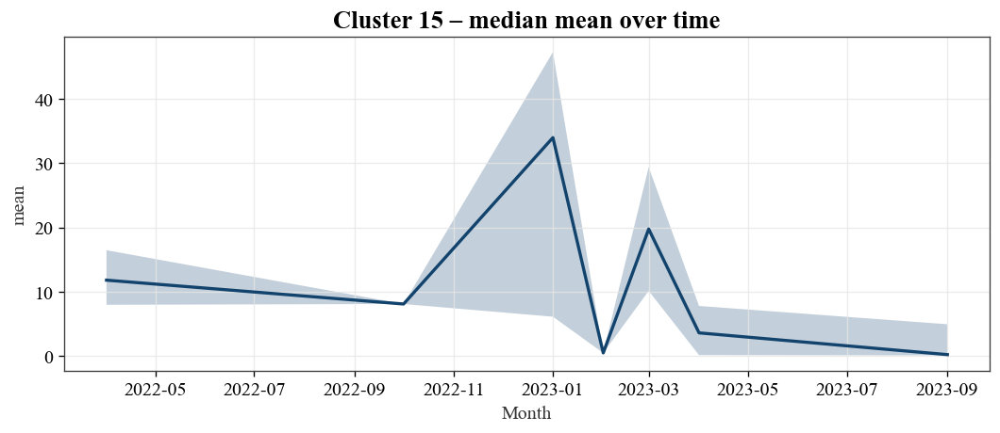

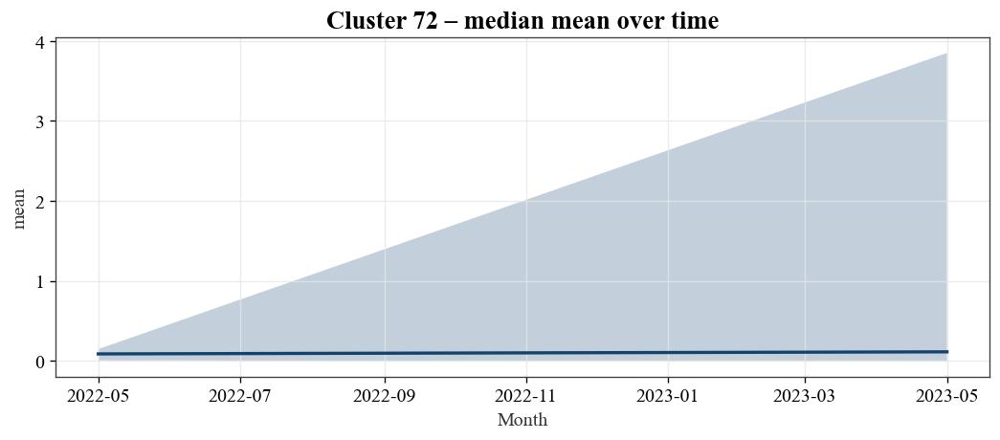

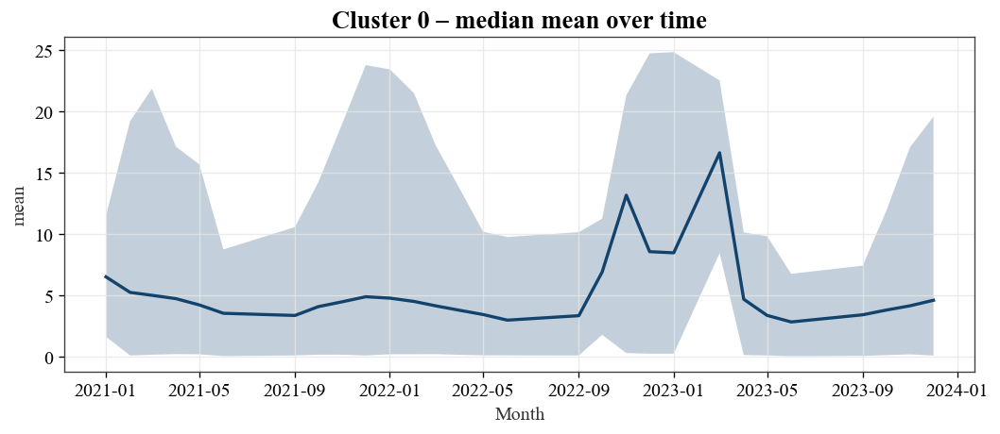

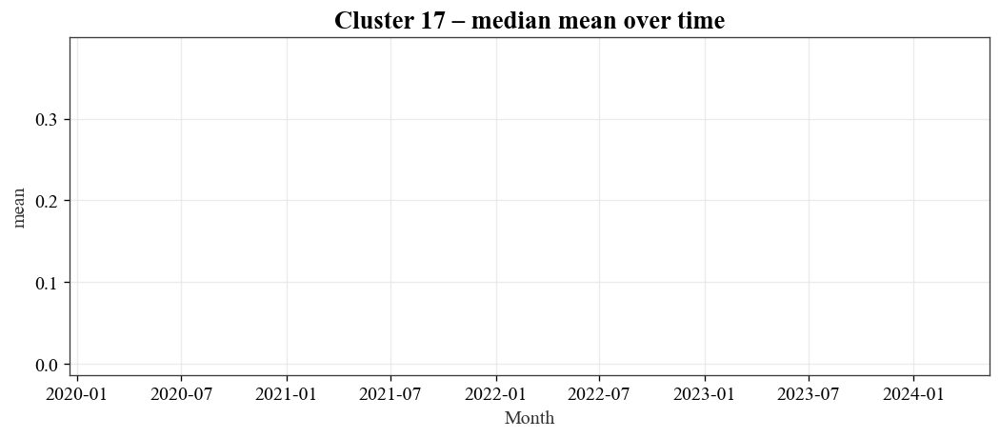

Visualization time: 2.78 seconds
Results saved to /Users/akanksha/Downloads/ERP_DSM_Dissertation_2025/code/clustering_results.csv
Total execution time: 62.89 seconds (1.05 minutes)


In [10]:
# =============================================================================
# Main execution module for time series clustering (Optimized)
# =============================================================================
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from typing import Optional, Tuple, List, Iterable
import warnings
import time
warnings.filterwarnings('ignore')

# Define theme colors
PRIMARY_COLOR    = "#12436D"  # Dark blue
TURQUOISE_COLOR  = "#28A197"  # Turquoise
DARK_PINK_COLOR  = "#801650"  # Dark pink
ORANGE_COLOR     = "#F46A25"  # Orange
DARK_GREY        = "#3D3D3D"  # Dark grey
LIGHT_PURPLE     = "#A285D1"  # Light purple
LIGHT_BG         = "#F5F5F5"  # Light gray background
DARK_TEXT        = "#333333"  # Dark text

PALETTE = [
    PRIMARY_COLOR, TURQUOISE_COLOR, DARK_PINK_COLOR, ORANGE_COLOR,
    DARK_GREY, LIGHT_PURPLE
]
YEAR_COLORS = {2020: PRIMARY_COLOR, 2021: TURQUOISE_COLOR, 2022: DARK_PINK_COLOR, 2023: ORANGE_COLOR}

def set_theme():
    plt.rcParams.update({
        "figure.figsize": (11, 6),
        "figure.dpi": 120,
        "figure.facecolor": "#ffffff",
        "axes.facecolor": "#ffffff",
        "axes.edgecolor": DARK_GREY,
        "axes.labelcolor": DARK_TEXT,
        "axes.titlesize": 16,
        "axes.titleweight": "bold",
        "grid.color": "#E6E6E6",
        "grid.alpha": 0.8,
        "axes.grid": True,
        "font.size": 12,
        "legend.frameon": False,
        "legend.edgecolor": "#00000000",
    })

# Apply theme
set_theme()

def main():
    """
    Optimized main function that executes the full time series clustering pipeline.
    """
    start_time = time.time()
    print("Loading data...")
    df = load_monthly_data(DATA_PATH)
    print(f"Loaded {len(df)} rows with {df['entity'].nunique()} unique entities")
    print(f"Data loading time: {time.time() - start_time:.2f} seconds")
    
    # Feature engineering
    feat_start = time.time()
    print("Engineering features...")
    df = add_lag_features(df, NUMERIC_BASE_COLS, LAGS)
    df = add_rolling_features(df, NUMERIC_BASE_COLS, ROLL_WINDOWS)
    df = add_seasonality_features(df)
    df = add_relative_change_features(df, NUMERIC_BASE_COLS)
    
    # Drop warmup periods and correlated features
    df = drop_warmup(df, ROLL_WINDOWS, LAGS)
    df = drop_highly_correlated_features(df, threshold=0.95)
    print(f"Feature engineering time: {time.time() - feat_start:.2f} seconds")
    
    # Prepare feature matrix
    matrix_start = time.time()
    print("Preparing feature matrix...")
    X_scaled, feature_names, scaler = standardize_feature_matrix(df)
    print(f"Using {len(feature_names)} features for embedding")
    print(f"Feature matrix preparation time: {time.time() - matrix_start:.2f} seconds")
    
    # Handle large datasets by sampling if needed - reduced sample size
    sample_size = min(MAX_POINTS_FOR_EMBED, len(X_scaled))
    if len(X_scaled) > sample_size:
        print(f"Dataset too large ({len(X_scaled)} rows), sampling {sample_size} points...")
        sample_idx = np.random.choice(len(X_scaled), sample_size, replace=False)
        X_sample = X_scaled[sample_idx]
        df_sample = df.iloc[sample_idx].copy()
    else:
        X_sample = X_scaled
        df_sample = df.copy()
    
    # Compute embedding with faster parameters
    embed_start = time.time()
    print("Computing embedding...")
    emb, emb_method = compute_embedding(X_sample)
    df_sample['emb_x'] = emb[:, 0]
    df_sample['emb_y'] = emb[:, 1]
    print(f"Used {emb_method} for dimensionality reduction")
    print(f"Embedding computation time: {time.time() - embed_start:.2f} seconds")
    
    # Cluster embedding with faster method
    cluster_start = time.time()
    print("Clustering embedding...")
    labels, cluster_method = cluster_embedding(emb)
    df_sample['cluster'] = labels
    print(f"Used {cluster_method} for clustering")
    print(f"Found {len(np.unique(labels))} clusters (including noise)")
    print(f"Clustering time: {time.time() - cluster_start:.2f} seconds")
    
    # Propagate labels to full dataset if we sampled
    if len(X_scaled) > sample_size:
        print("Propagating labels to full dataset...")
        from sklearn.neighbors import KNeighborsClassifier
        knn = KNeighborsClassifier(n_neighbors=KNN_PROPAGATE_K)
        knn.fit(X_sample, labels)
        df['cluster'] = knn.predict(X_scaled)
        
        # For embedding coordinates, we'll only keep them for the sample
        df['emb_x'] = np.nan
        df['emb_y'] = np.nan
        df.loc[df_sample.index, 'emb_x'] = df_sample['emb_x']
        df.loc[df_sample.index, 'emb_y'] = df_sample['emb_y']
    else:
        df['cluster'] = labels
        df['emb_x'] = emb[:, 0]
        df['emb_y'] = emb[:, 1]
    
    # Visualizations
    viz_start = time.time()
    print("Generating visualizations...")
    viz_embedding_scatter(df_sample, "Clustering results (sampled)")
    viz_embedding_hexbin(df_sample)
    viz_cluster_sizes(df)
    viz_top_clusters(df_sample)
    viz_composition(df, by="quantity")
    viz_monthly_heatmap(df)
    viz_cluster_profiles(df, value_col="mean")
    print(f"Visualization time: {time.time() - viz_start:.2f} seconds")
    
    # Save results
    output_path = OUTPUT_DIR / "clustering_results.csv"
    df.to_csv(output_path, index=False)
    print(f"Results saved to {output_path}")
    
    total_time = time.time() - start_time
    print(f"Total execution time: {total_time:.2f} seconds ({total_time/60:.2f} minutes)")
    
    return df

if __name__ == "__main__":
    # Add these configuration optimizations at the top of your script
    # Reduced sample size for faster processing
    MAX_POINTS_FOR_EMBED = 50000  # Reduced from 200000
    
    # Faster UMAP parameters
    UMAP_N_NEIGHBORS = 15         # Reduced from 50 for faster computation
    UMAP_MIN_DIST = 0.1           # Increased from 0.05 for faster computation
    
    # Alternative clustering option (uncomment to use)
    # USE_FAST_CLUSTERING = True   # Set to True to use faster clustering method
    
    # Import the necessary functions (they should be in the same module)
    # If they're in a separate module, import them here
    
    # You'll also need to modify the cluster_embedding function to accept an option for faster clustering:
    """
    def cluster_embedding(emb: np.ndarray, fast: bool = False) -> Tuple[np.ndarray, str]:
        if fast:
            # Use faster clustering method (K-Means)
            from sklearn.cluster import KMeans
            # Estimate number of clusters using a heuristic
            n_clusters = min(50, int(np.sqrt(len(emb)) // 2))
            clusterer = KMeans(n_clusters=n_clusters, random_state=RANDOM_SEED, n_init=10)
            labels = clusterer.fit_predict(emb)
            return labels, "kmeans"
        else:
            # Your existing HDBSCAN/DBSCAN code
            ...
    """
    
    # Then in main(), call:
    # labels, cluster_method = cluster_embedding(emb, fast=USE_FAST_CLUSTERING)
    
    df_result = main()

In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
df = pd.read_csv('/Users/akanksha/Downloads/ERP_DSM_Dissertation_2025/code/clustering_results.csv')

# Select numerical features for clustering
numerical_features = ['mean', 'standard_deviation', 'median', '25th_percentile', 
                     '75th_percentile', 'mean_temp', 'mean_hdd', 'mean_solar', 'n_rounded']

# Handle missing values if any
df_numerical = df[numerical_features].dropna()

# Standardize the features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df_numerical)

# Reduce dimensionality using PCA for better clustering
pca = PCA(n_components=2)
pca_features = pca.fit_transform(scaled_features)

# Determine optimal number of clusters using elbow method
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(scaled_features)
    wcss.append(kmeans.inertia_)

# Plot elbow curve
plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), wcss, marker='o')
plt.title('Elbow Method for Optimal Cluster Number')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

# Based on elbow method, choose optimal number of clusters (example: 3)
optimal_clusters = 3
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
clusters = kmeans.fit_predict(scaled_features)

# Add cluster labels to dataframe
df_numerical['Cluster'] = clusters

# Calculate correlation with target variable (mean) for each cluster
cluster_correlations = []
for cluster in range(optimal_clusters):
    cluster_data = df_numerical[df_numerical['Cluster'] == cluster]
    correlation = cluster_data.corr()['mean'].drop('mean')
    cluster_correlations.append(correlation)

# Identify clusters with positive correlation to mean
positive_clusters = []
for i, correlation in enumerate(cluster_correlations):
    if any(correlation > 0.5):  # Adjust threshold as needed
        positive_clusters.append(i)

# Label positive correlation clusters
df_numerical['Positive_Correlation_Label'] = df_numerical['Cluster'].apply(
    lambda x: 'Positive_Correlation' if x in positive_clusters else 'Other'
)

# Visualize clusters with positive correlation
plt.figure(figsize=(12, 8))
sns.scatterplot(x=pca_features[:, 0], y=pca_features[:, 1], 
                hue=df_numerical['Positive_Correlation_Label'], 
                palette='viridis', s=50)
plt.title('Clusters with Positive Correlation to Mean')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.legend()
plt.show()

# Print summary of positive correlation clusters
print("Clusters with positive correlation to mean:", positive_clusters)
for cluster in positive_clusters:
    print(f"\nCluster {cluster} statistics:")
    print(df_numerical[df_numerical['Cluster'] == cluster].describe())

Unique quantities: ['Electricity exports', 'Electricity imports', 'Electricity net', 'Gas', 'Gas + electricity imports']
Units present: ['kWh/day', 'kWh/m2/day', 'kWh/person/day']

=== Cluster 0 ===
Persona Label: Mixed Imports, strongly seasonal, peak in Dec 2022


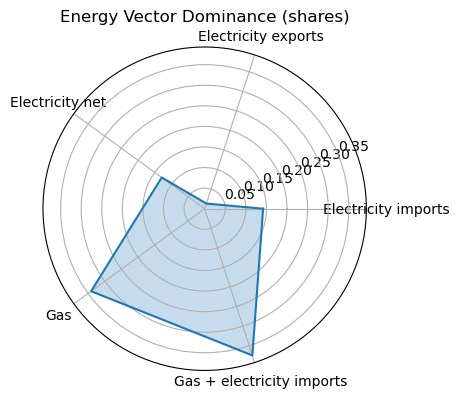

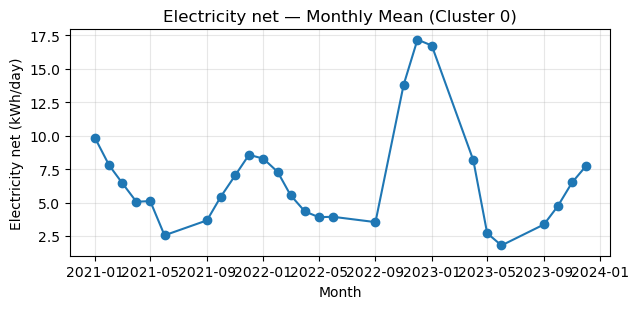

Target series: Electricity net | Seasonality strength (12-mo STL): 0.95
Peak month: Dec 2022

=== Cluster 1 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Dec 2022


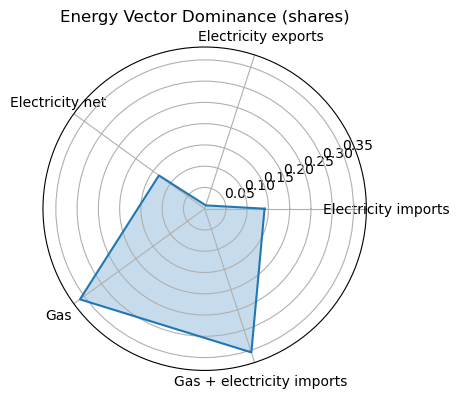

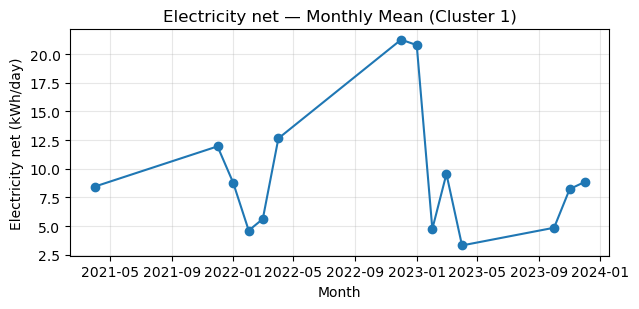

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2022

=== Cluster 2 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Nov 2021


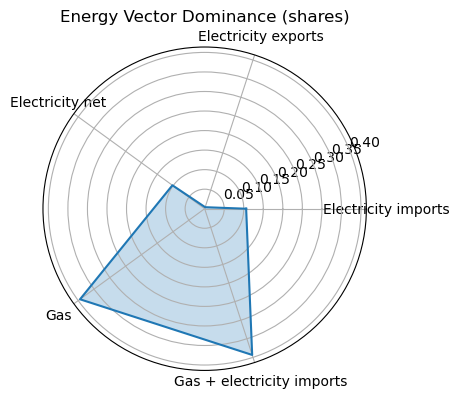

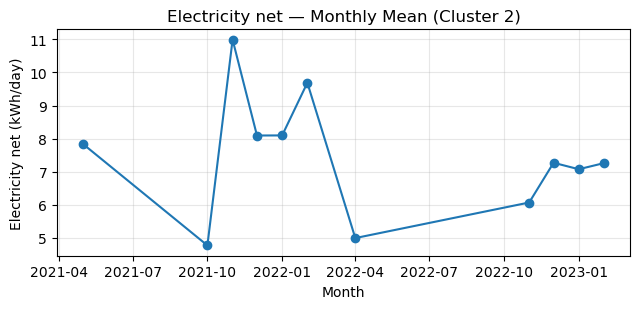

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2021

=== Cluster 3 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Dec 2022


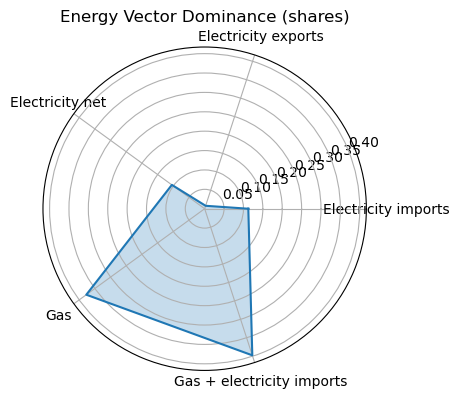

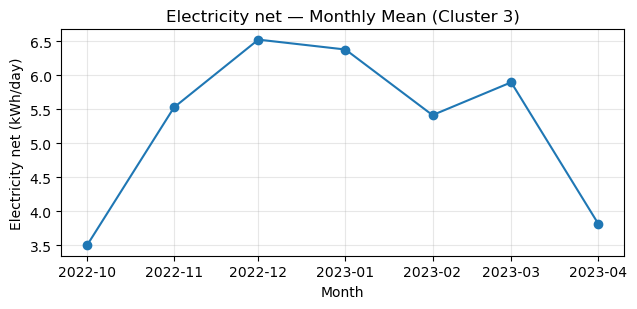

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2022

=== Cluster 4 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Apr 2023


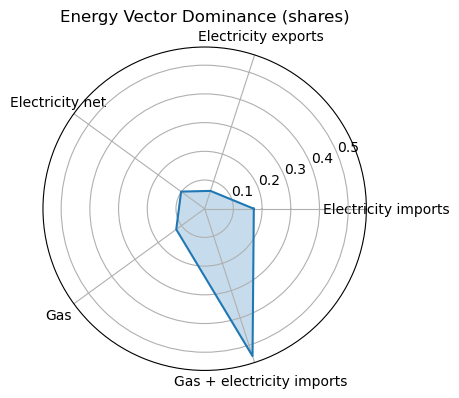

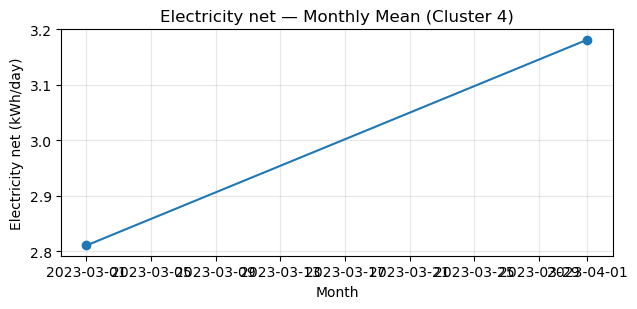

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2023

=== Cluster 5 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Aug 2023


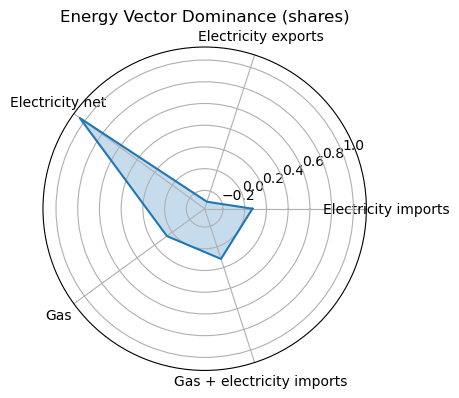

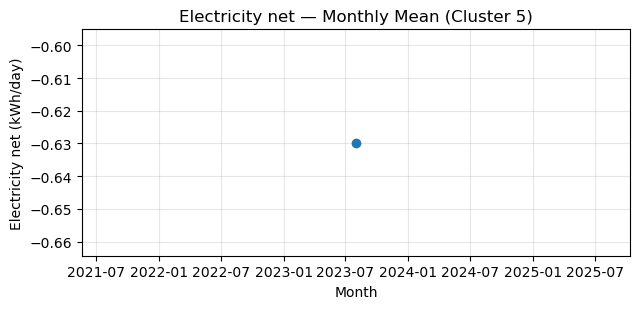

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Aug 2023

=== Cluster 6 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Feb 2021


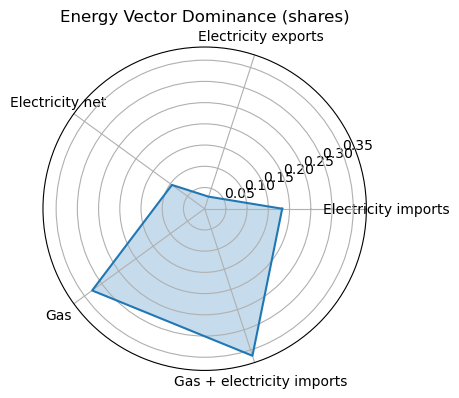

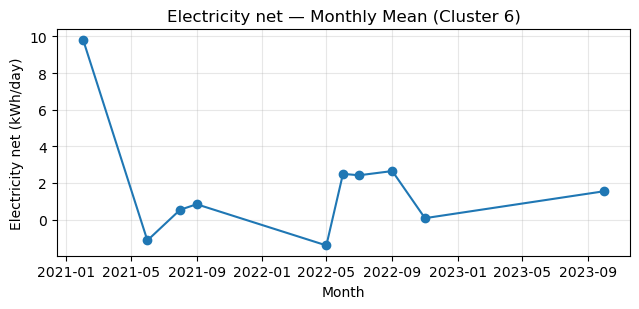

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2021

=== Cluster 7 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Mar 2022


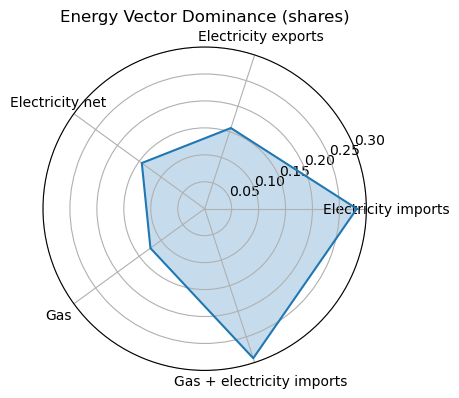

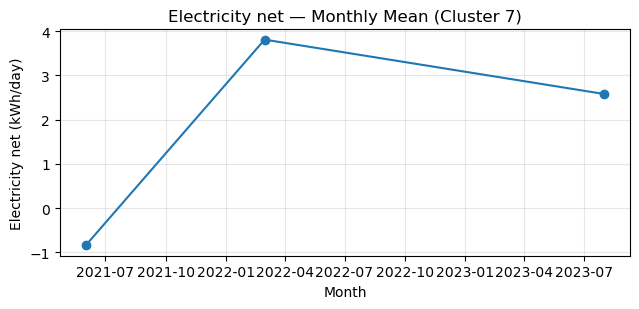

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2022

=== Cluster 8 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Jan 2022


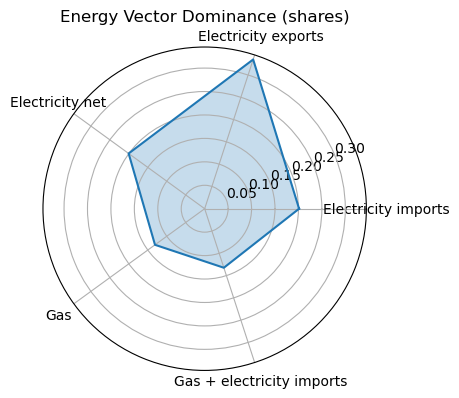

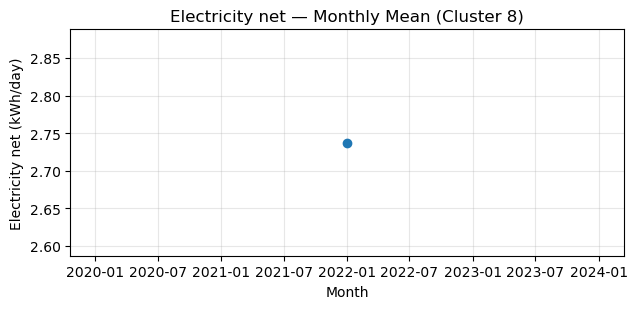

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2022

=== Cluster 9 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Jul 2022


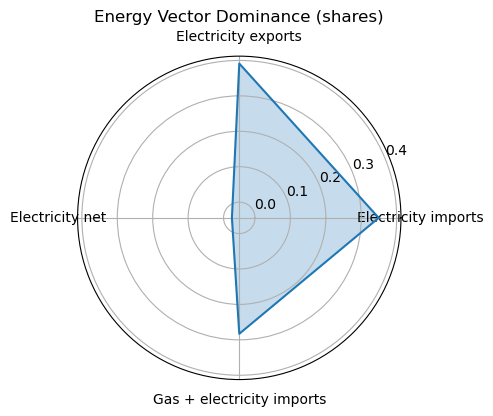

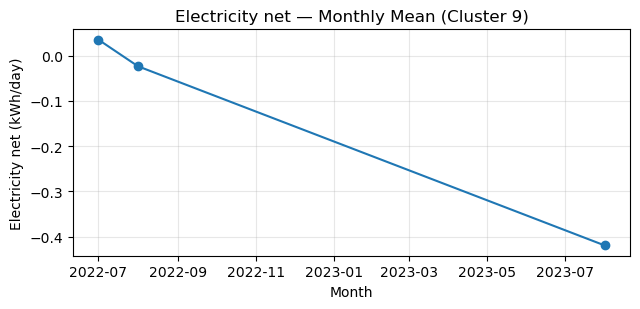

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2022

=== Cluster 10 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Sep 2021


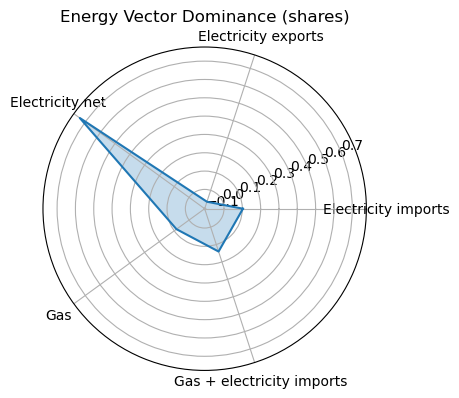

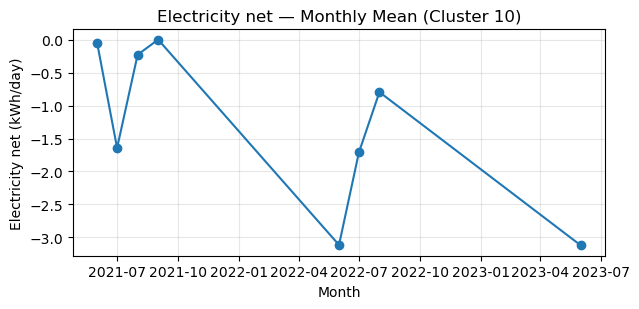

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Sep 2021

=== Cluster 11 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Aug 2021


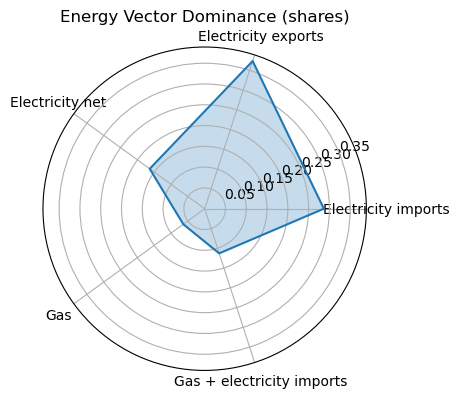

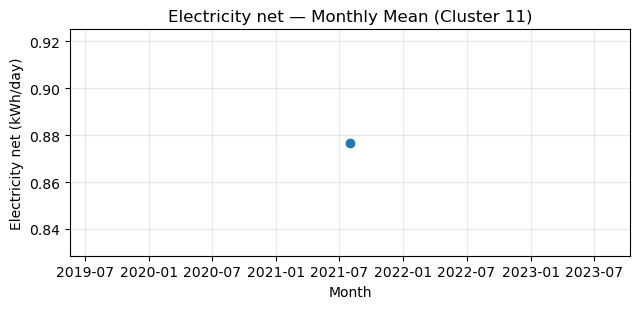

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Aug 2021

=== Cluster 12 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Dec 2022


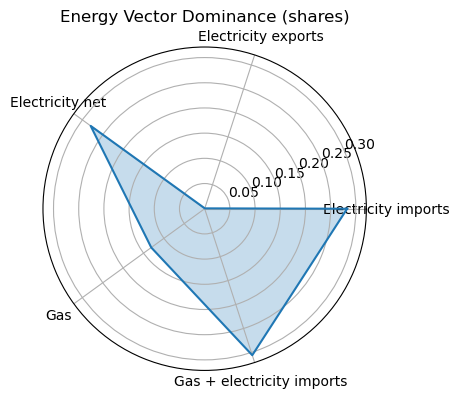

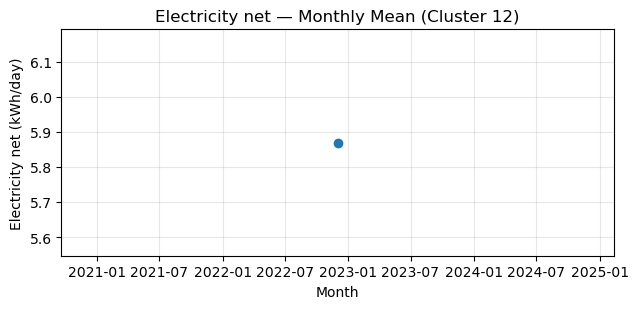

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2022

=== Cluster 13 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Feb 2022


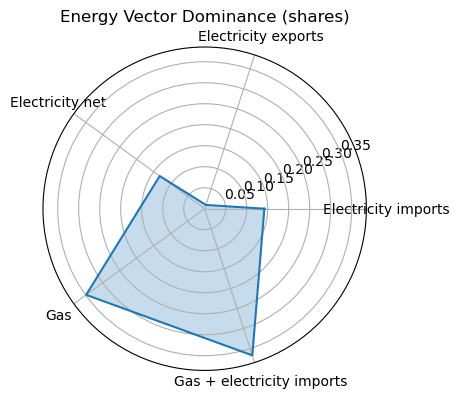

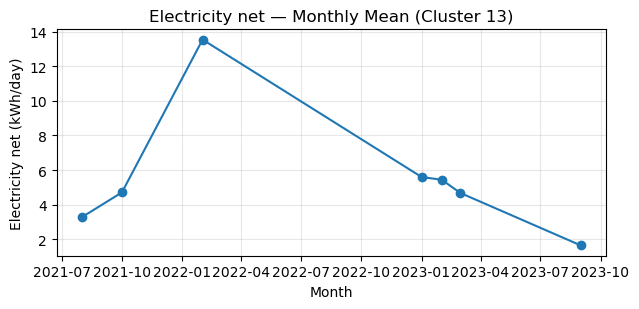

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2022

=== Cluster 14 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Apr 2021


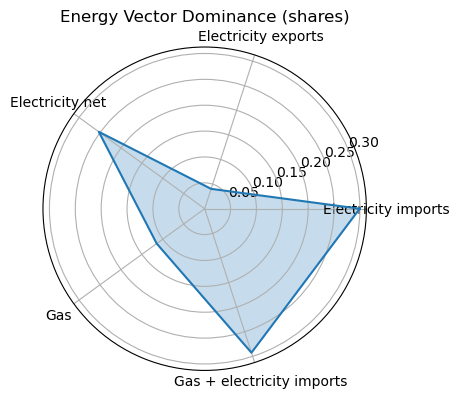

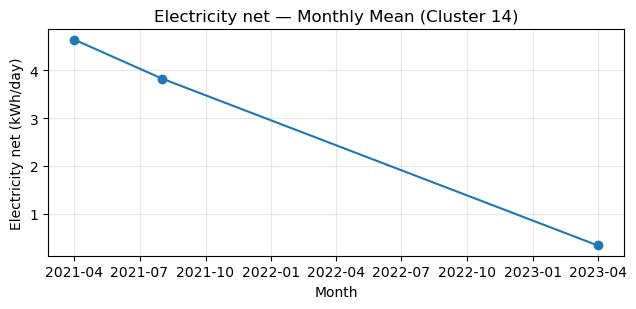

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2021

=== Cluster 15 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Apr 2022


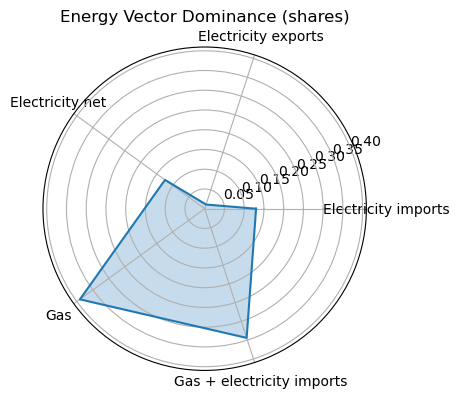

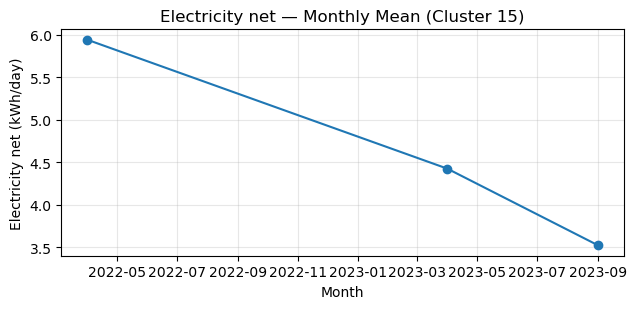

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2022

=== Cluster 16 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Sep 2023


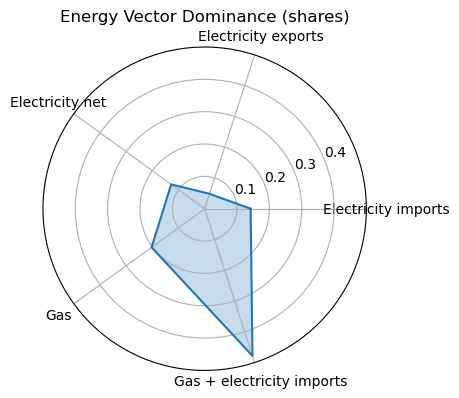

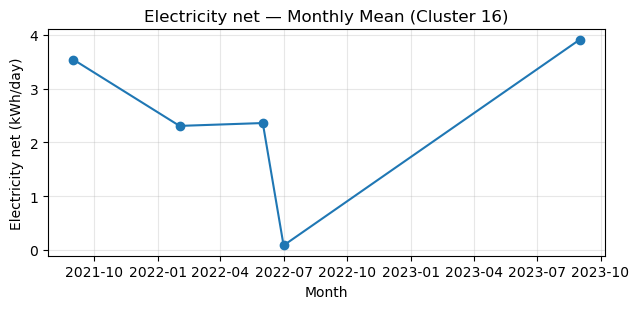

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Sep 2023

=== Cluster 17 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Mar 2022


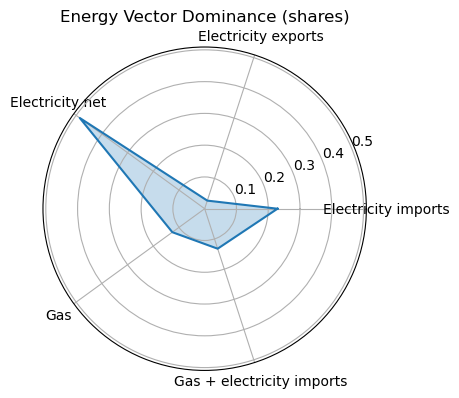

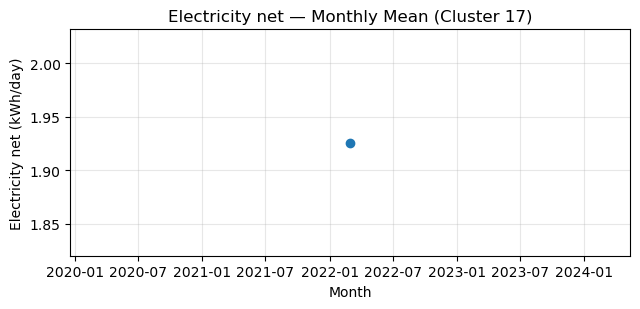

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2022

=== Cluster 18 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Jun 2021


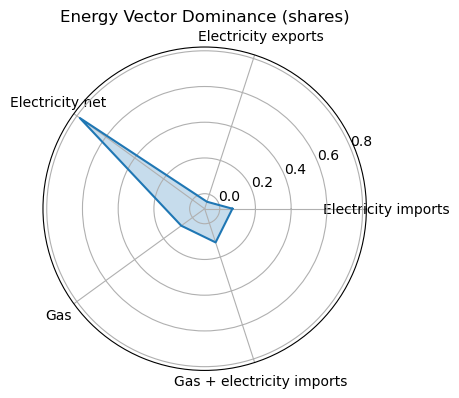

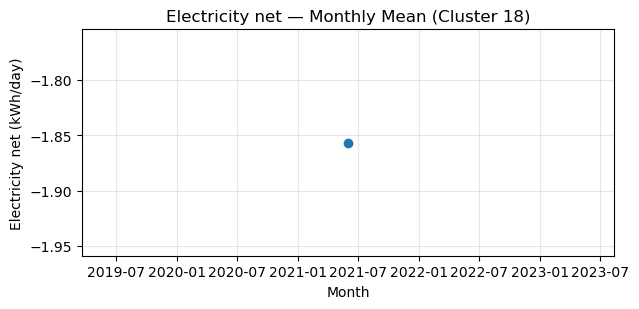

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jun 2021

=== Cluster 19 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Nov 2022


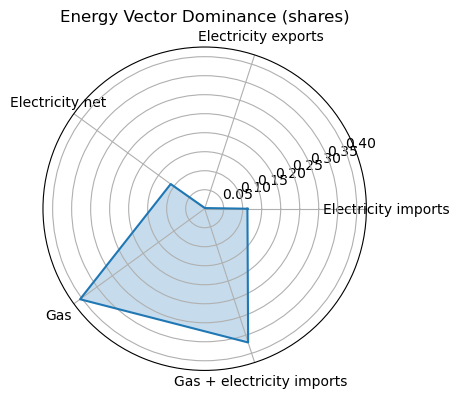

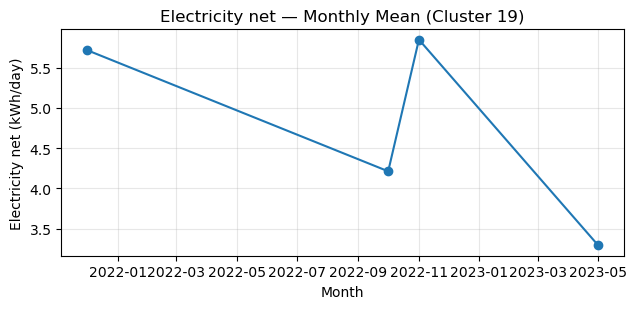

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2022

=== Cluster 20 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Nov 2022


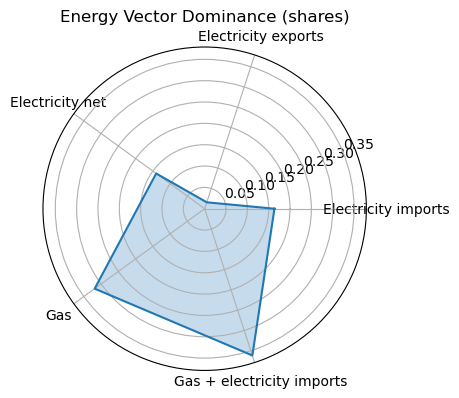

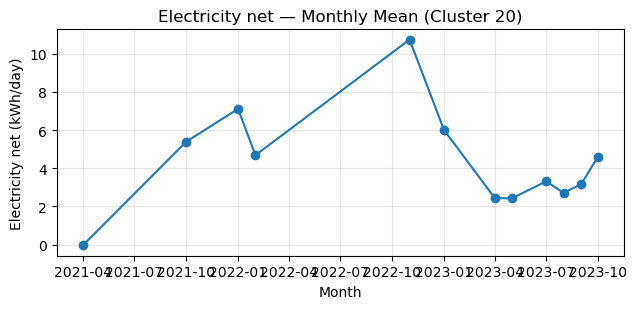

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2022

=== Cluster 21 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Apr 2021


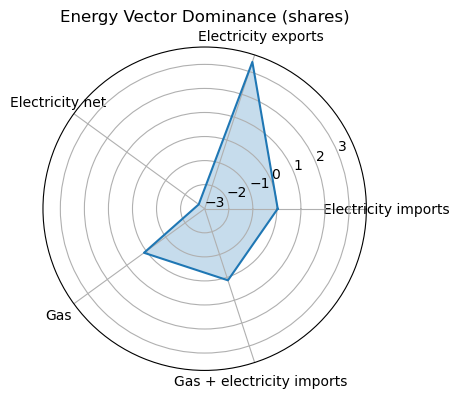

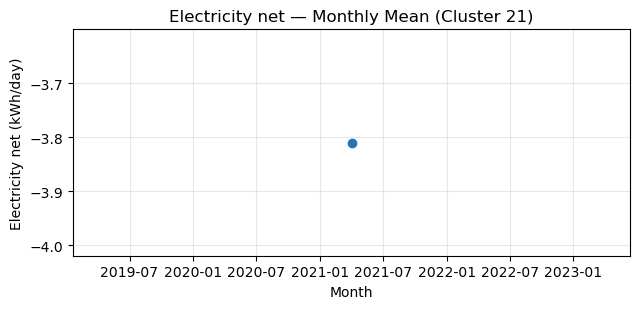

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2021

=== Cluster 22 ===
Persona Label: Mixed Imports, unknown seasonality, peak in May 2023


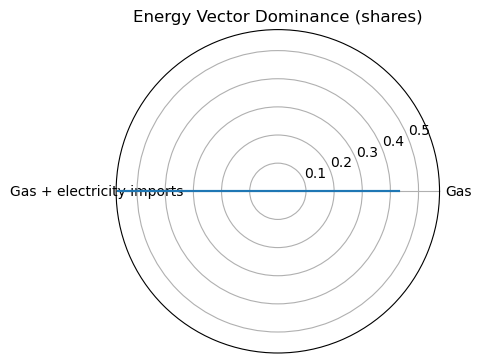

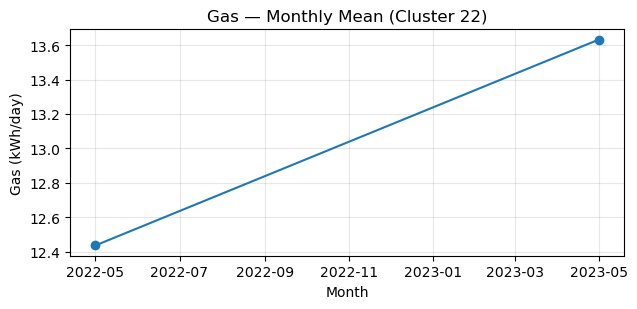

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: May 2023

=== Cluster 23 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Jan 2021


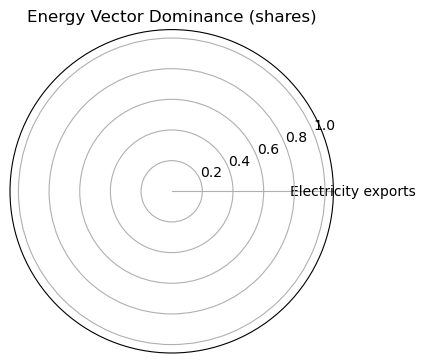

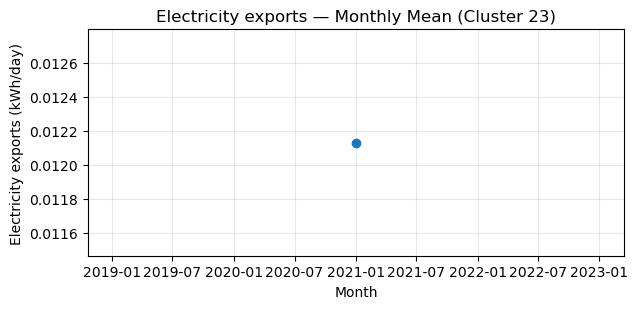

Target series: Electricity exports | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2021

=== Cluster 24 ===
Persona Label: Mixed Imports, unknown seasonality, peak in May 2021


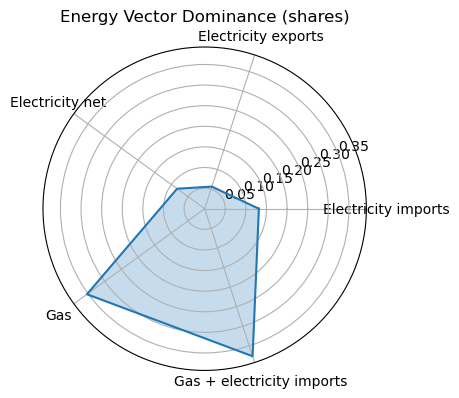

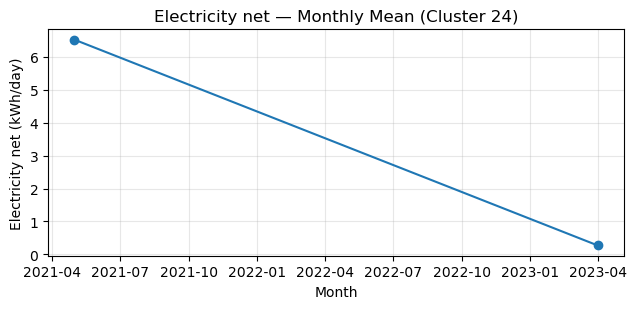

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2021

=== Cluster 25 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Nov 2021


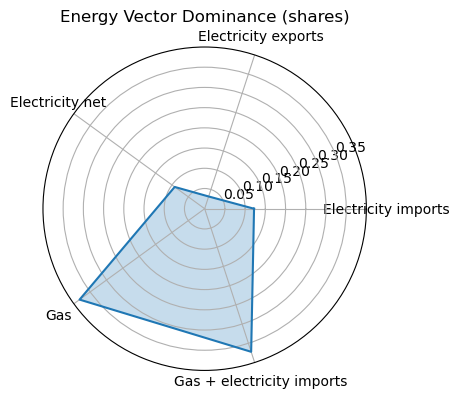

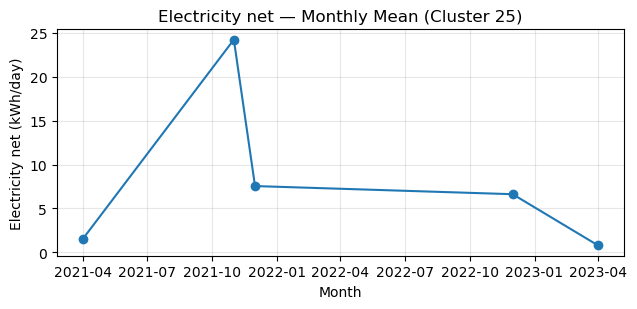

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2021

=== Cluster 26 ===
Persona Label: Mixed Imports, unknown seasonality, peak in May 2023


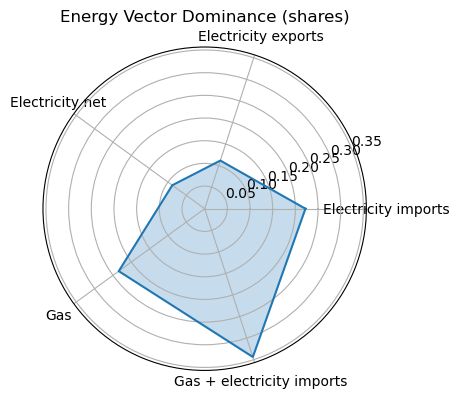

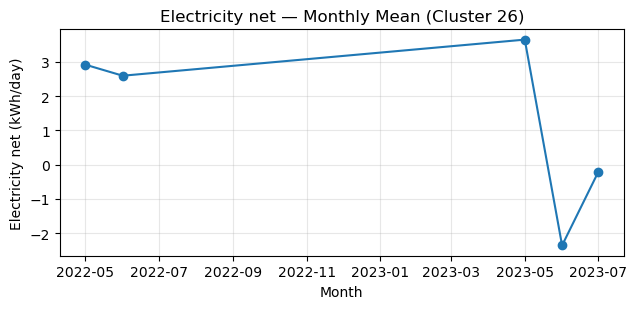

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2023

=== Cluster 27 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Feb 2023


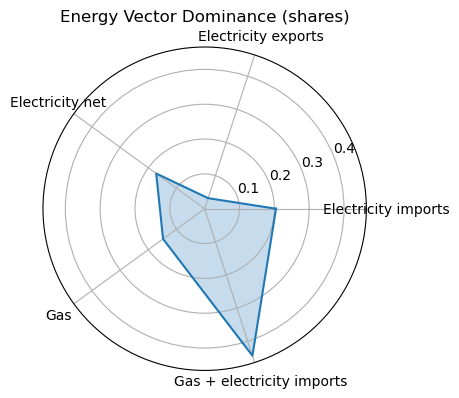

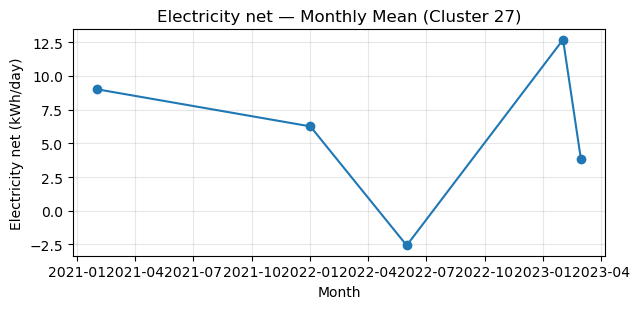

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2023

=== Cluster 28 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Dec 2023


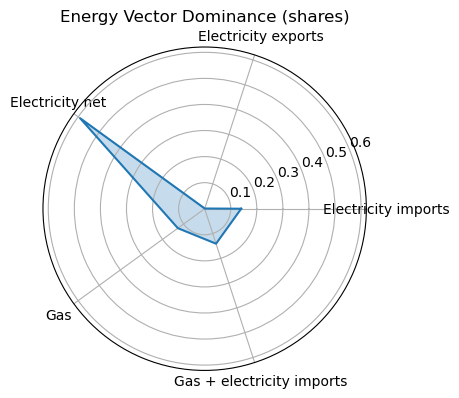

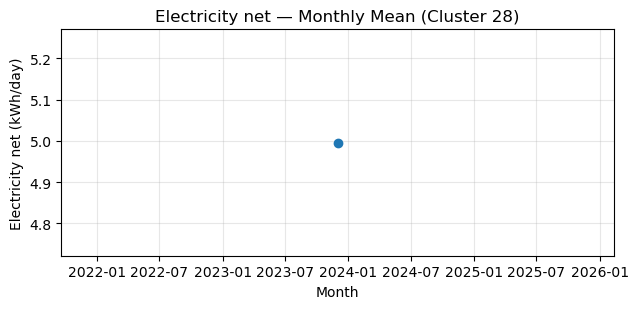

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2023

=== Cluster 29 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jan 2022


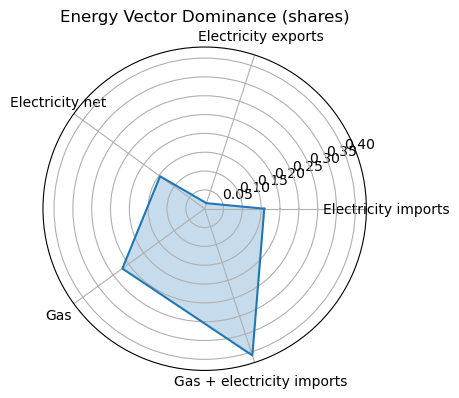

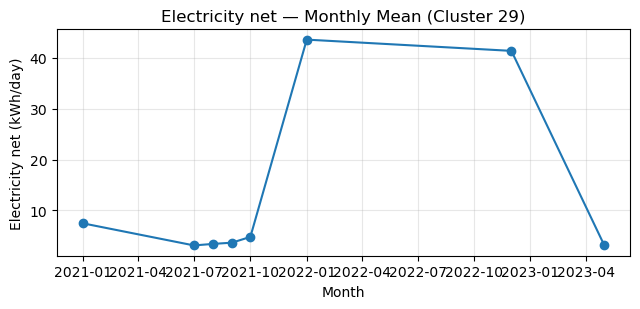

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2022

=== Cluster 30 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Oct 2023


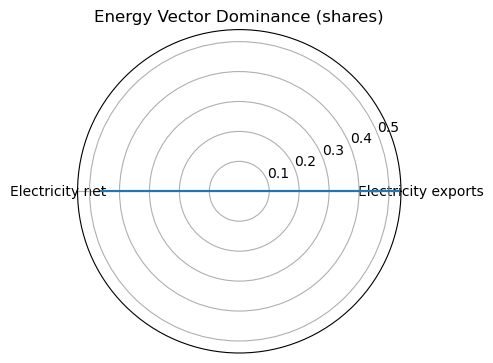

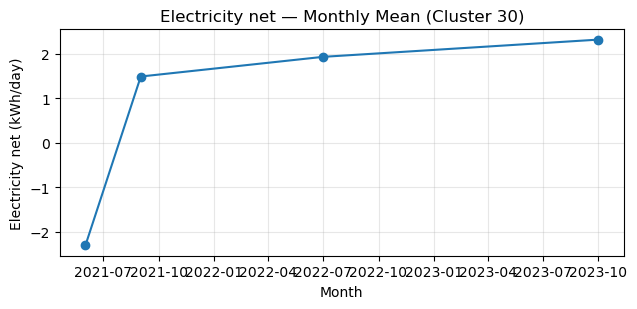

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2023

=== Cluster 31 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Mar 2023


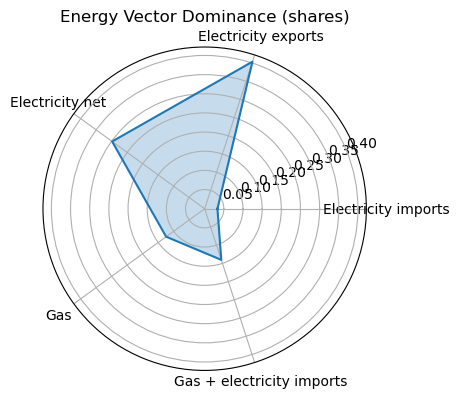

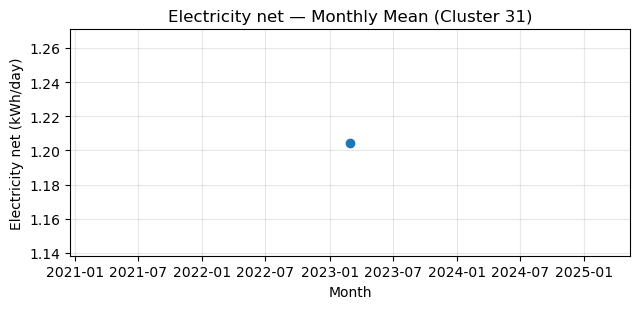

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2023

=== Cluster 32 ===
Persona Label: Mixed Imports, unknown seasonality, peak in May 2023


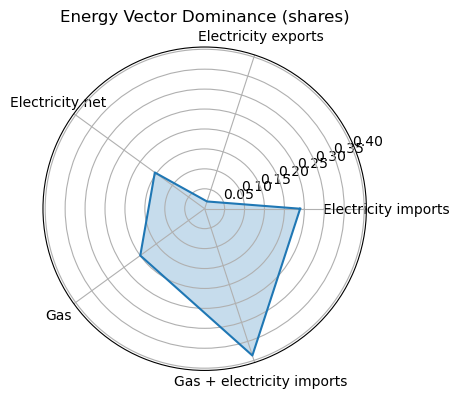

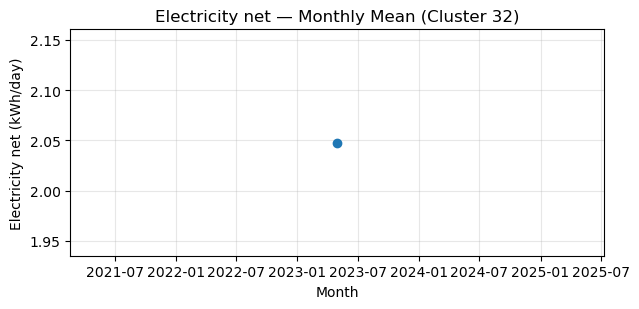

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2023

=== Cluster 33 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Sep 2023


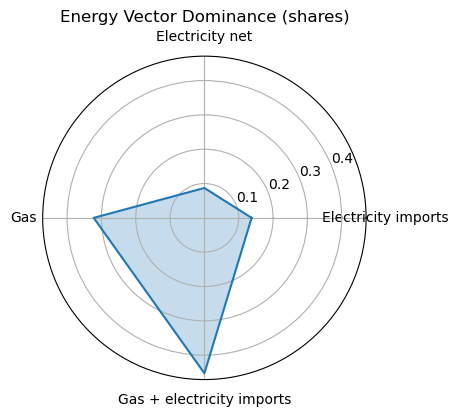

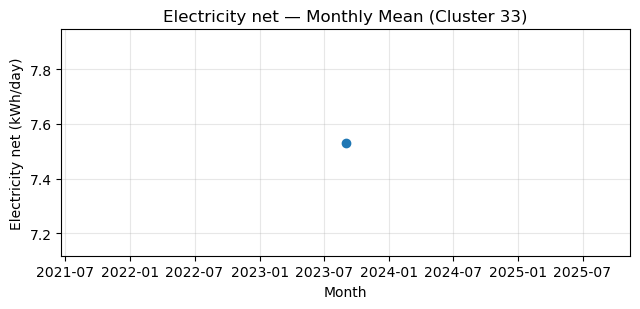

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Sep 2023

=== Cluster 34 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jun 2022


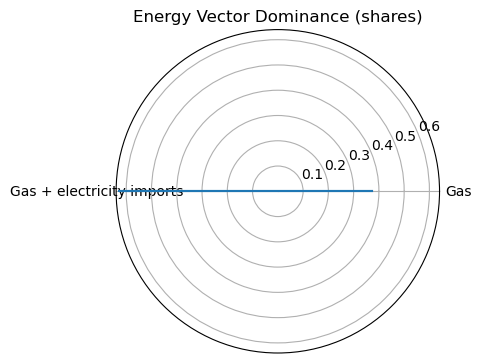

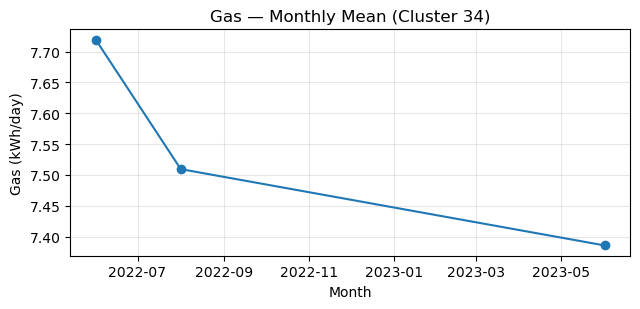

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: Jun 2022

=== Cluster 35 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jan 2021


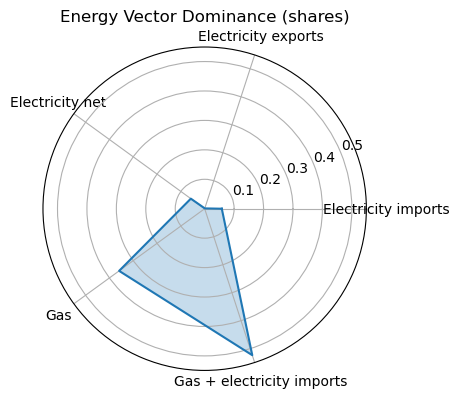

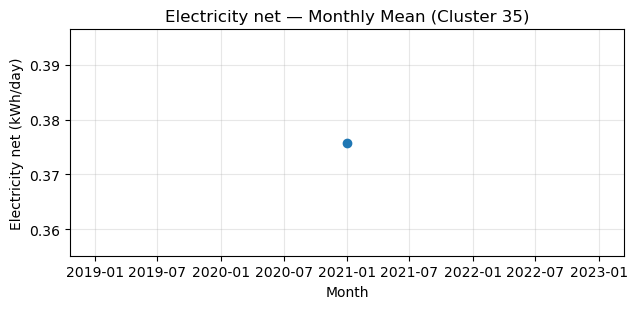

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2021

=== Cluster 36 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Jun 2023


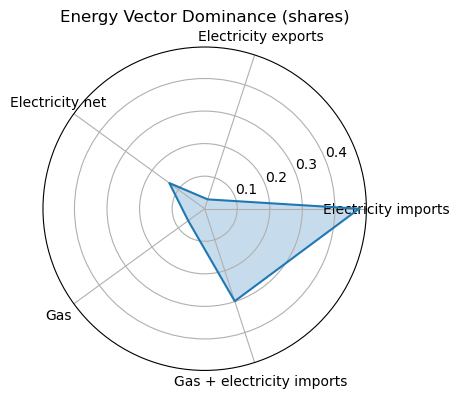

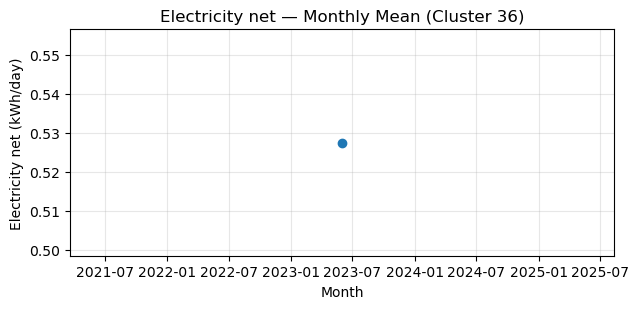

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jun 2023

=== Cluster 37 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Apr 2021


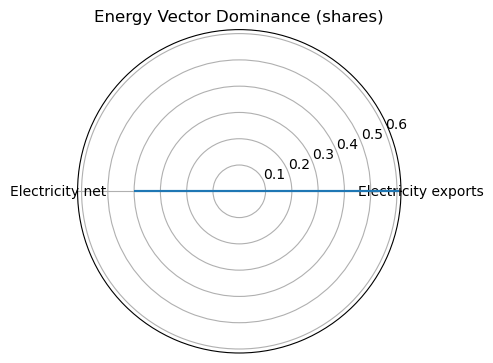

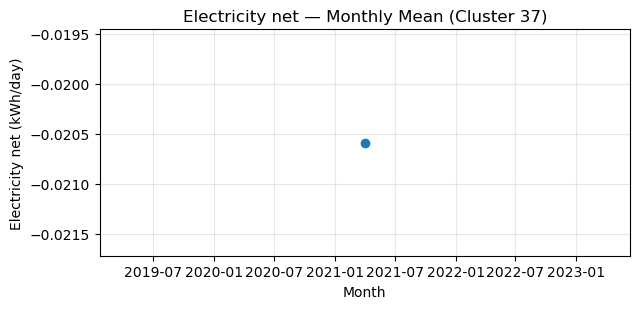

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2021

=== Cluster 38 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Jul 2021


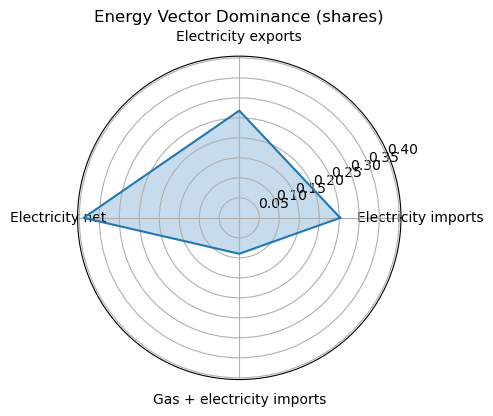

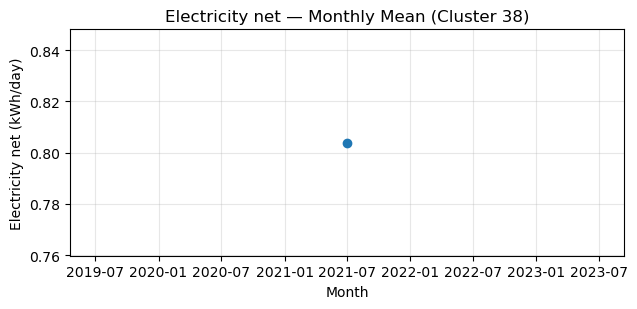

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2021

=== Cluster 39 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Jan 2021


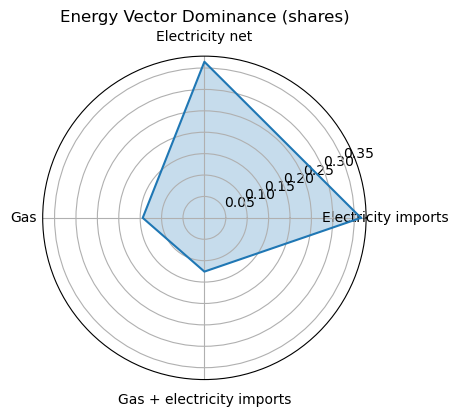

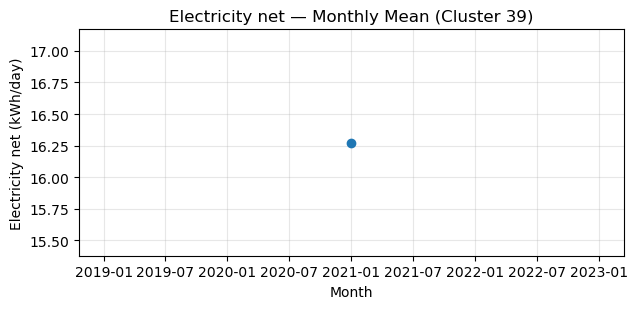

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2021

=== Cluster 40 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Apr 2021


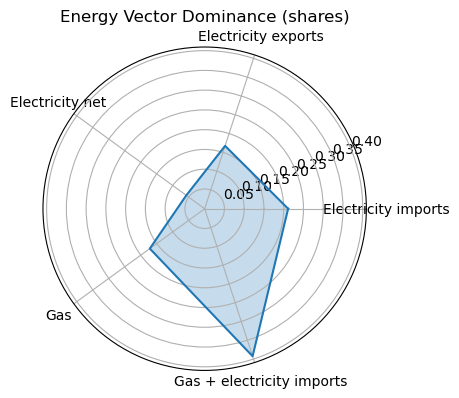

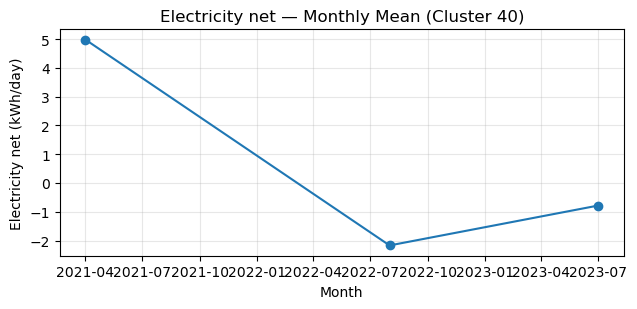

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2021

=== Cluster 41 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Jul 2021


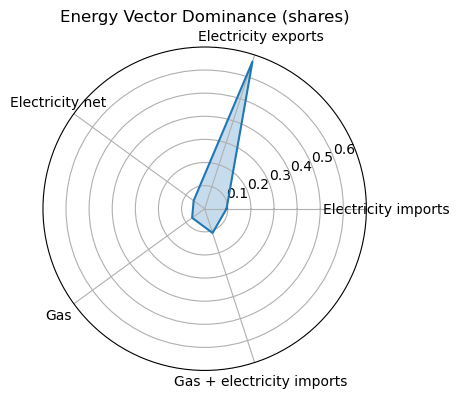

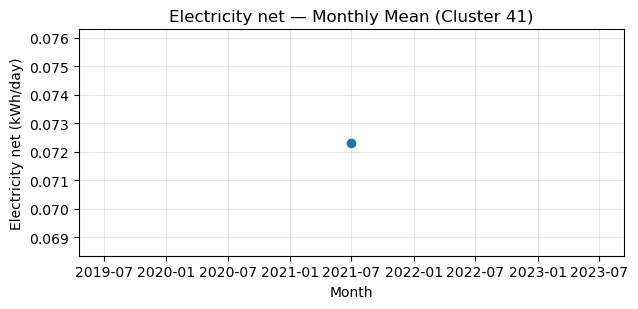

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2021

=== Cluster 42 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Jul 2021


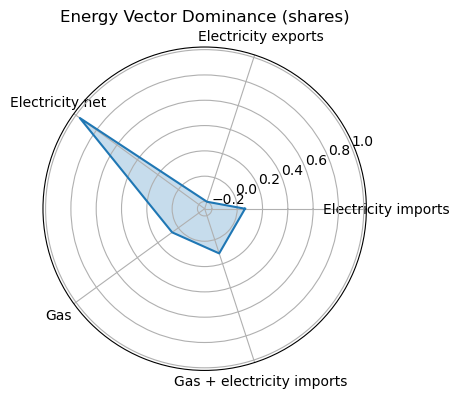

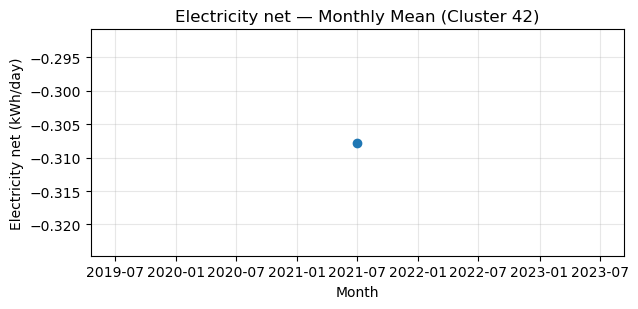

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2021

=== Cluster 43 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jun 2022


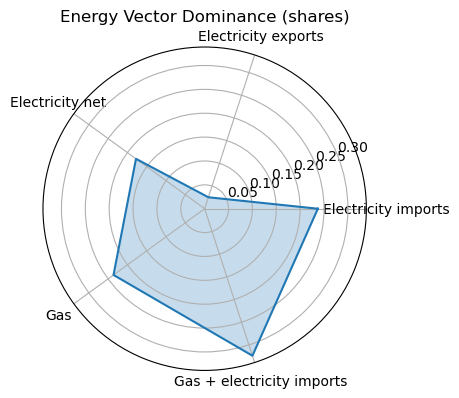

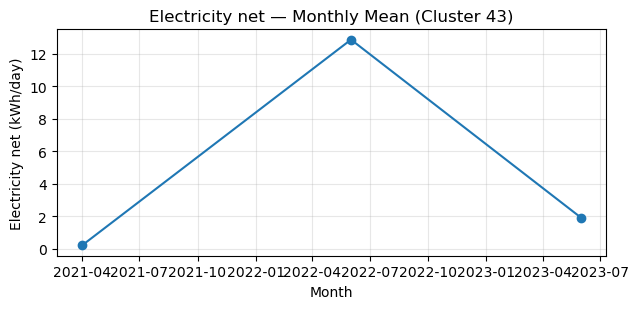

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jun 2022

=== Cluster 44 ===
Persona Label: Mixed Imports, unknown seasonality, peak in May 2023


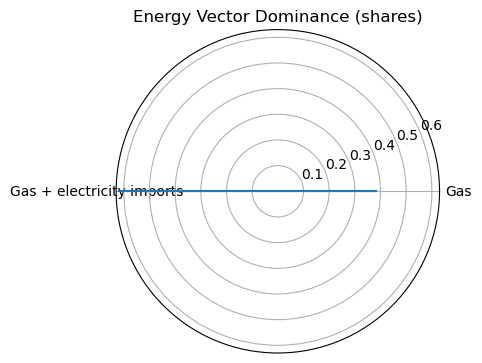

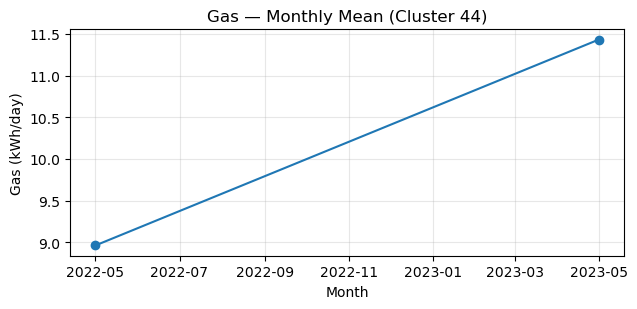

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: May 2023

=== Cluster 45 ===
Persona Label: Mixed Imports, unknown seasonality, peak in May 2023


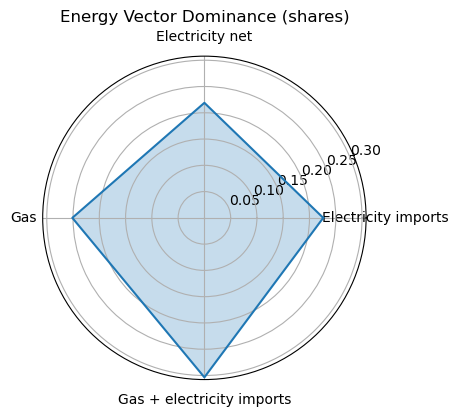

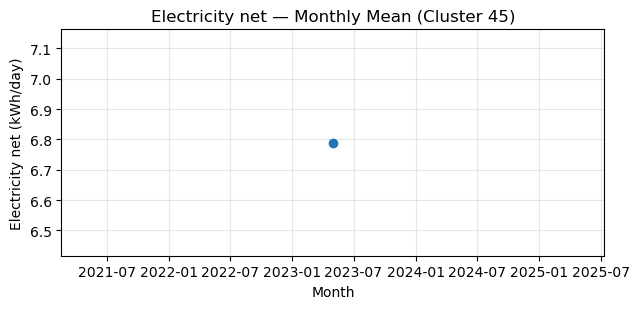

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2023

=== Cluster 46 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Apr 2023


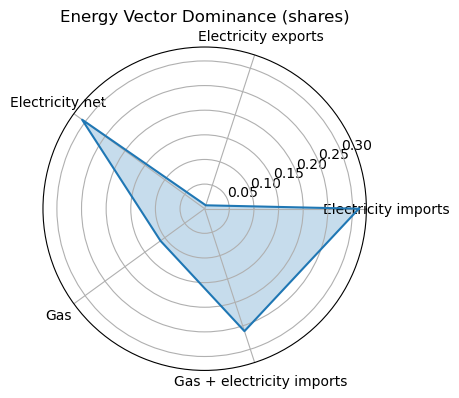

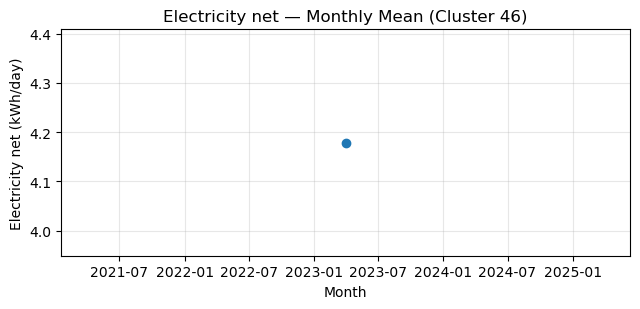

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2023

=== Cluster 47 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Dec 2023


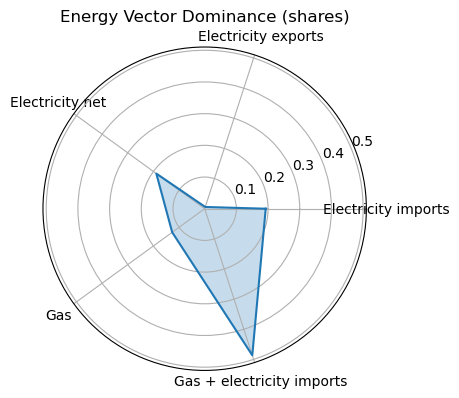

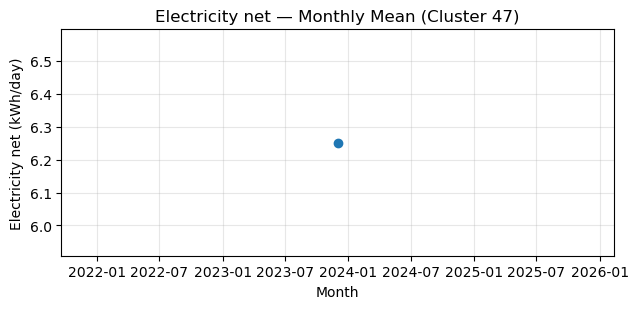

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2023

=== Cluster 48 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Nov 2022


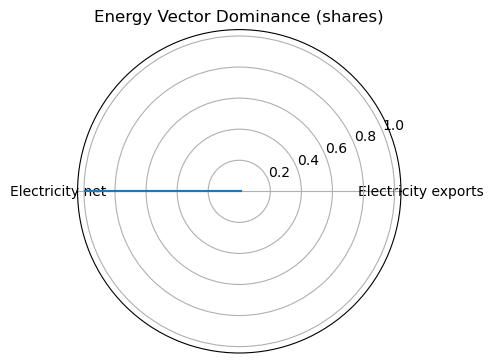

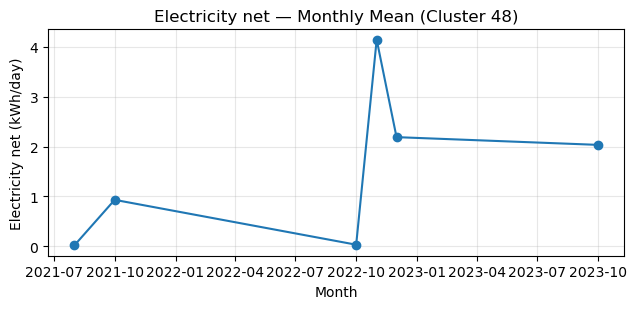

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2022

=== Cluster 49 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jan 2023


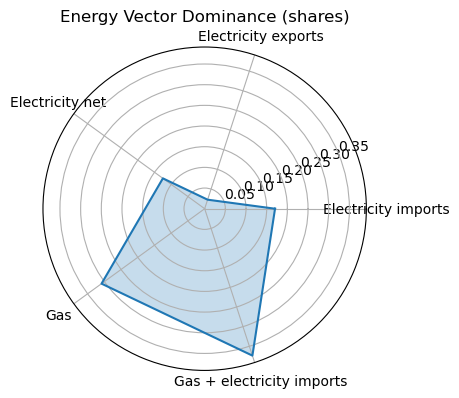

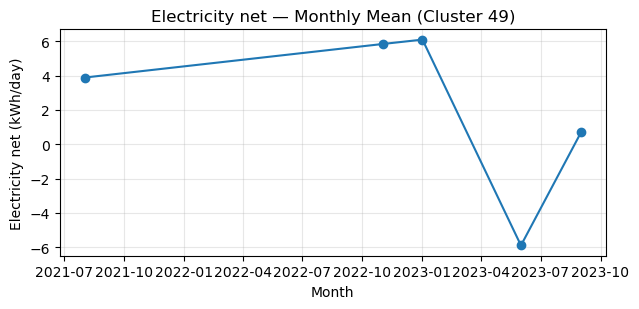

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2023

=== Cluster 50 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Dec 2022


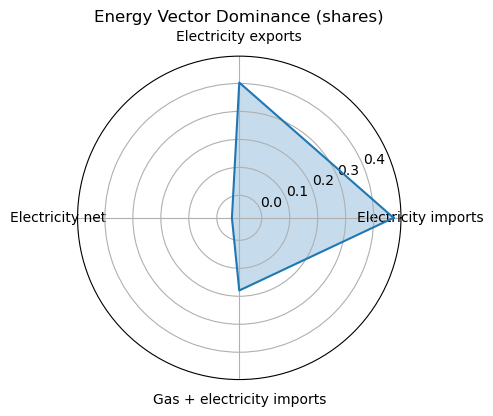

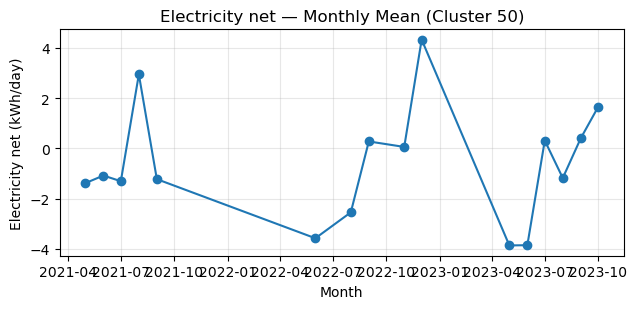

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2022

=== Cluster 51 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jan 2022


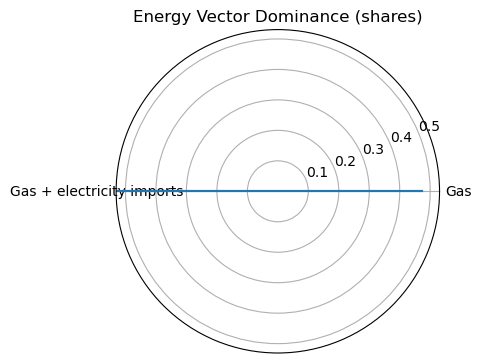

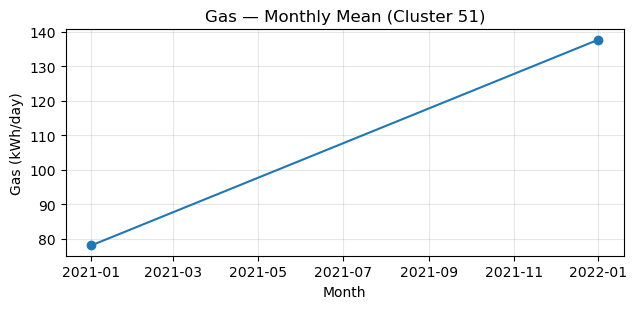

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2022

=== Cluster 52 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Oct 2021


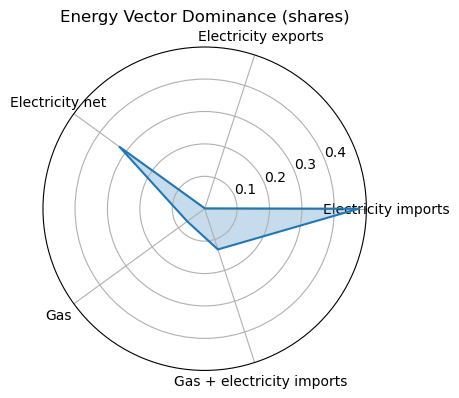

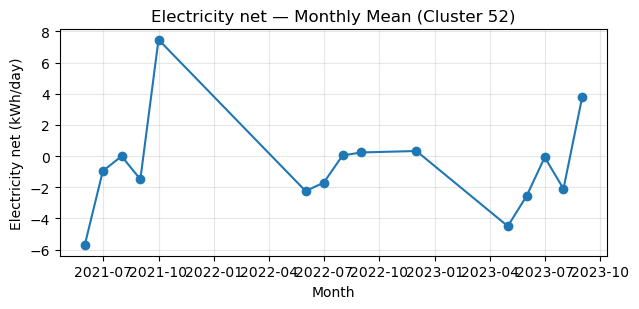

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2021

=== Cluster 53 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jul 2022


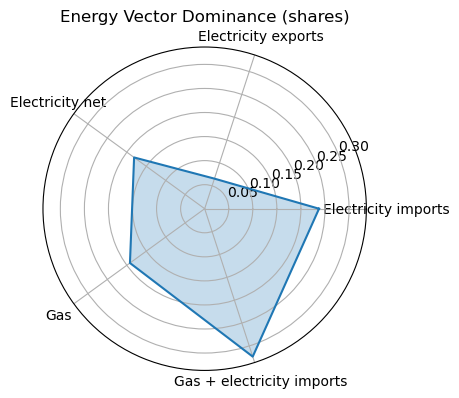

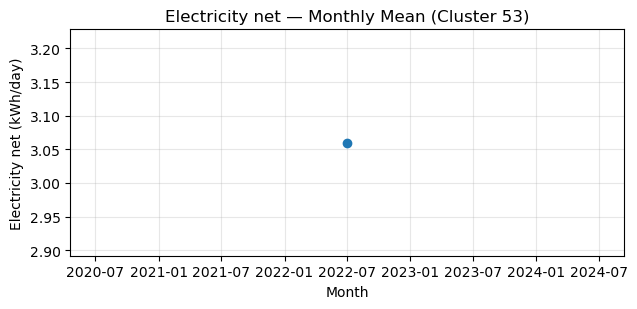

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2022

=== Cluster 54 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Jan 2021


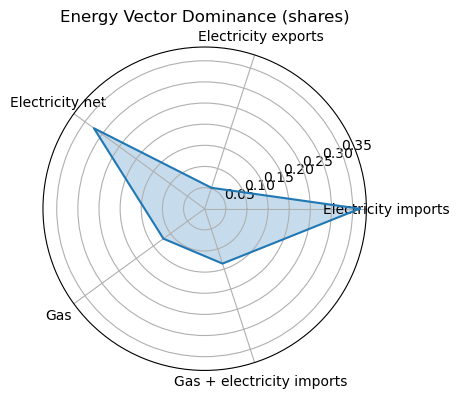

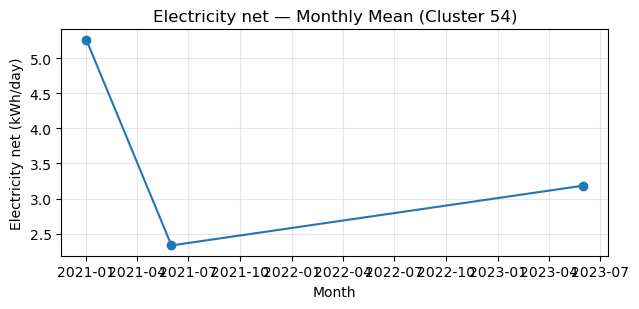

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2021

=== Cluster 55 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Feb 2023


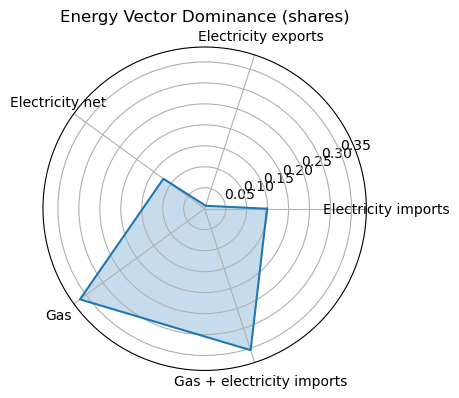

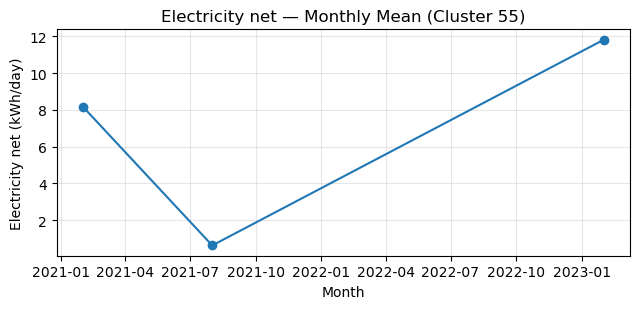

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2023

=== Cluster 56 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jul 2023


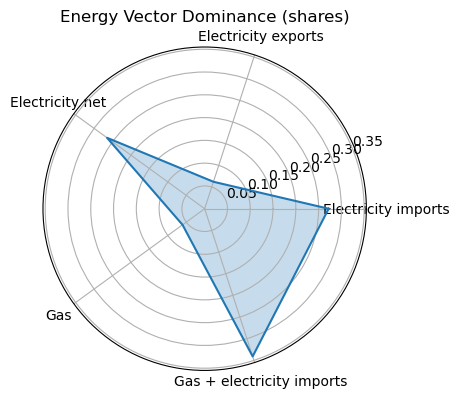

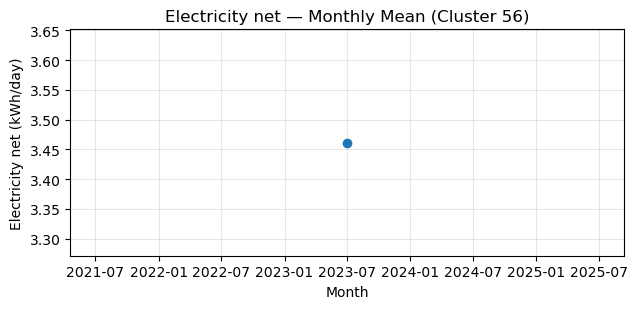

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2023

=== Cluster 57 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jul 2023


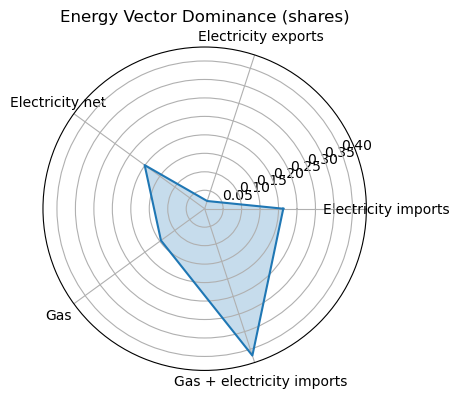

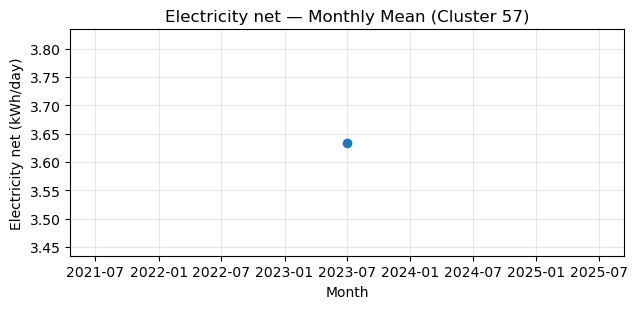

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2023

=== Cluster 58 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jan 2021


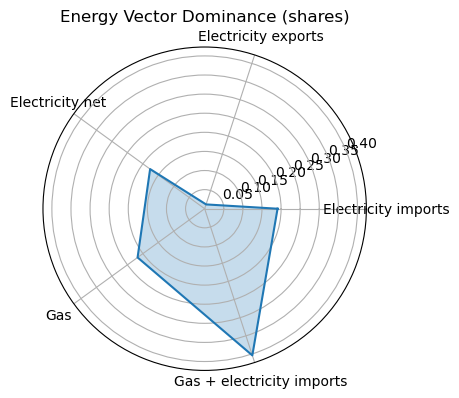

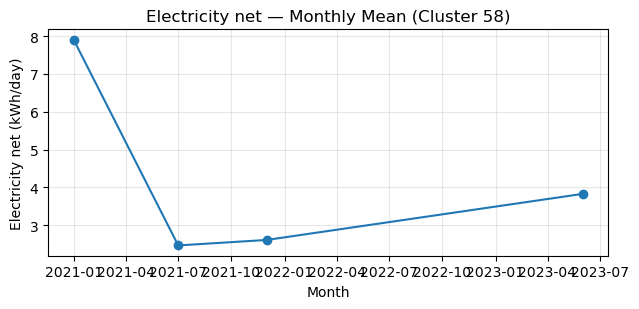

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2021

=== Cluster 59 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jan 2022


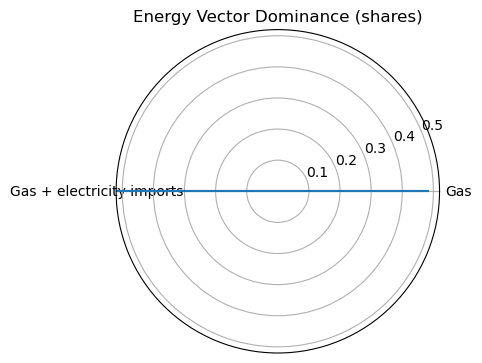

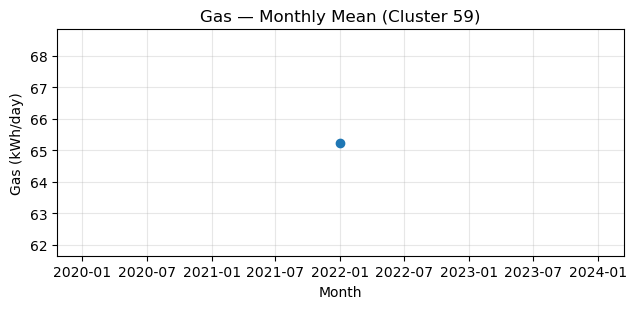

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2022

=== Cluster 60 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Jan 2022


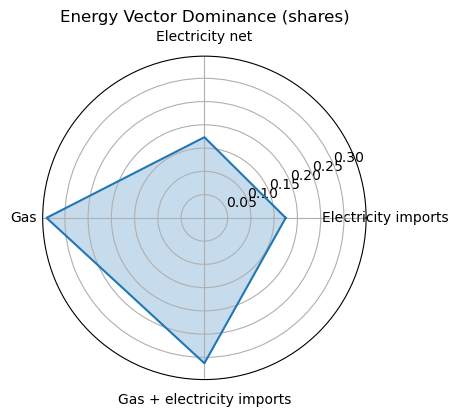

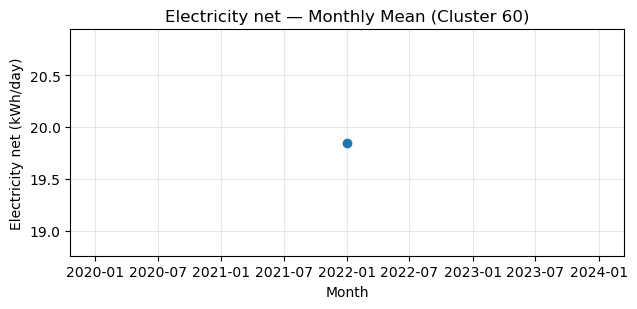

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2022

=== Cluster 61 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jan 2021


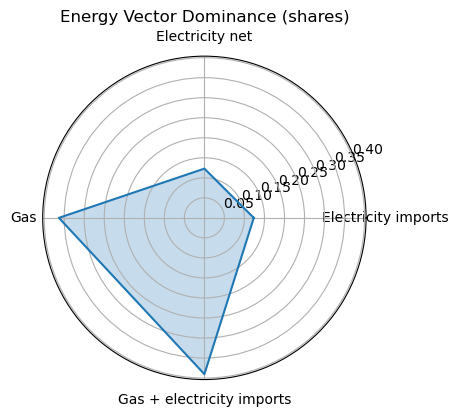

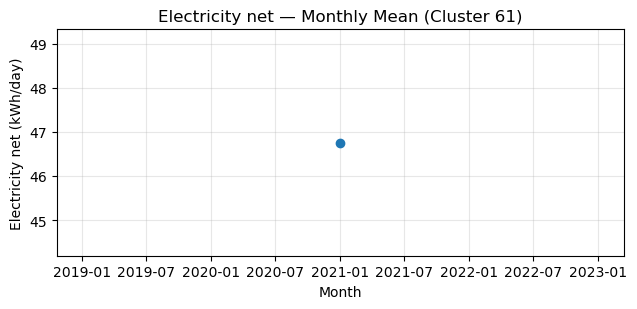

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2021

=== Cluster 62 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Jan 2021


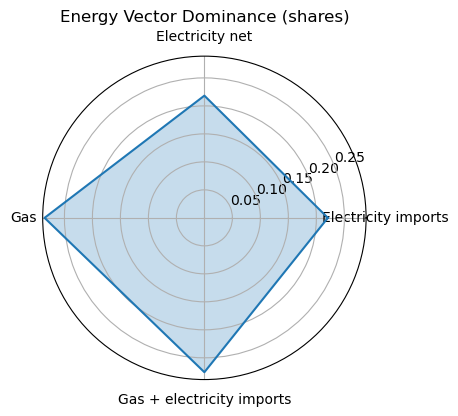

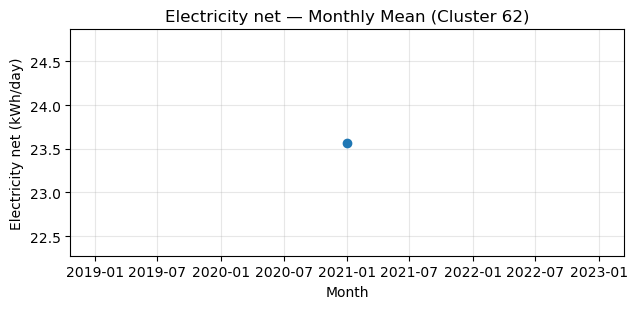

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2021

=== Cluster 63 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Apr 2023


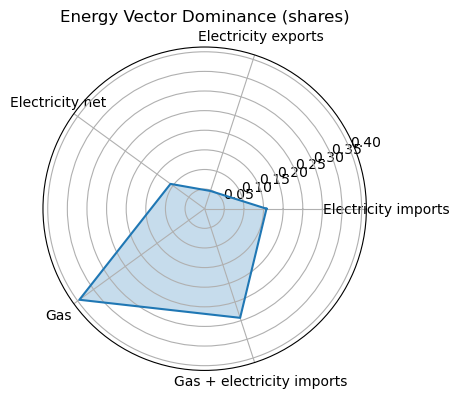

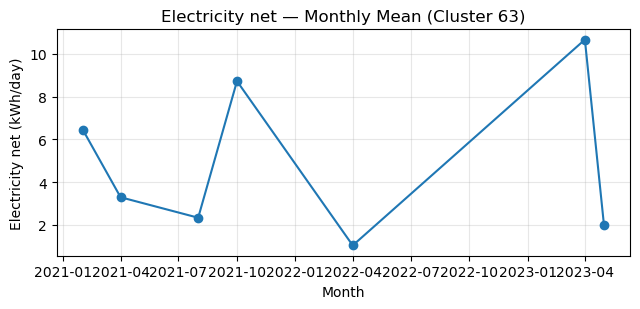

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2023

=== Cluster 64 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Jul 2023


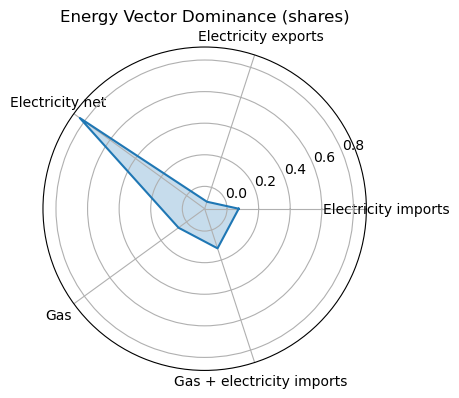

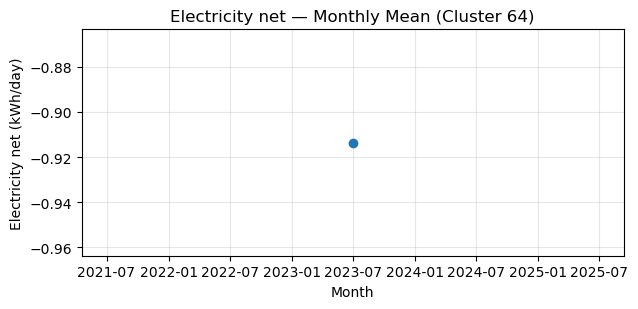

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2023

=== Cluster 65 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Apr 2023


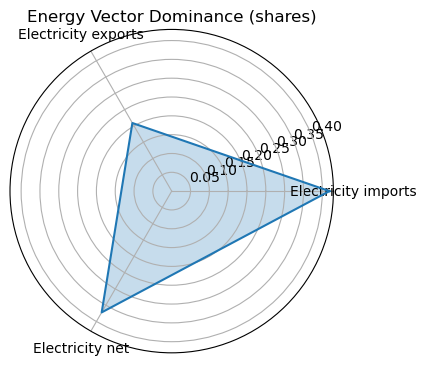

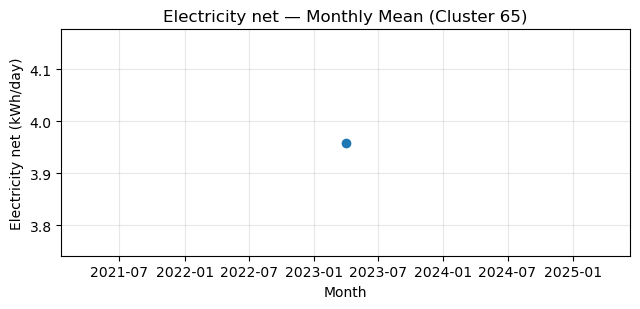

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2023

=== Cluster 66 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Jan 2021


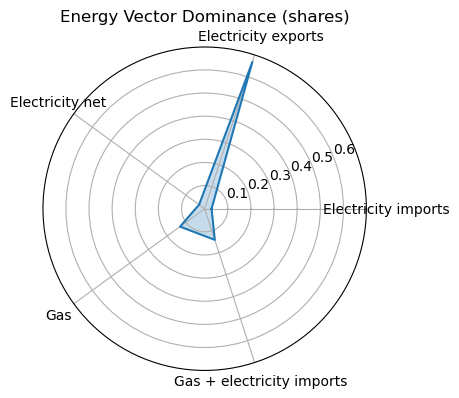

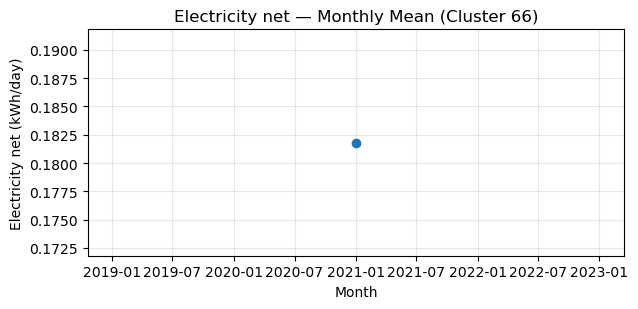

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2021

=== Cluster 67 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Jan 2021


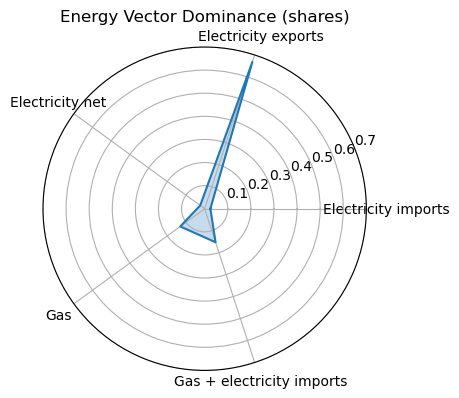

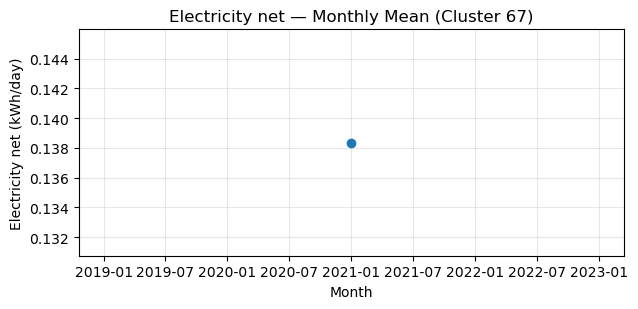

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2021

=== Cluster 68 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Mar 2021


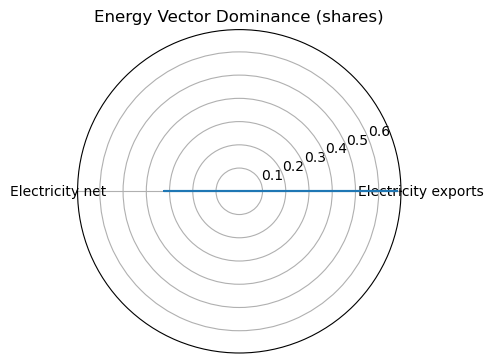

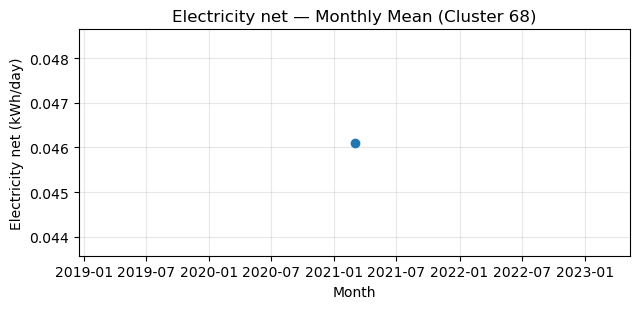

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2021

=== Cluster 69 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Mar 2021


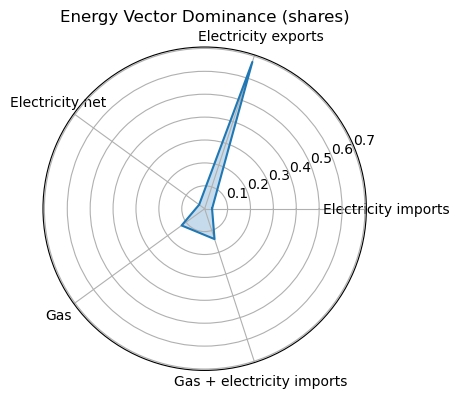

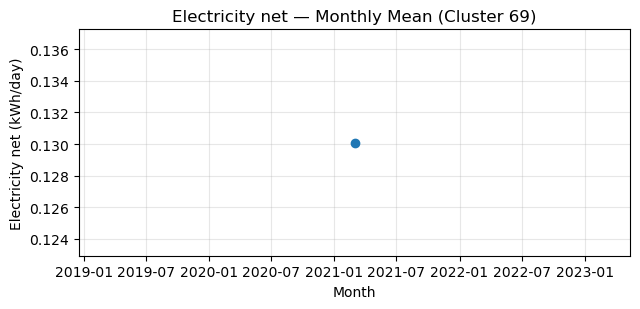

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2021

=== Cluster 70 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Oct 2023


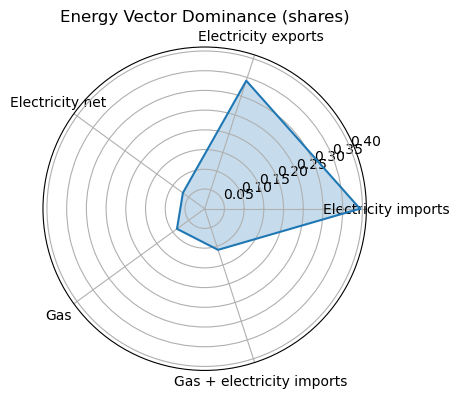

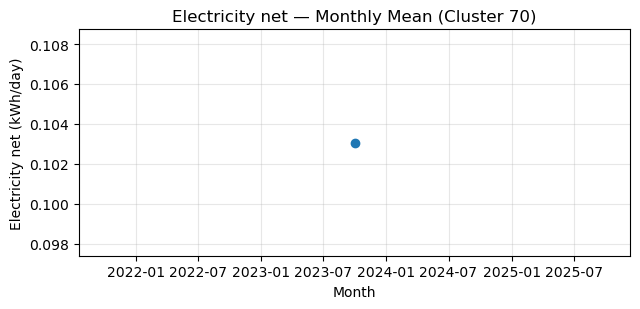

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2023

=== Cluster 71 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Oct 2023


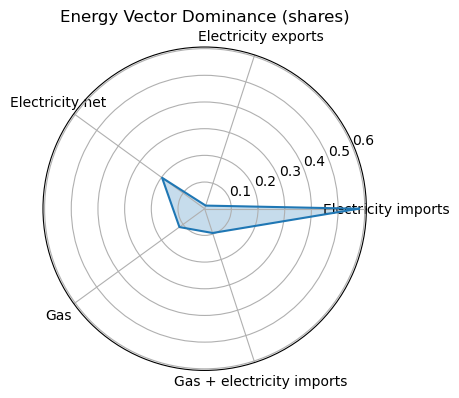

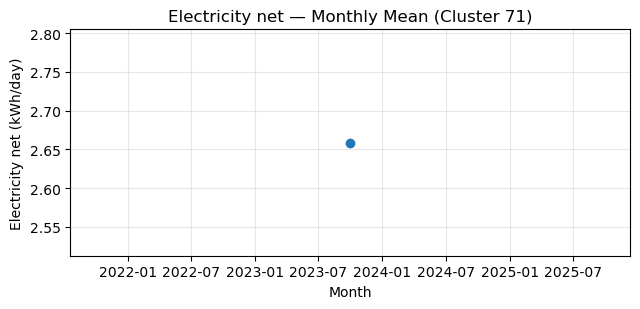

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2023

=== Cluster 72 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in May 2023


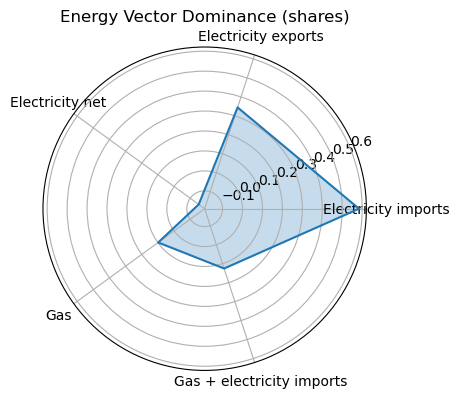

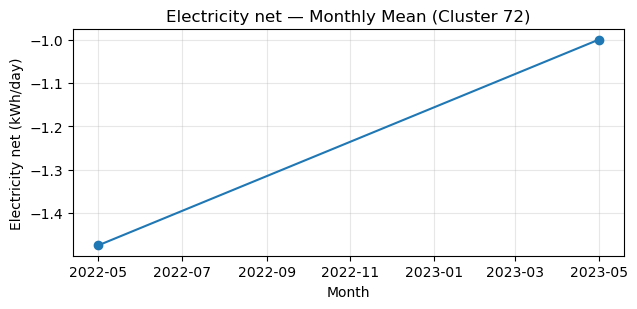

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2023

=== Cluster 73 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Oct 2023


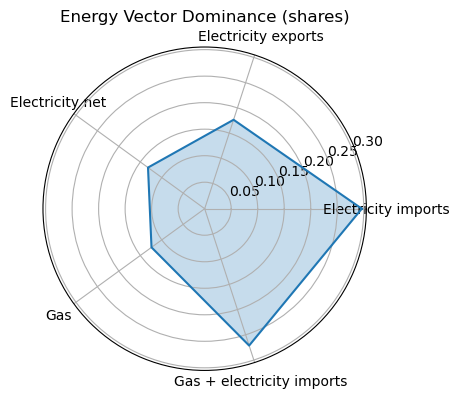

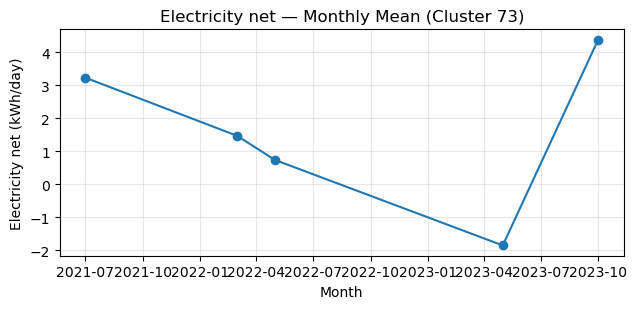

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2023

=== Cluster 74 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Apr 2023


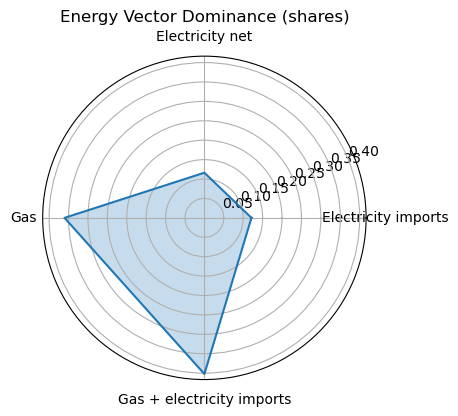

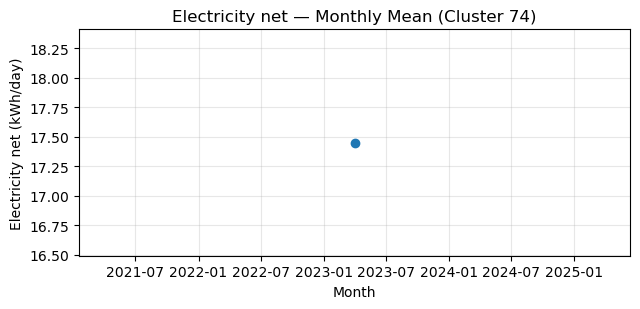

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2023

=== Cluster 75 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Apr 2023


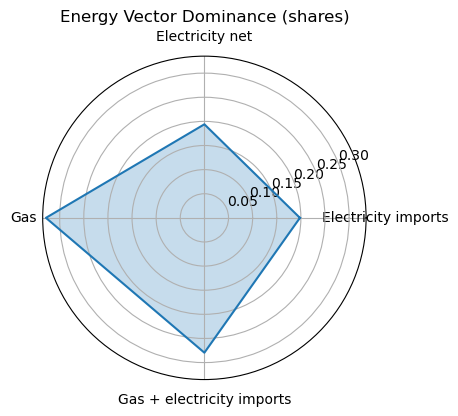

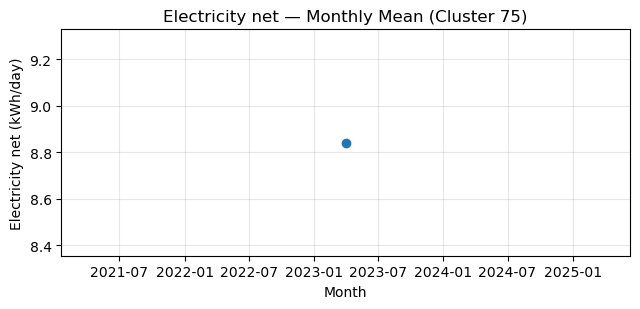

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2023

=== Cluster 76 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Feb 2023


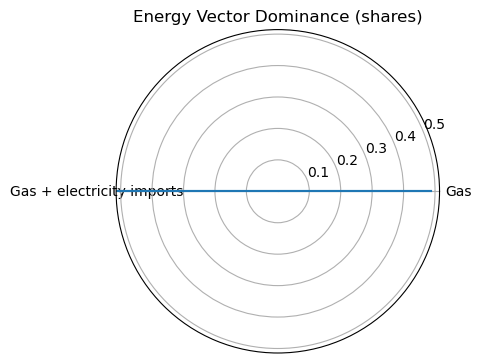

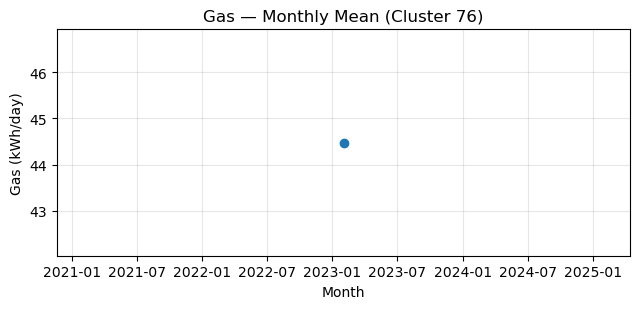

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2023

=== Cluster 77 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Oct 2022


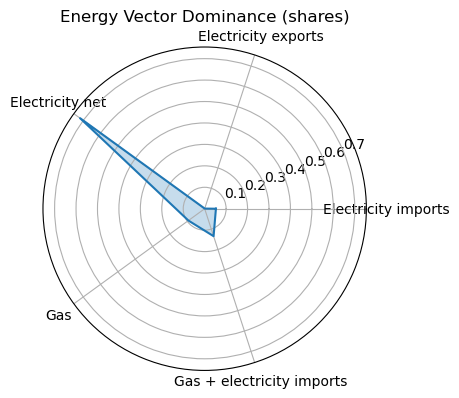

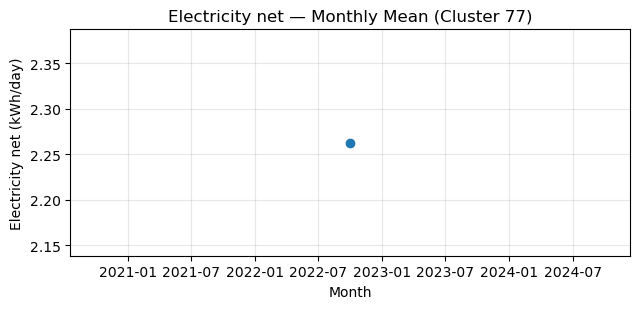

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2022

=== Cluster 78 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Oct 2022


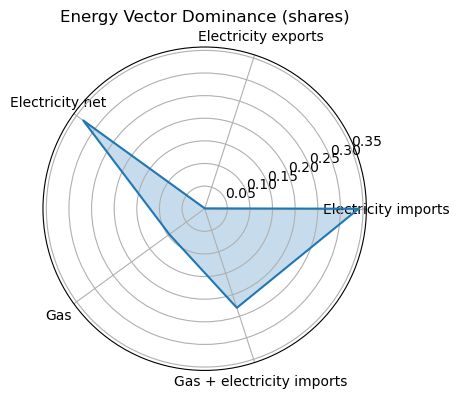

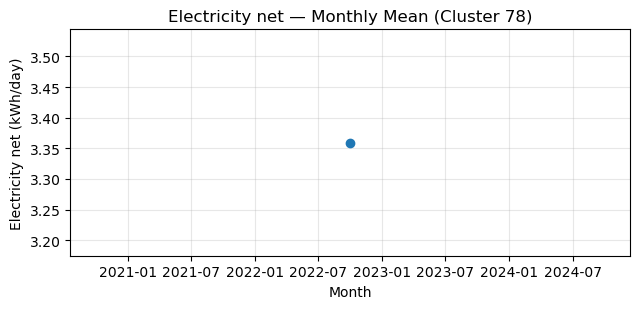

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2022

=== Cluster 79 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Dec 2023


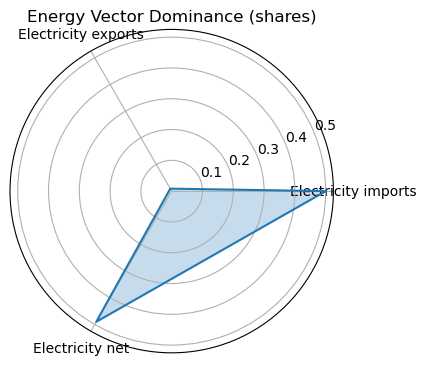

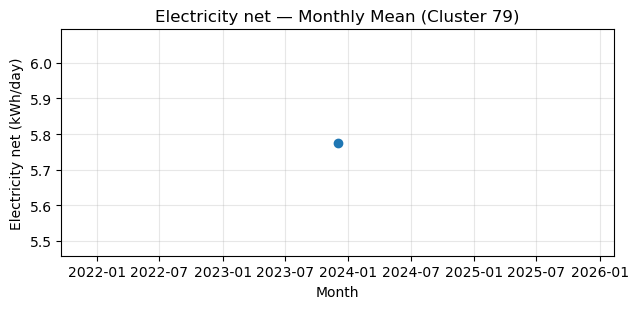

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2023

=== Cluster 80 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Mar 2021


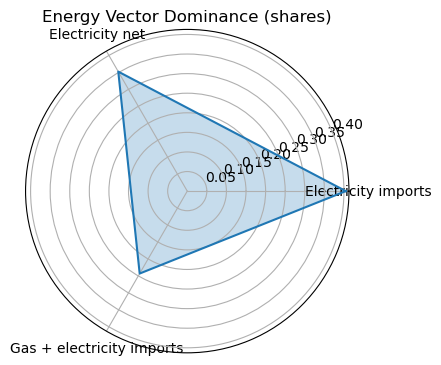

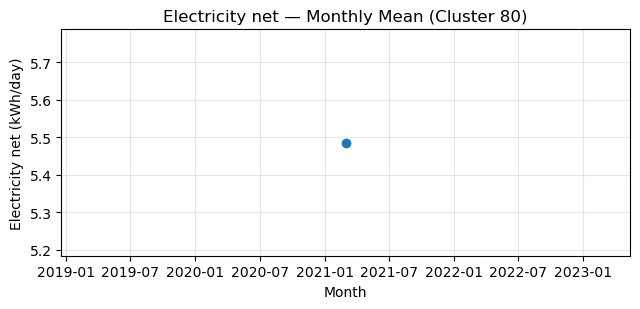

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2021

=== Cluster 81 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Mar 2021


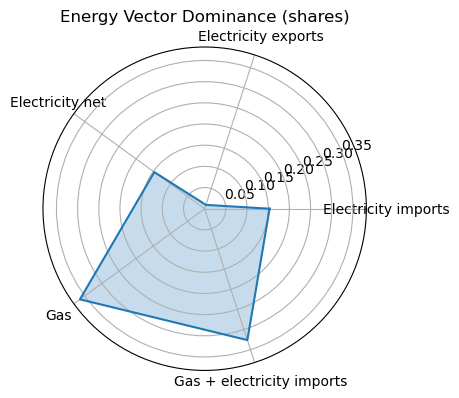

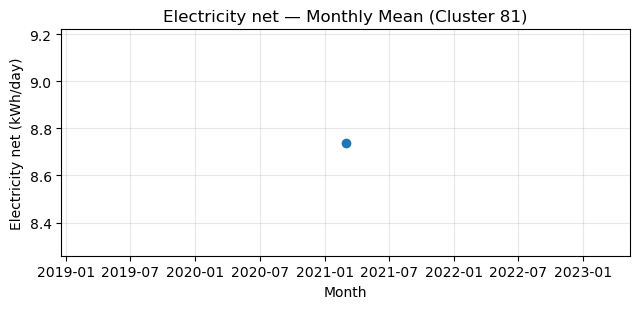

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2021

=== Cluster 82 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Jun 2022


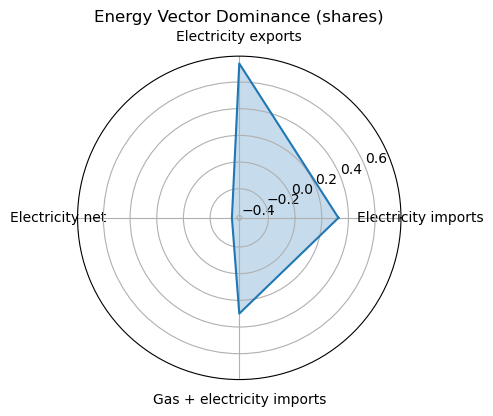

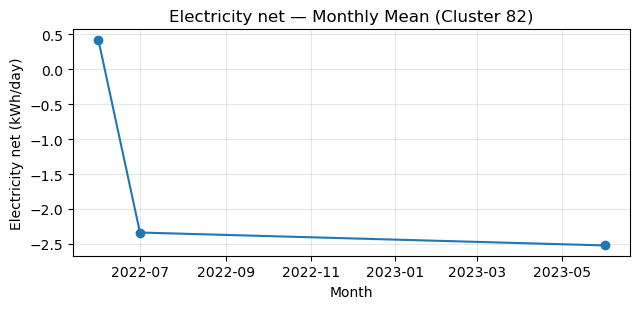

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jun 2022

=== Cluster 83 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jun 2023


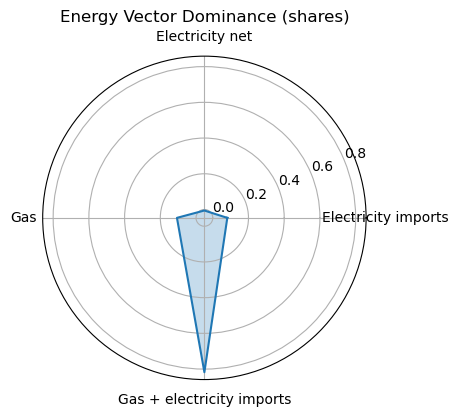

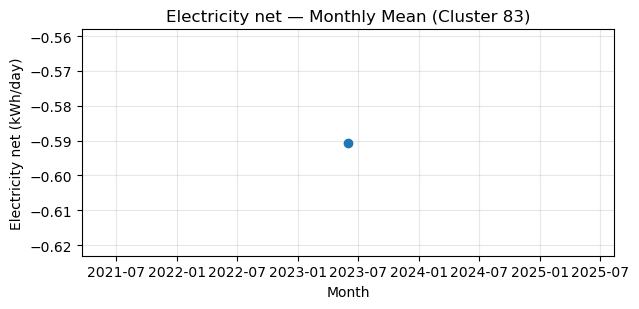

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jun 2023

=== Cluster 84 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Jul 2022


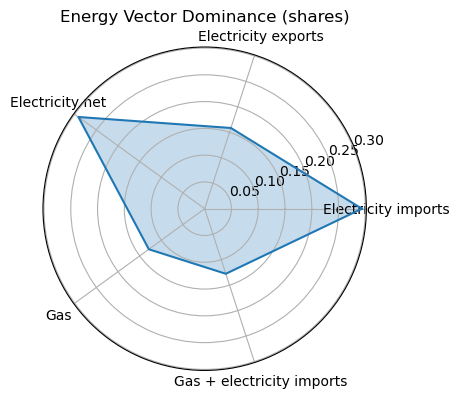

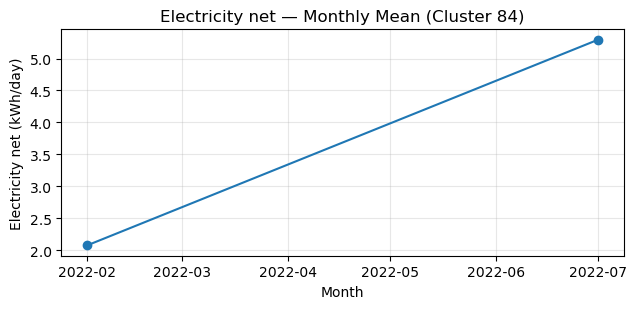

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2022

=== Cluster 85 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Mar 2023


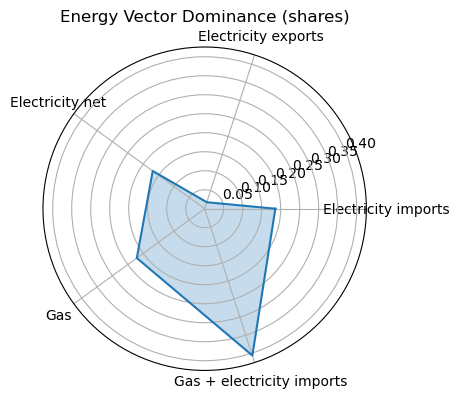

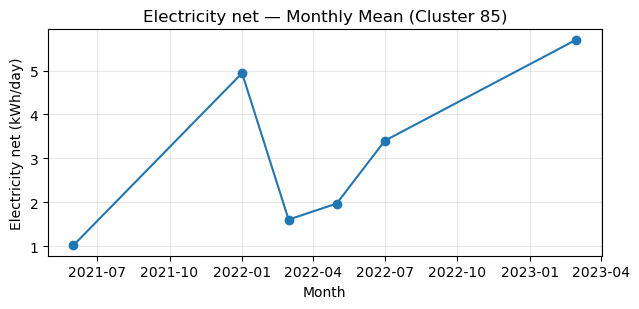

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2023

=== Cluster 86 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Nov 2023


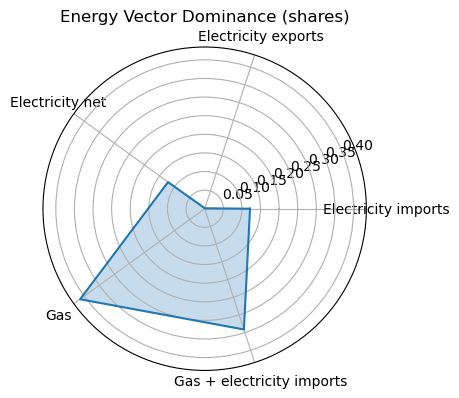

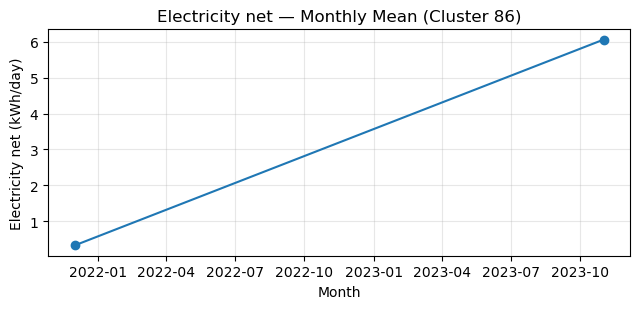

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2023

=== Cluster 87 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in May 2021


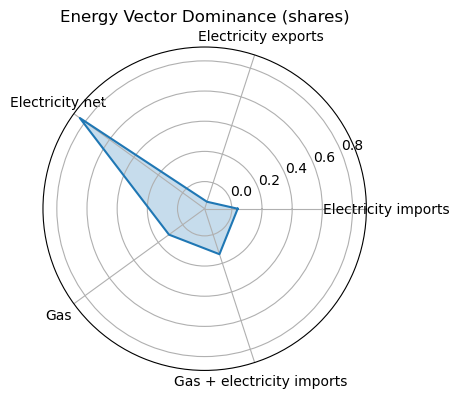

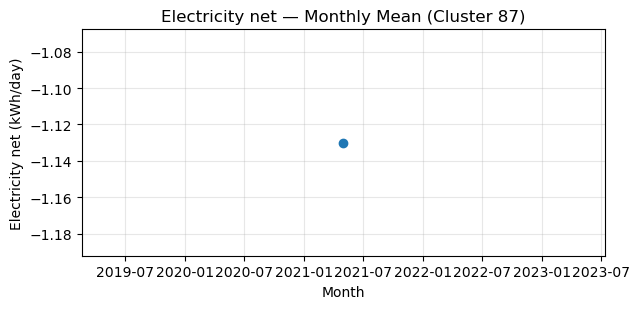

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2021

=== Cluster 88 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Mar 2023


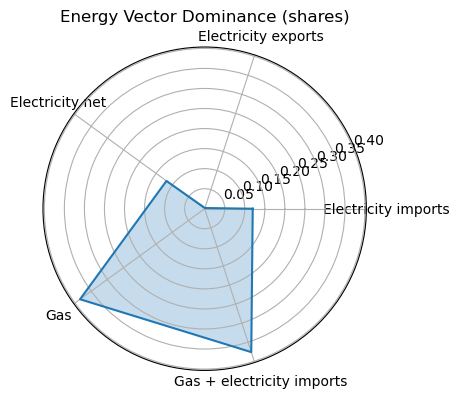

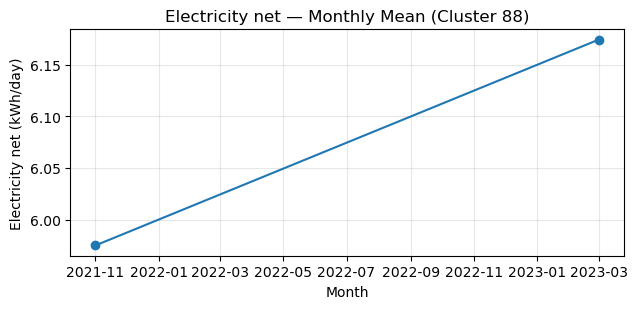

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2023

=== Cluster 89 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Feb 2023


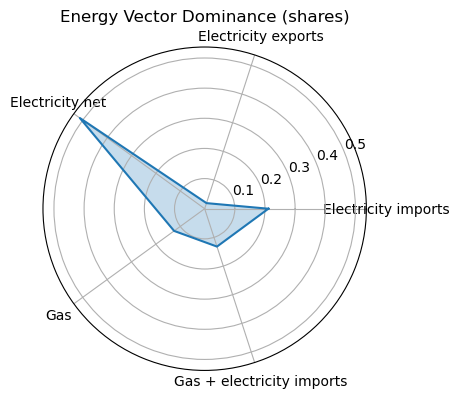

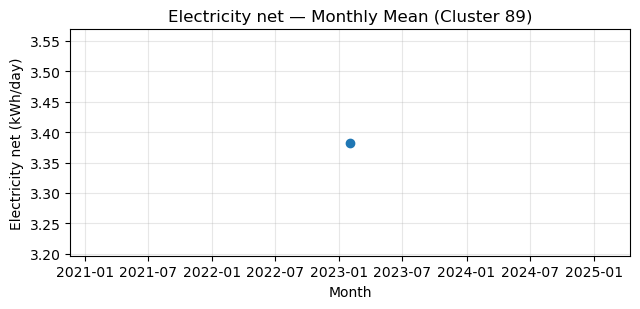

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2023

=== Cluster 90 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Mar 2022


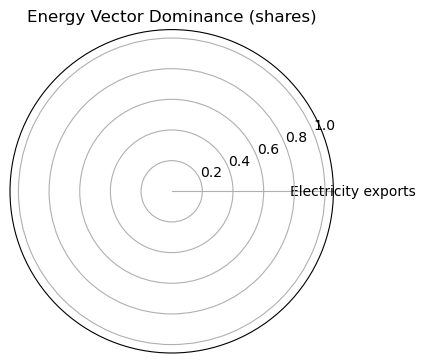

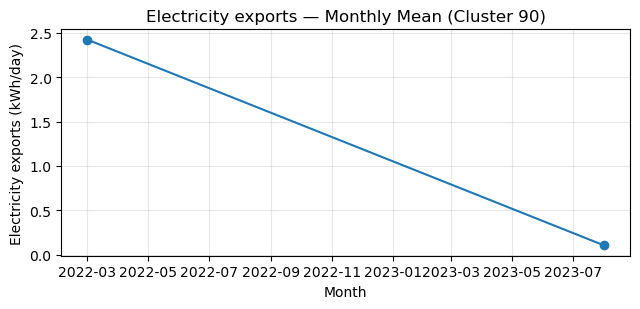

Target series: Electricity exports | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2022

=== Cluster 91 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Feb 2022


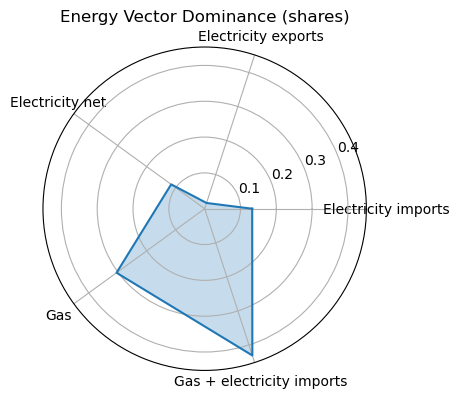

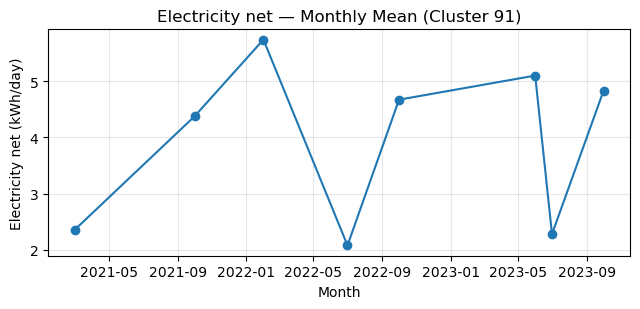

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2022

=== Cluster 92 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Dec 2021


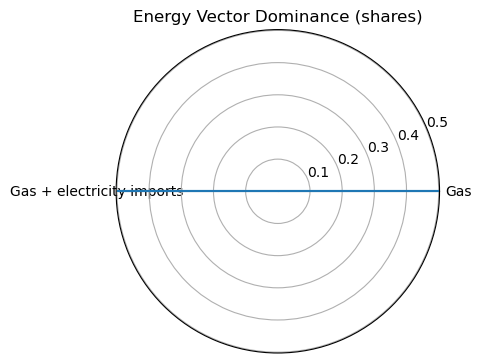

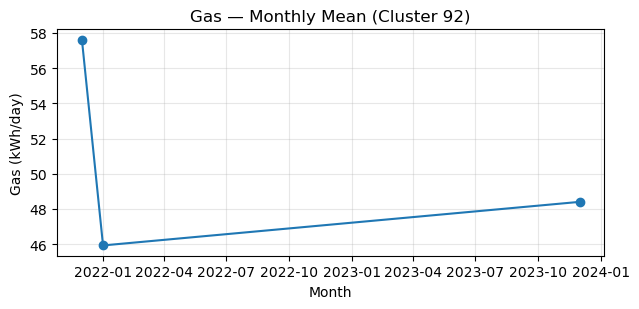

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2021

=== Cluster 93 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Oct 2023


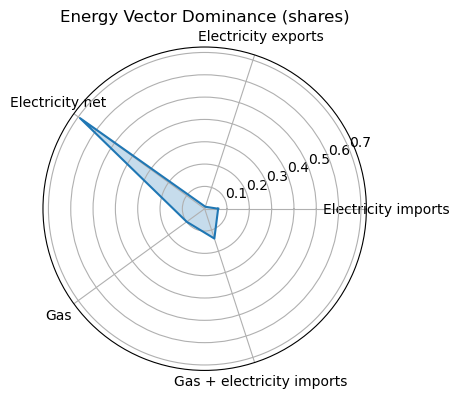

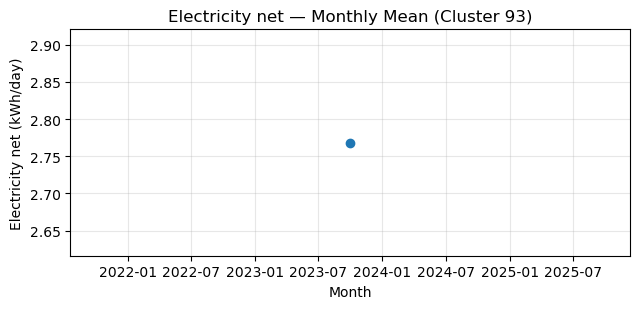

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2023

=== Cluster 94 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Dec 2022


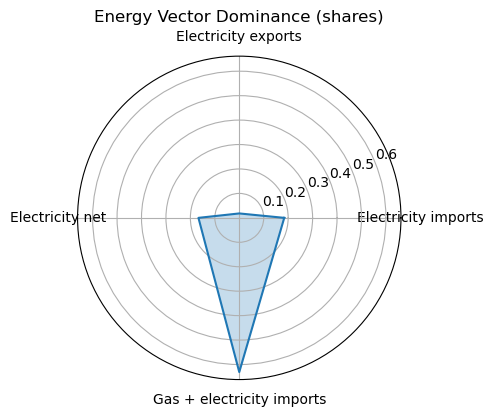

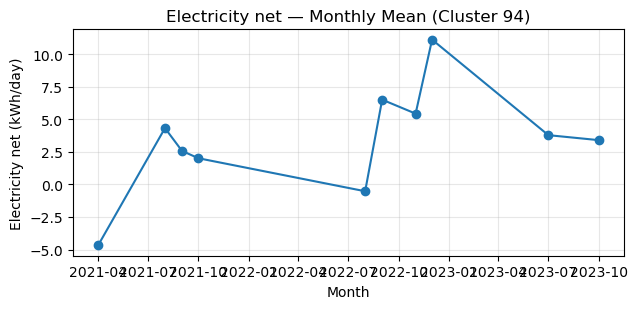

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2022

=== Cluster 95 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Feb 2022


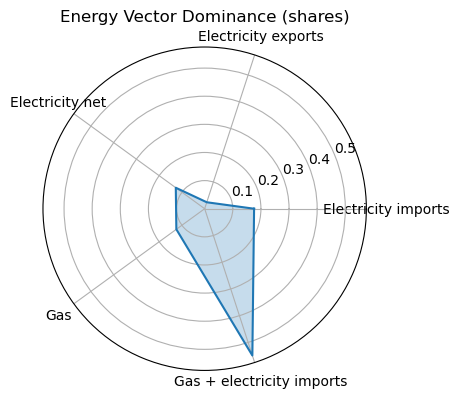

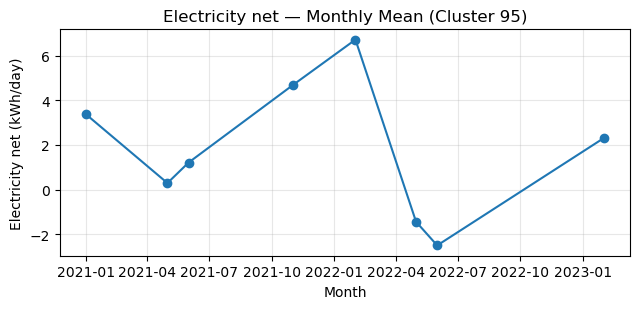

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2022

=== Cluster 96 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Oct 2021


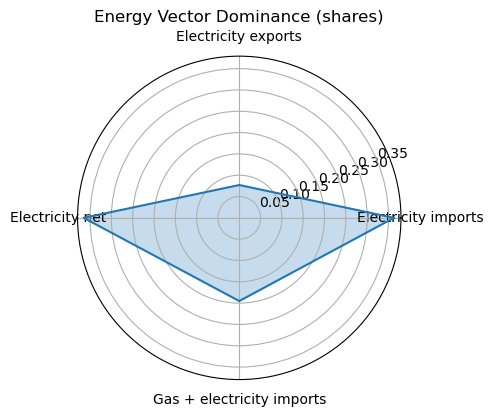

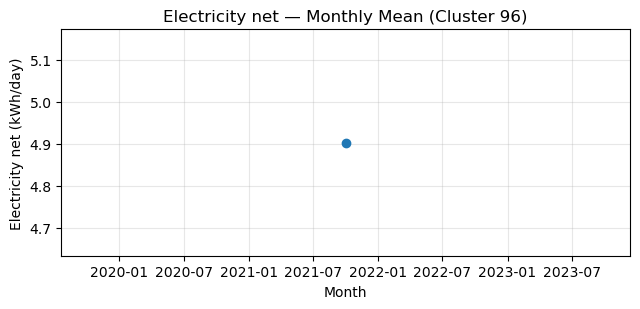

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2021

=== Cluster 97 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Dec 2022


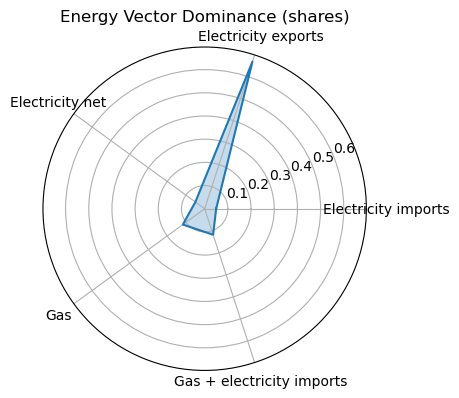

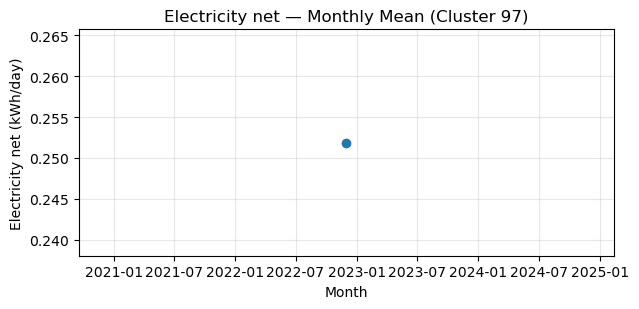

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2022

=== Cluster 98 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Sep 2021


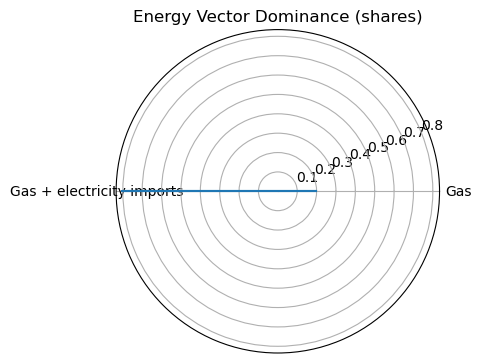

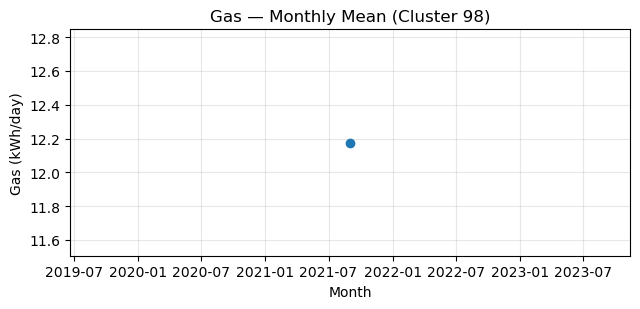

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: Sep 2021

=== Cluster 99 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Nov 2023


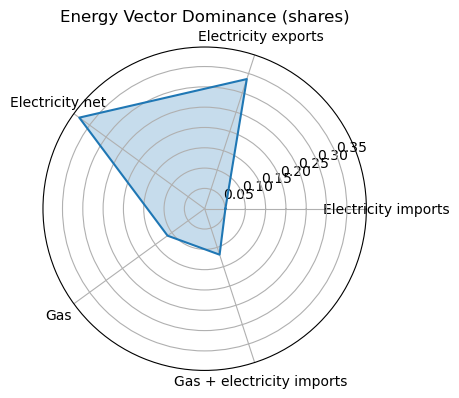

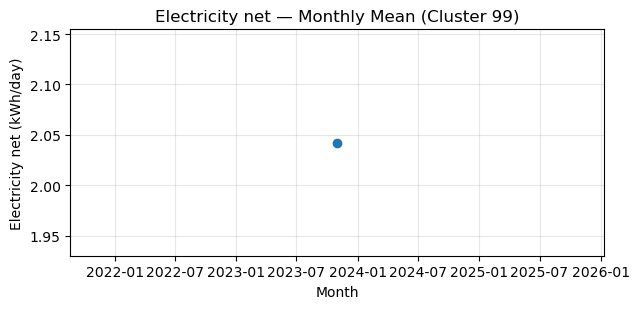

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2023

=== Cluster 100 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Oct 2022


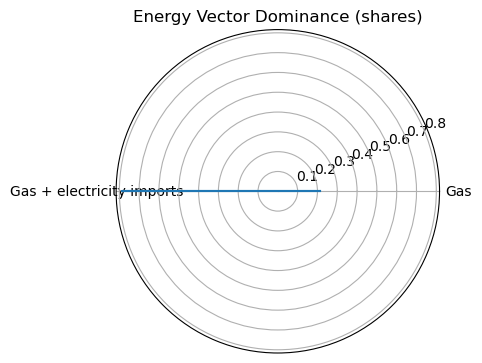

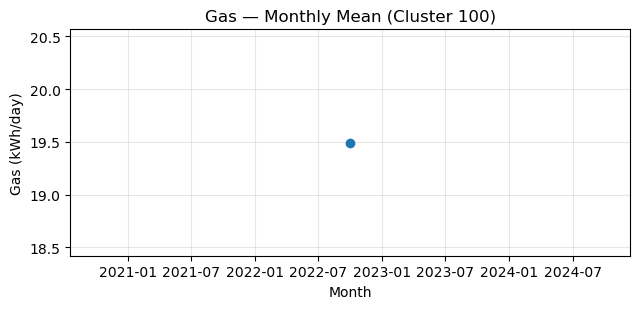

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2022

=== Cluster 101 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jul 2022


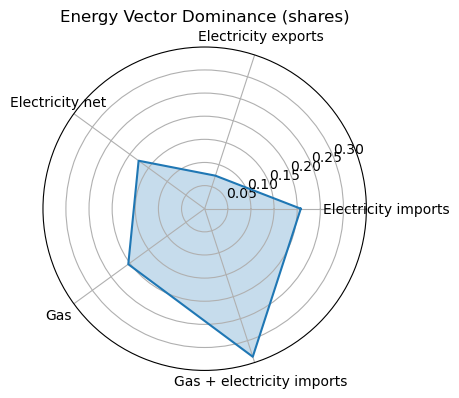

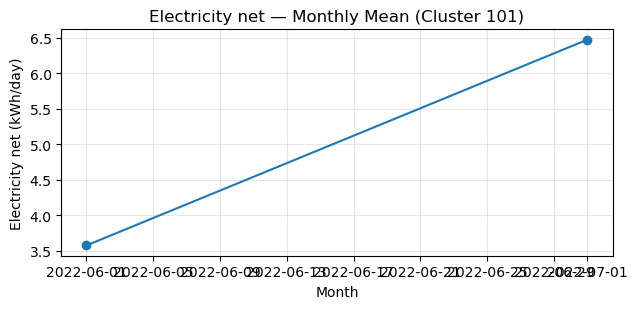

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2022

=== Cluster 102 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Jan 2022


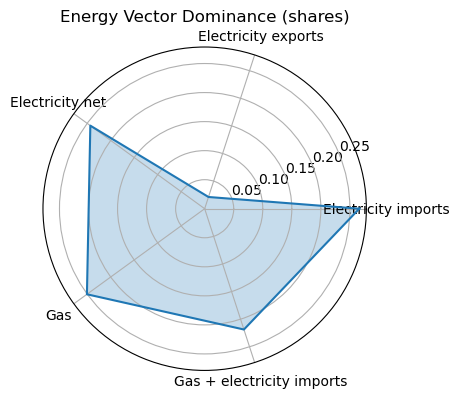

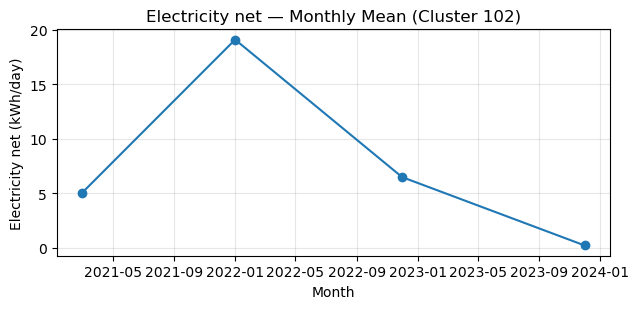

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2022

=== Cluster 103 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Jun 2022


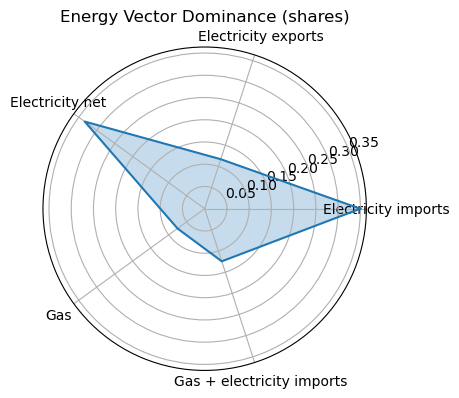

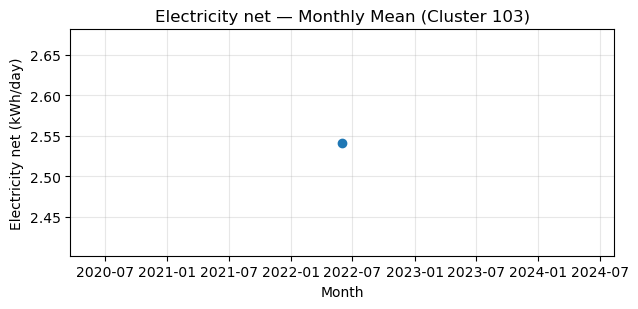

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jun 2022

=== Cluster 104 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in May 2022


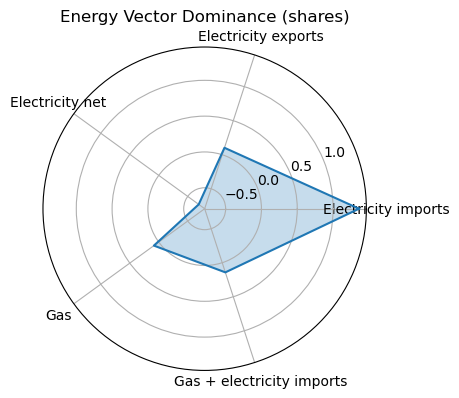

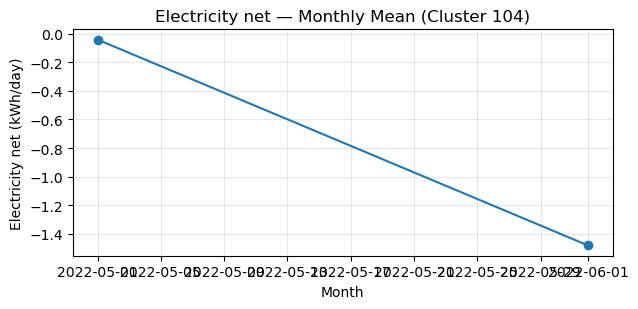

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2022

=== Cluster 105 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Dec 2022


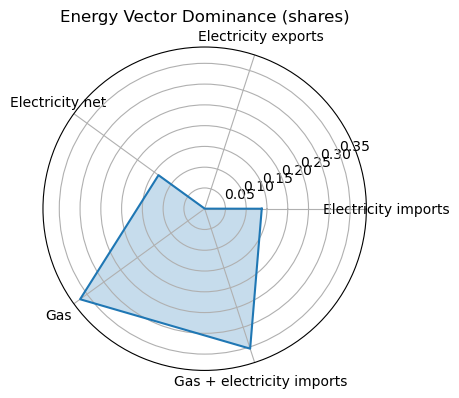

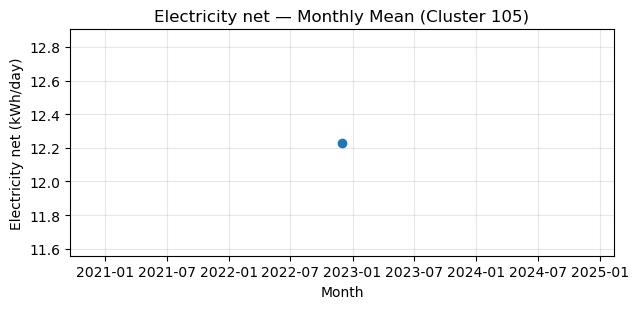

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2022

=== Cluster 106 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Feb 2021


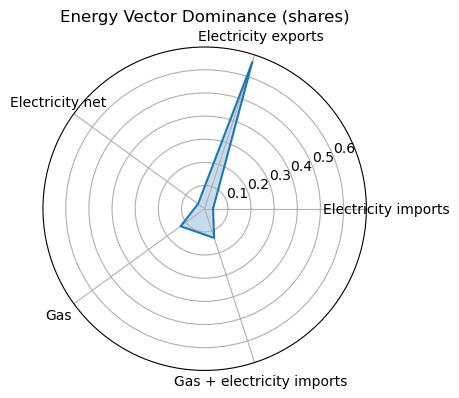

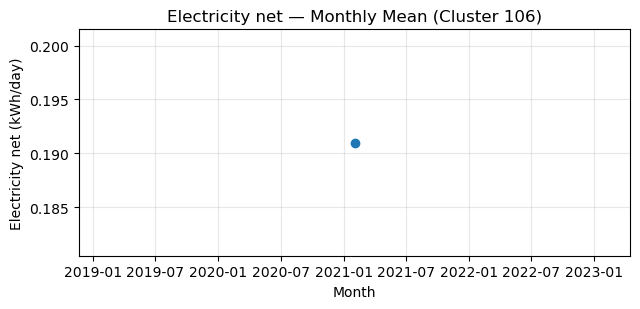

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2021

=== Cluster 107 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Feb 2021


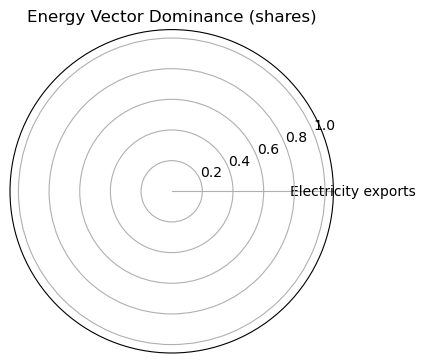

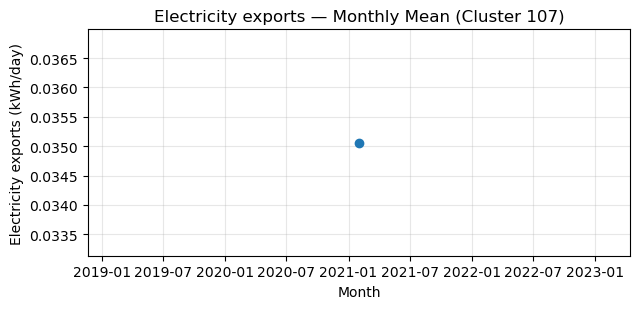

Target series: Electricity exports | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2021

=== Cluster 108 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Sep 2022


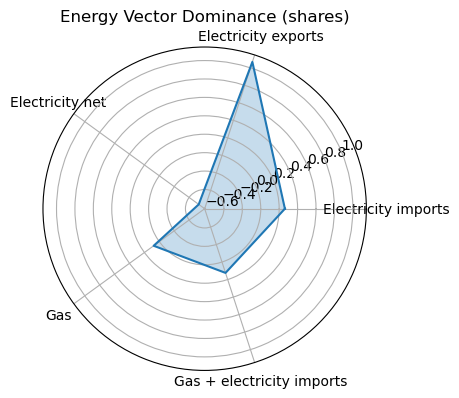

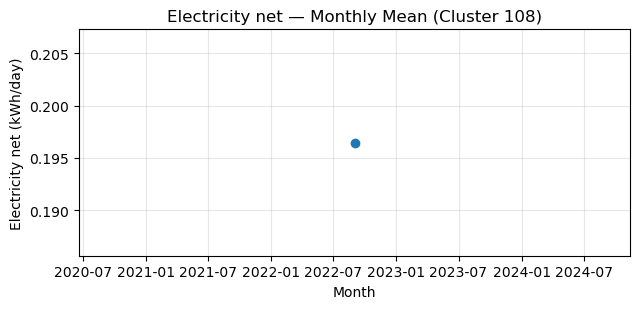

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Sep 2022

=== Cluster 109 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Apr 2022


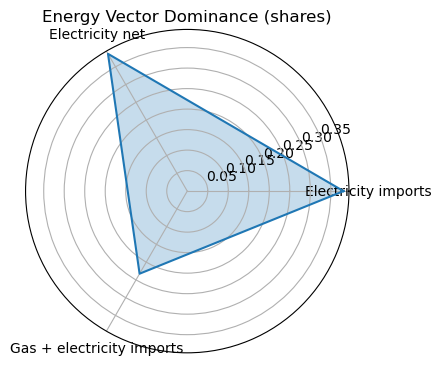

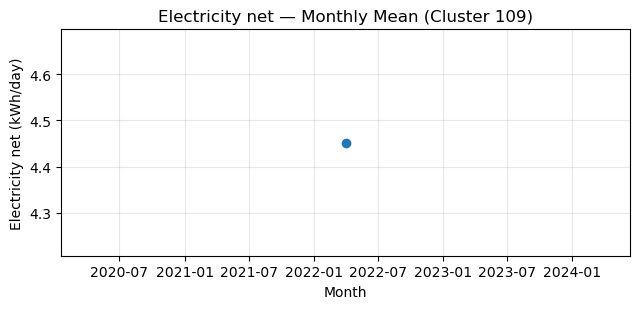

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2022

=== Cluster 110 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Dec 2022


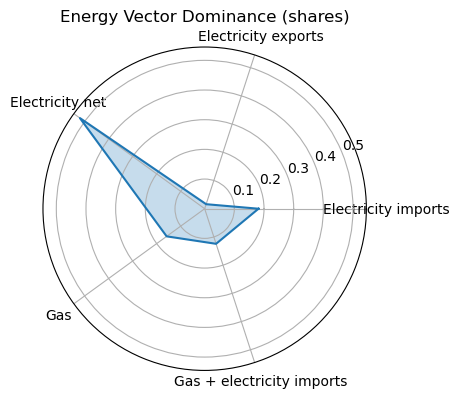

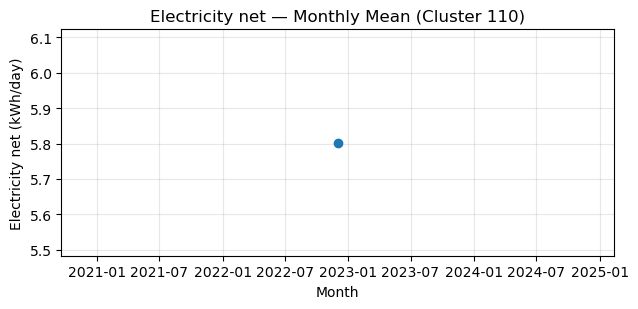

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2022

=== Cluster 111 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Dec 2023


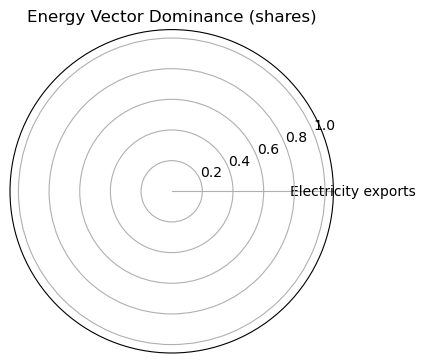

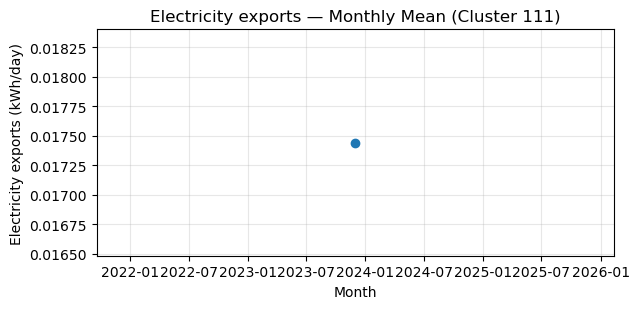

Target series: Electricity exports | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2023

=== Cluster 112 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Dec 2023


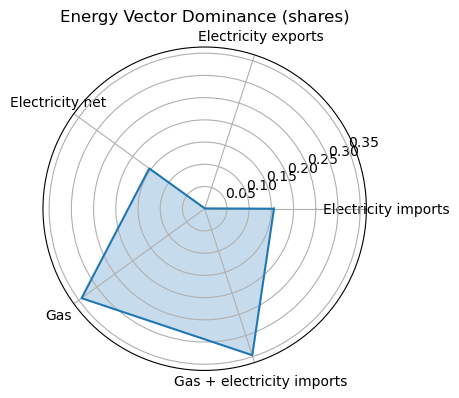

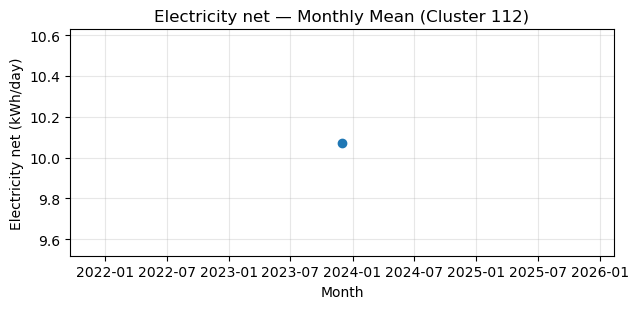

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2023

=== Cluster 113 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jul 2021


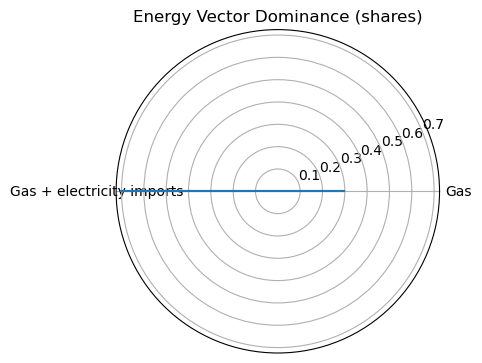

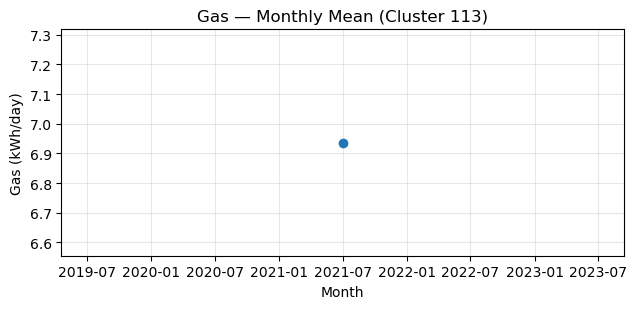

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2021

=== Cluster 114 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Dec 2022


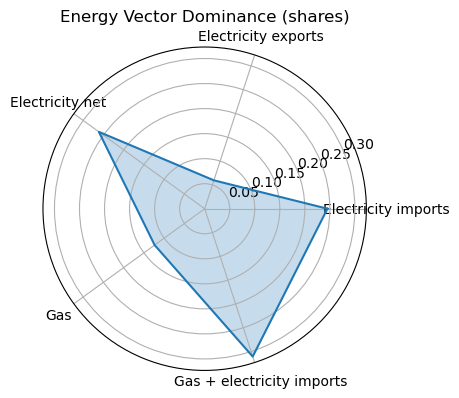

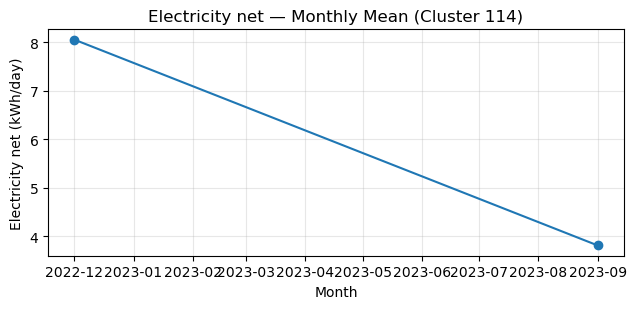

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2022

=== Cluster 115 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Sep 2023


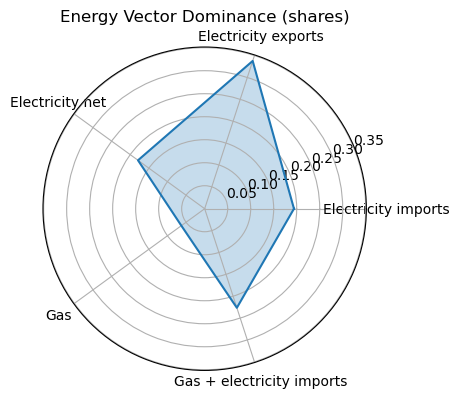

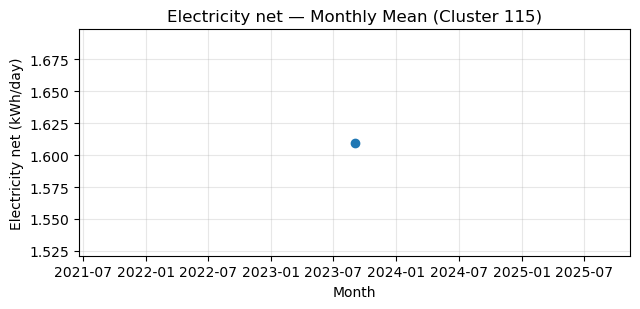

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Sep 2023

=== Cluster 116 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Sep 2023


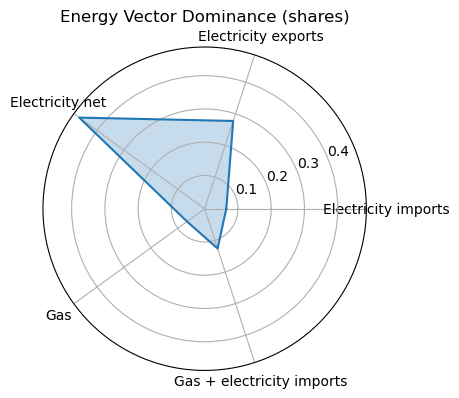

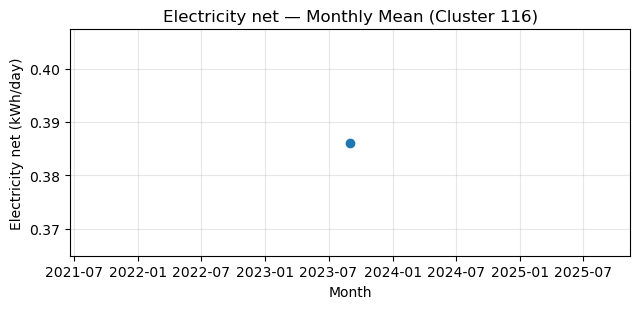

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Sep 2023

=== Cluster 117 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Jan 2023


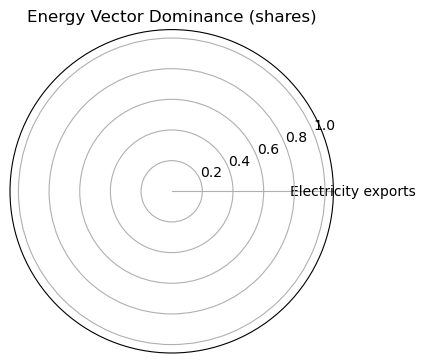

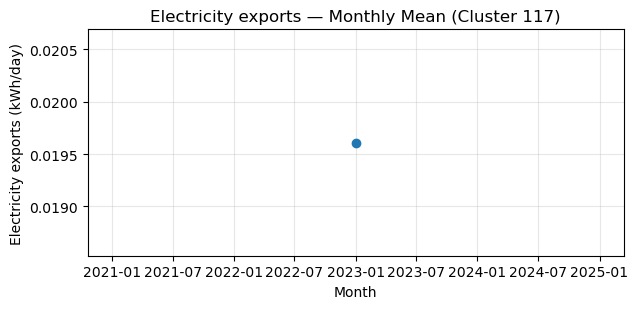

Target series: Electricity exports | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2023

=== Cluster 118 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Jan 2023


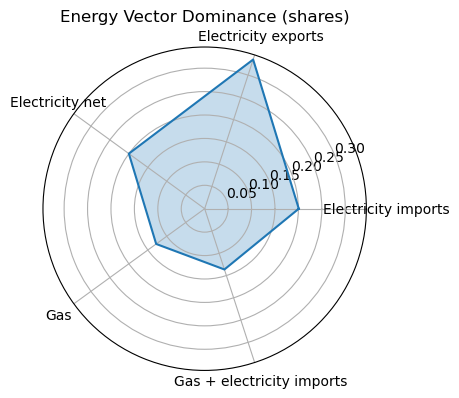

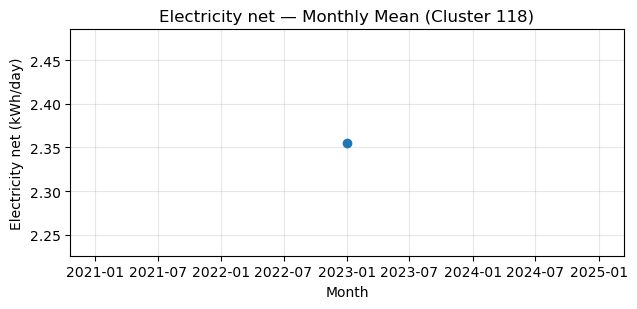

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2023

=== Cluster 119 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Aug 2023


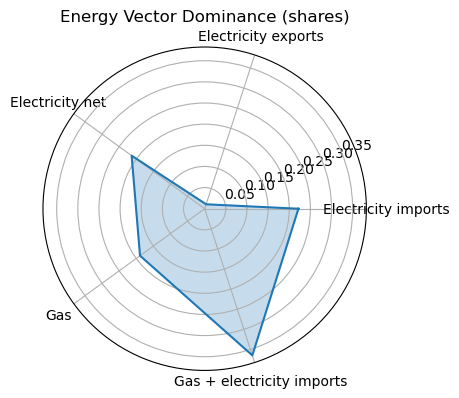

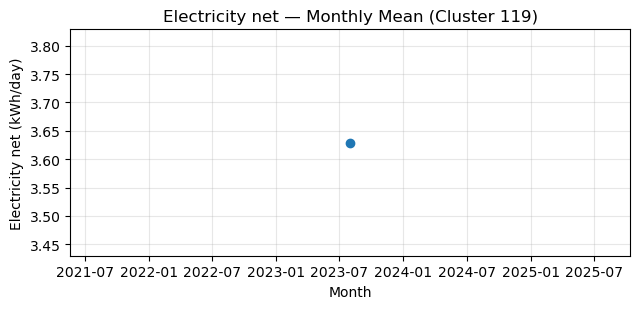

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Aug 2023

=== Cluster 120 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Feb 2021


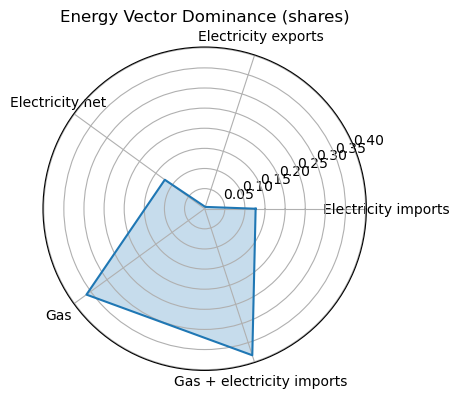

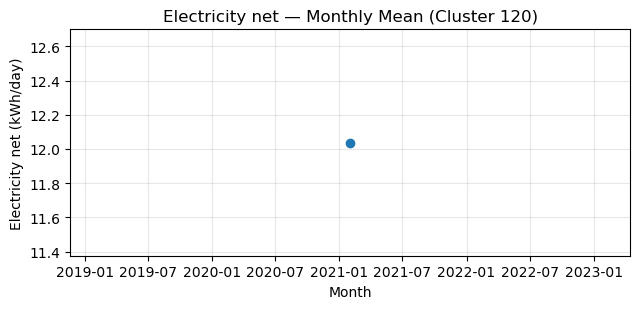

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2021

=== Cluster 121 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Sep 2021


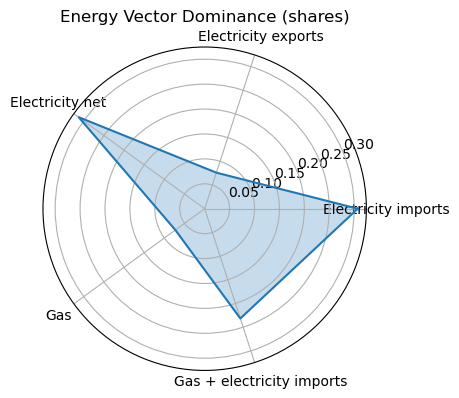

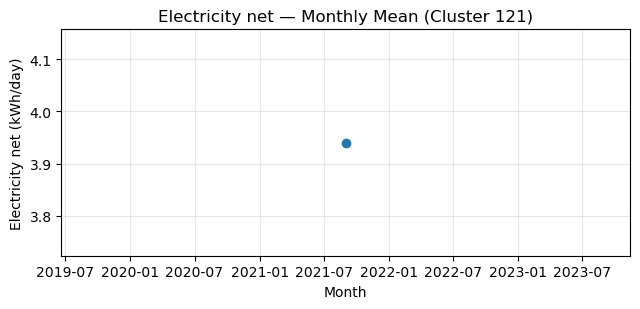

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Sep 2021

=== Cluster 122 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Nov 2023


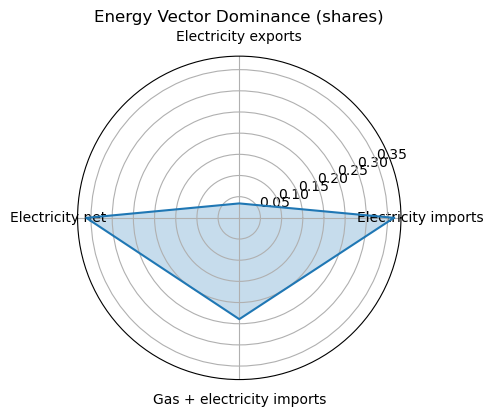

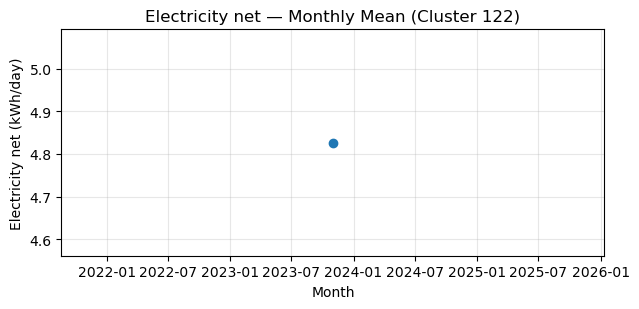

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2023

=== Cluster 123 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Dec 2021


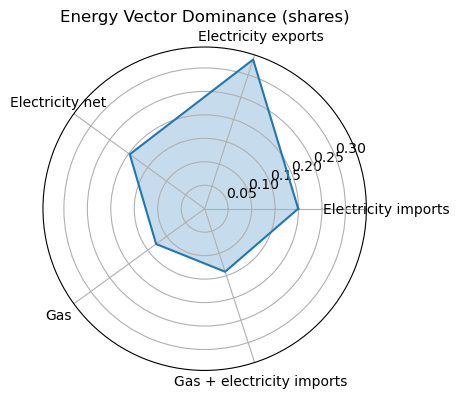

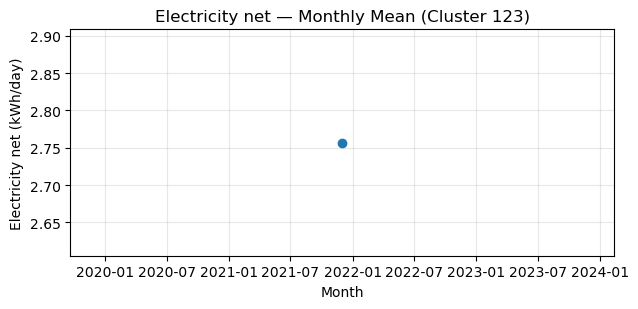

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2021

=== Cluster 124 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Dec 2021


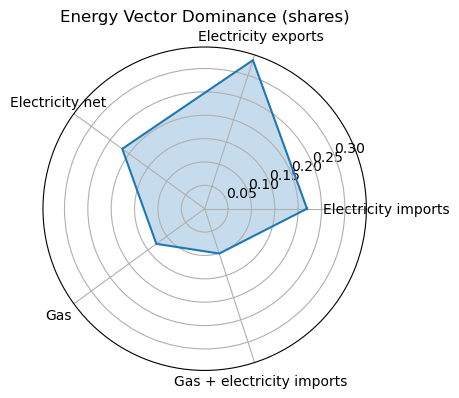

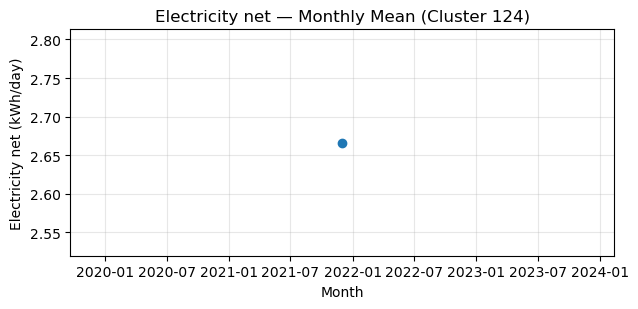

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2021

=== Cluster 125 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jul 2021


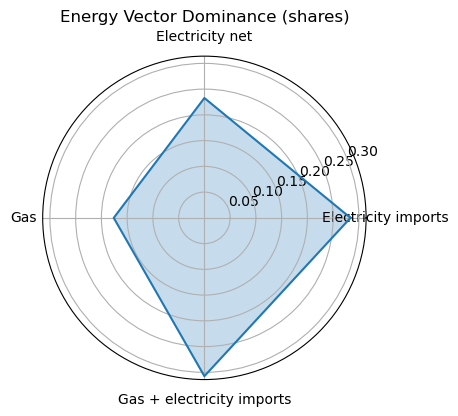

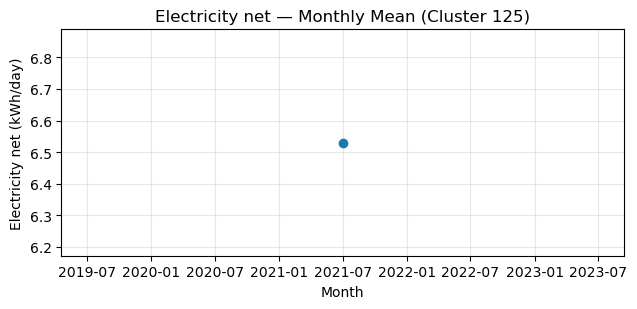

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2021

=== Cluster 126 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jul 2021


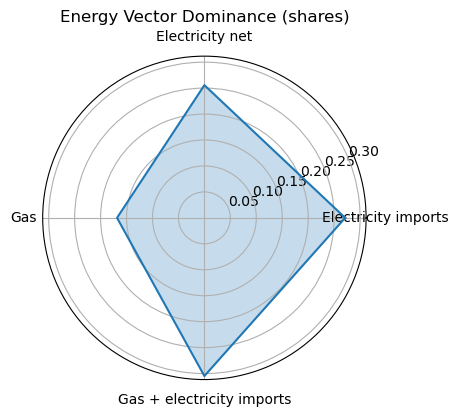

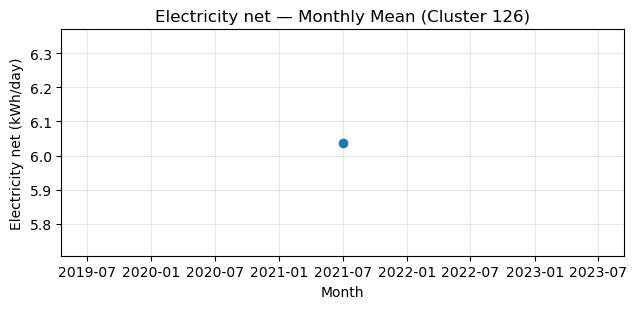

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jul 2021

=== Cluster 127 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Oct 2022


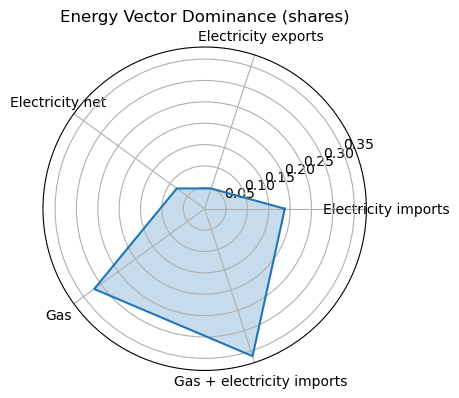

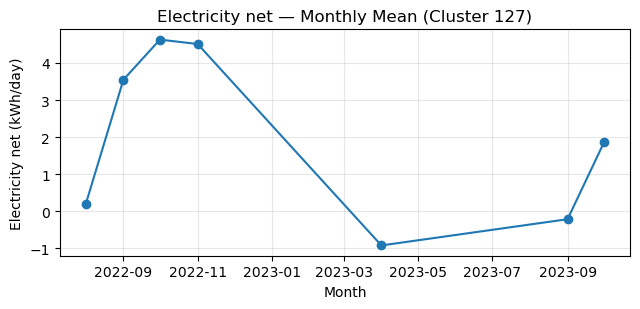

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2022

=== Cluster 128 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Oct 2021


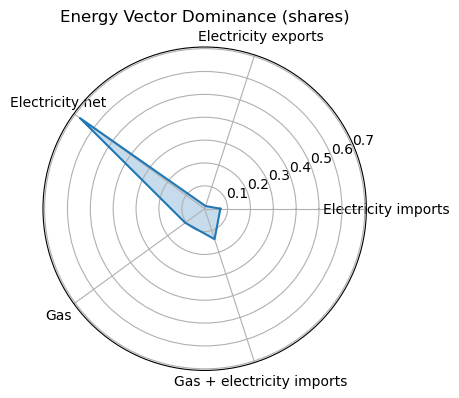

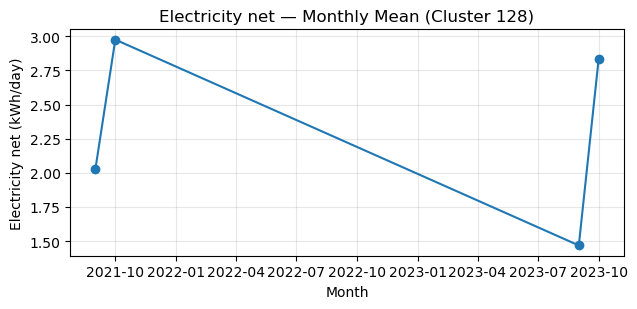

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2021

=== Cluster 129 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Nov 2023


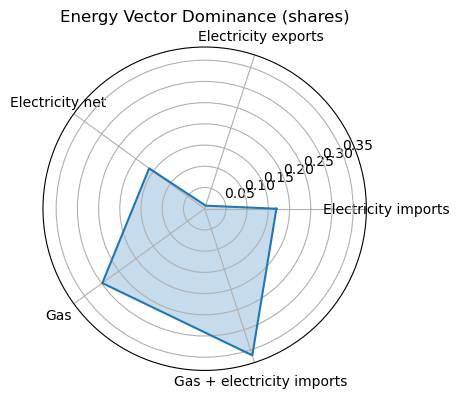

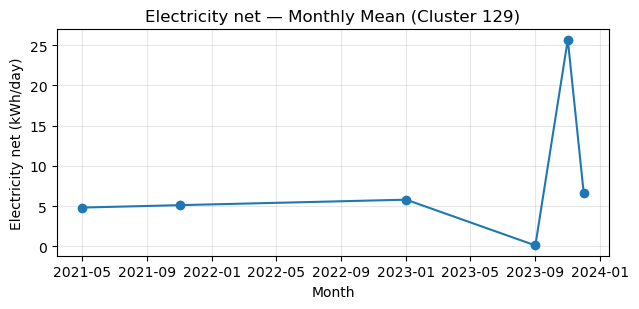

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2023

=== Cluster 130 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Mar 2021


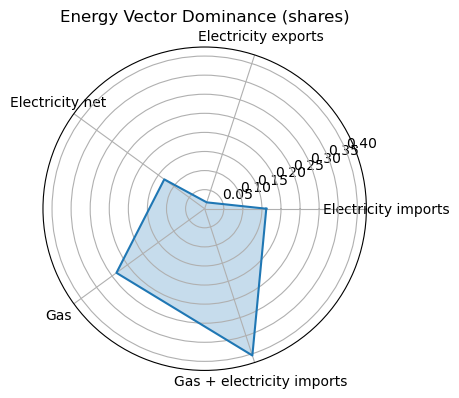

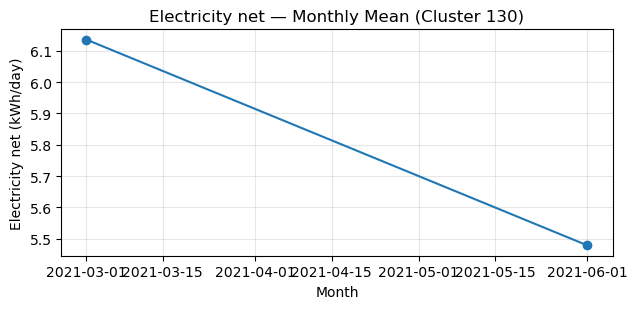

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2021

=== Cluster 131 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Feb 2022


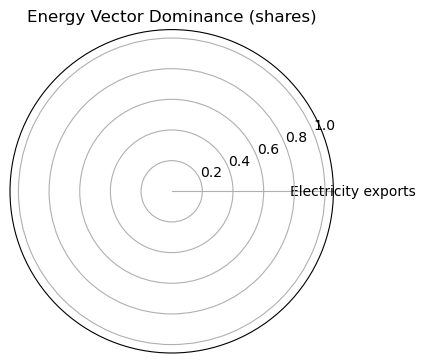

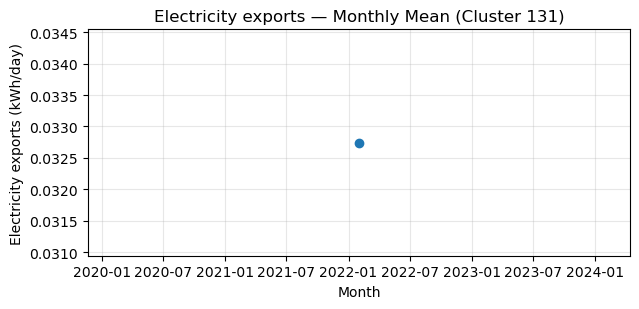

Target series: Electricity exports | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2022

=== Cluster 132 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Feb 2022


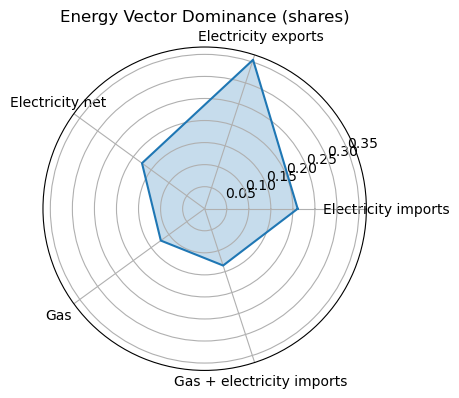

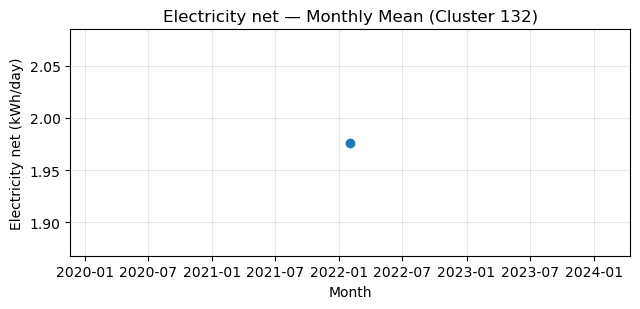

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2022

=== Cluster 133 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Nov 2022


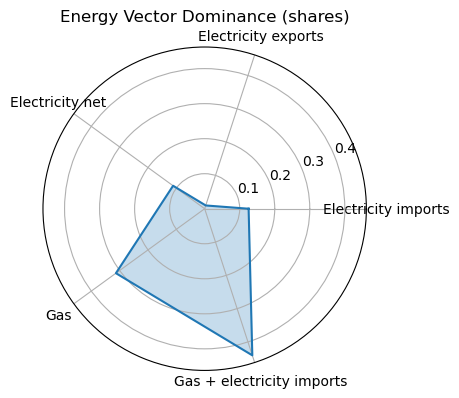

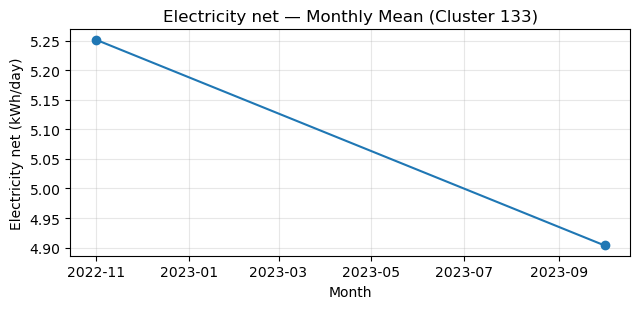

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2022

=== Cluster 134 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Nov 2023


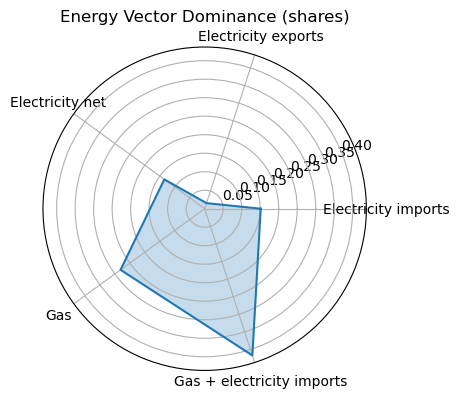

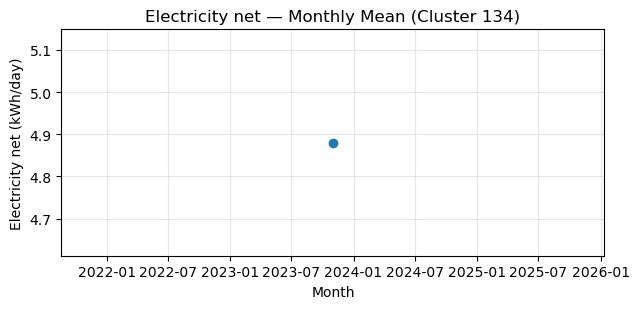

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2023

=== Cluster 135 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Sep 2021


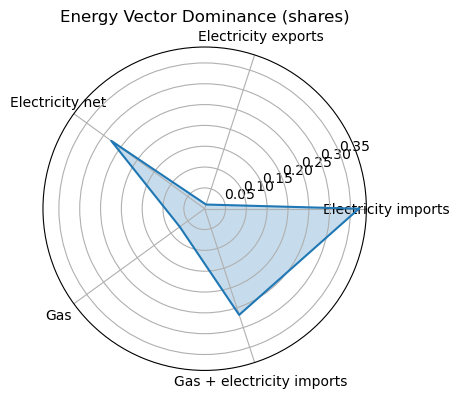

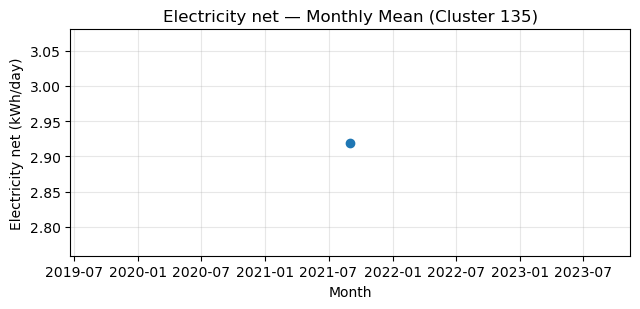

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Sep 2021

=== Cluster 136 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Oct 2021


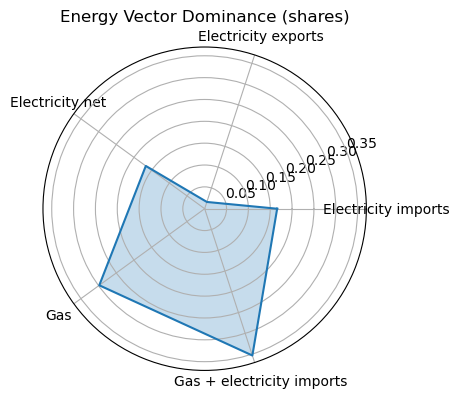

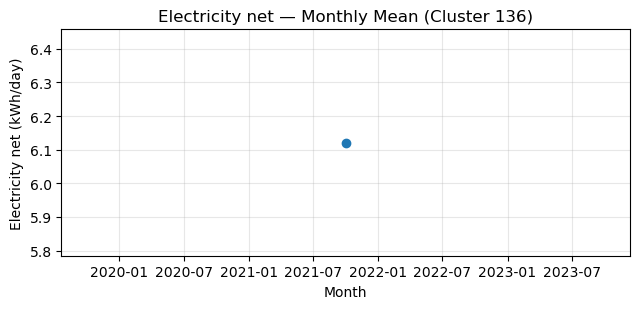

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2021

=== Cluster 137 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Dec 2023


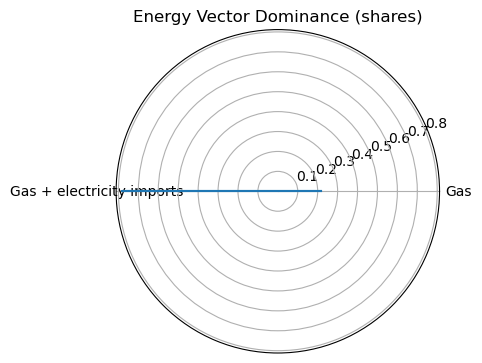

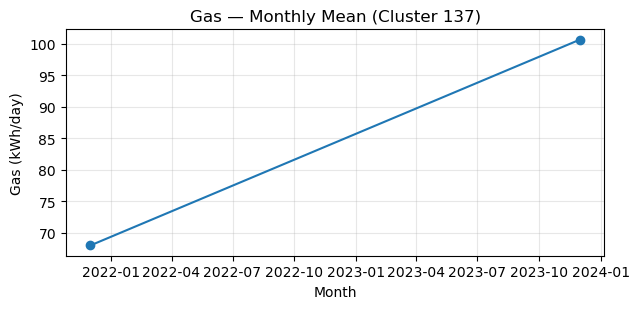

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2023

=== Cluster 138 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Mar 2021


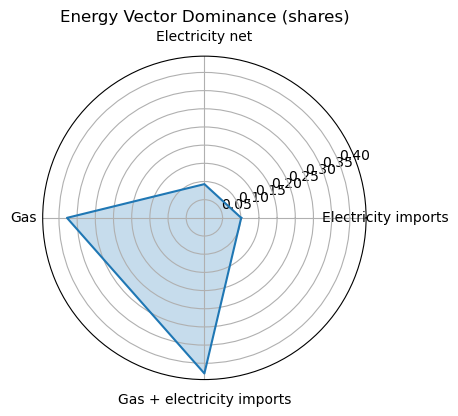

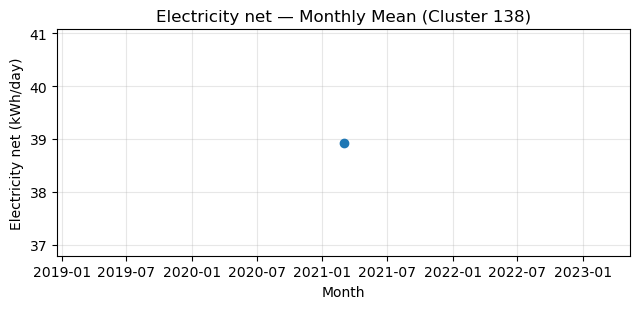

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2021

=== Cluster 139 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jun 2021


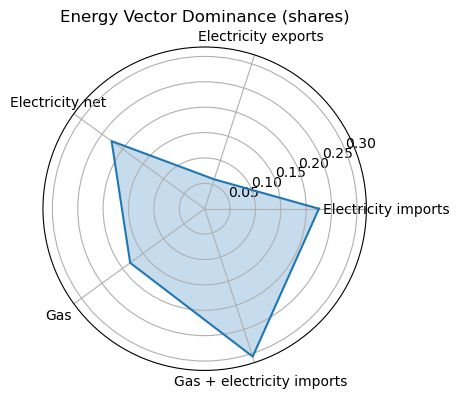

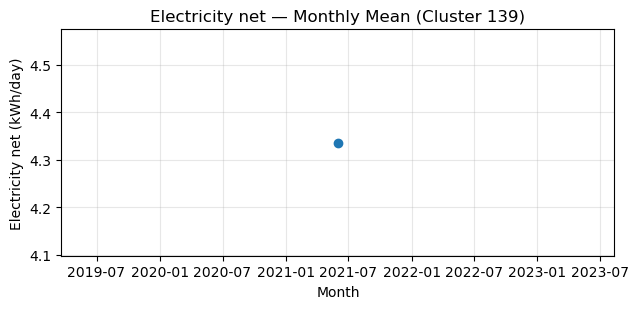

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jun 2021

=== Cluster 140 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Apr 2022


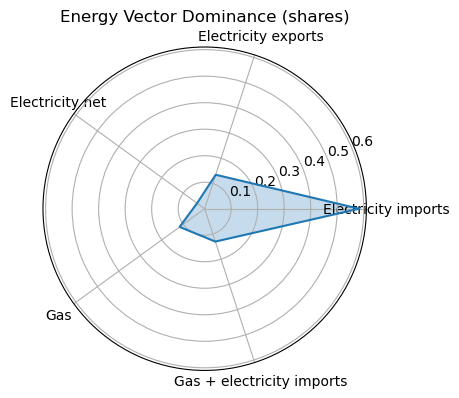

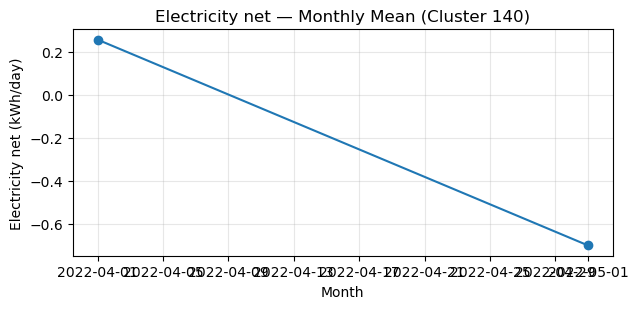

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2022

=== Cluster 141 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jun 2023


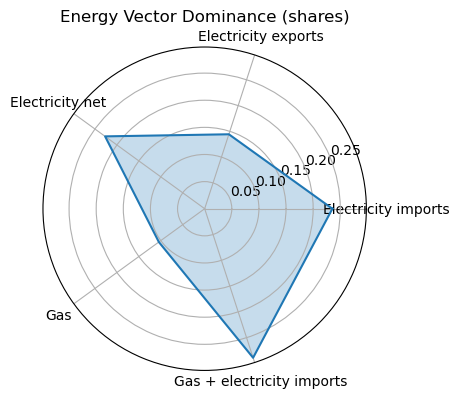

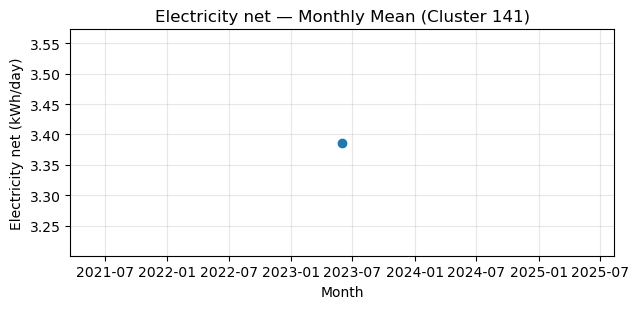

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jun 2023

=== Cluster 142 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jun 2023


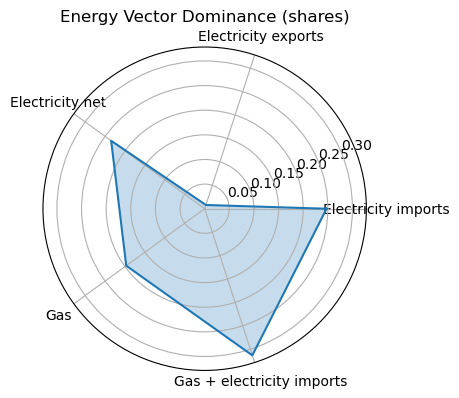

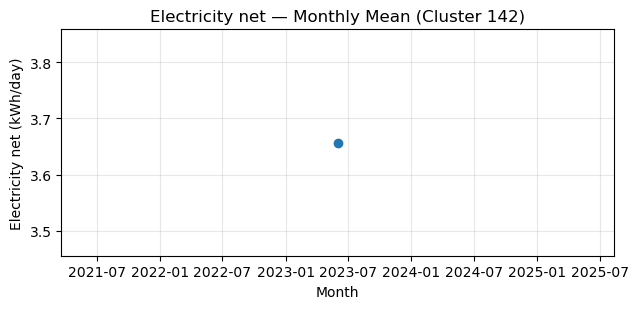

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jun 2023

=== Cluster 143 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in May 2021


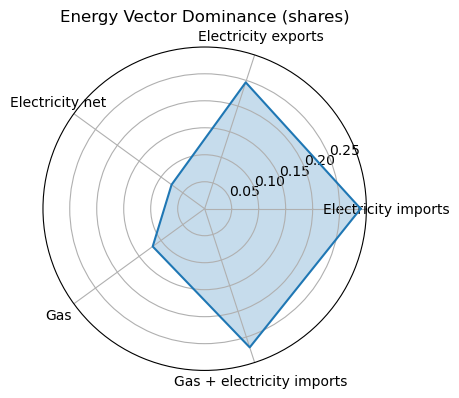

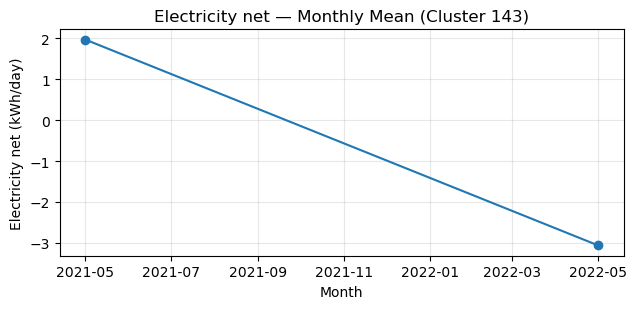

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2021

=== Cluster 144 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Aug 2023


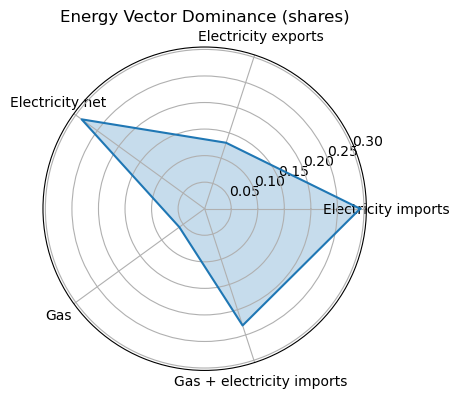

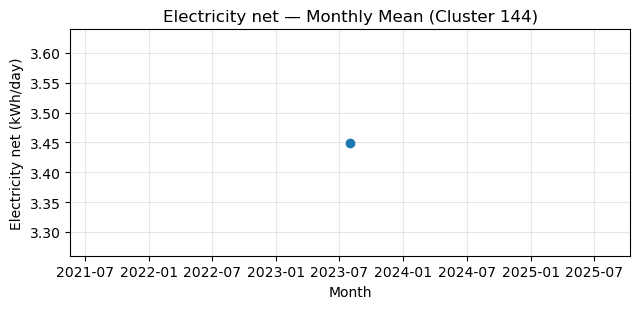

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Aug 2023

=== Cluster 145 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Nov 2022


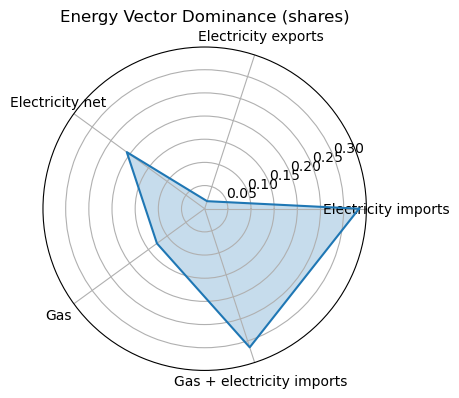

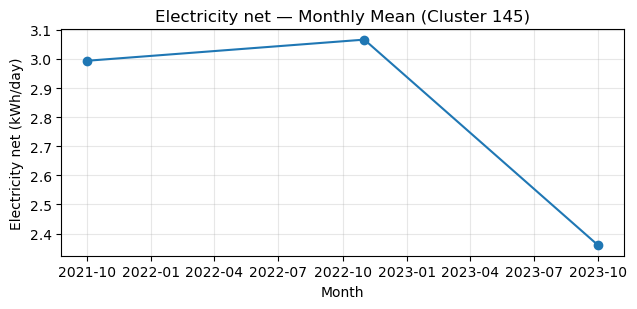

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2022

=== Cluster 146 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Oct 2021


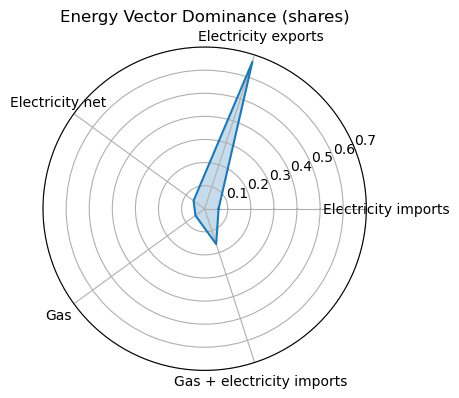

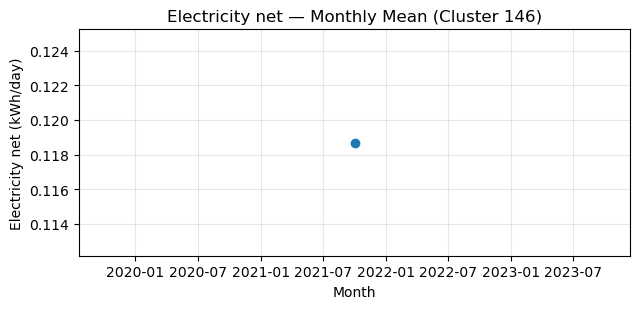

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2021

=== Cluster 147 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Dec 2021


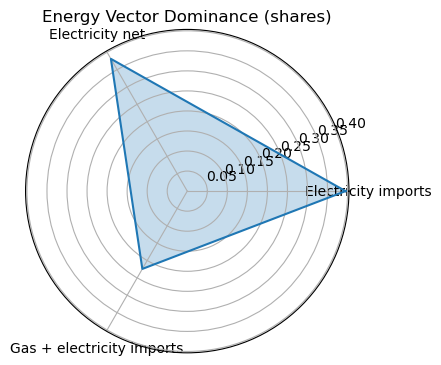

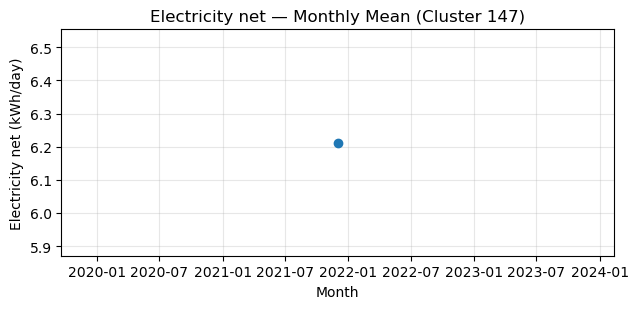

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2021

=== Cluster 148 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Nov 2022


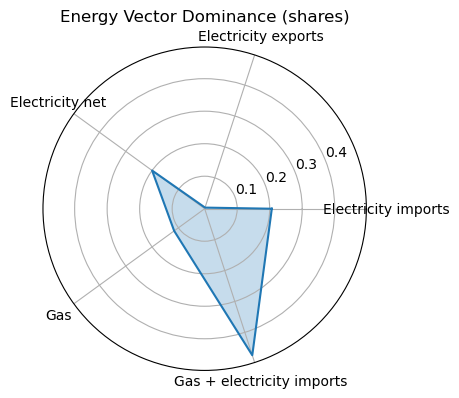

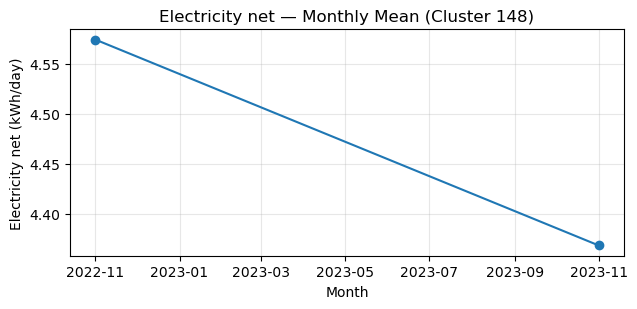

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2022

=== Cluster 149 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Sep 2023


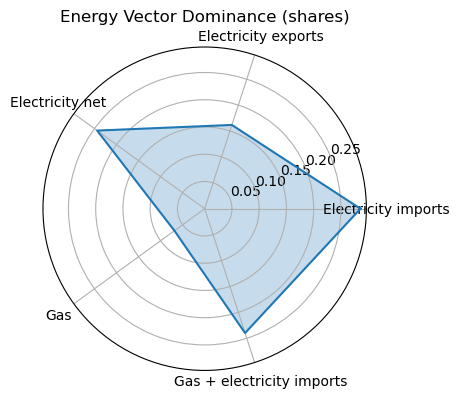

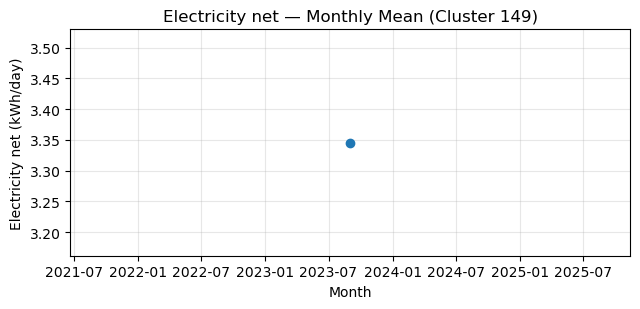

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Sep 2023

=== Cluster 150 ===
Persona Label: Mixed Imports, unknown seasonality, peak in May 2023


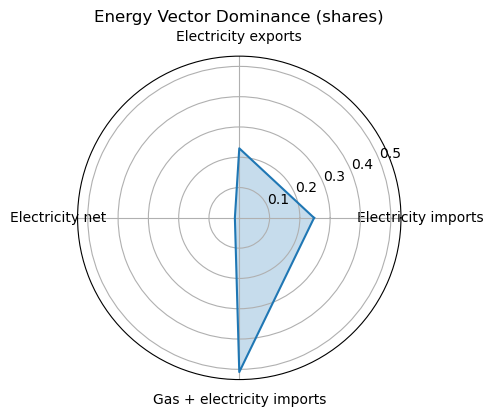

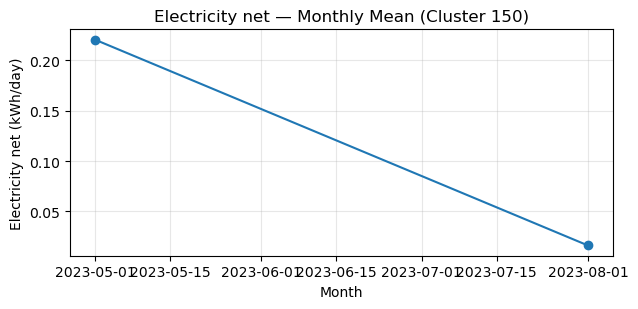

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2023

=== Cluster 151 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Nov 2022


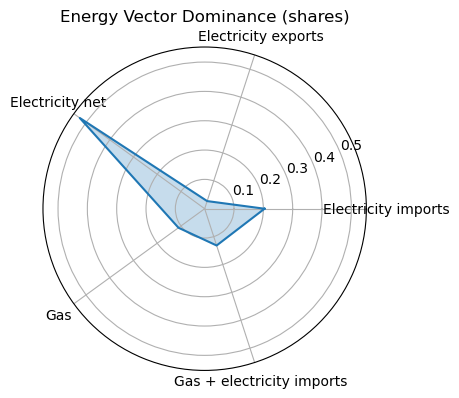

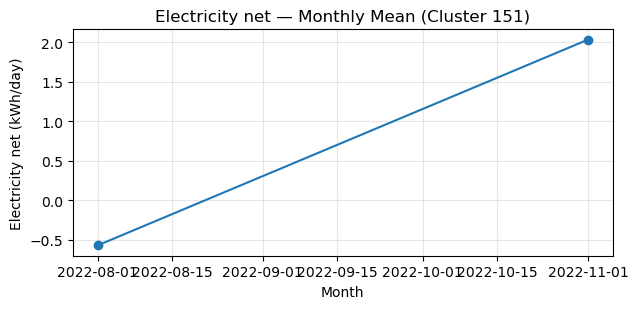

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2022

=== Cluster 152 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Oct 2023


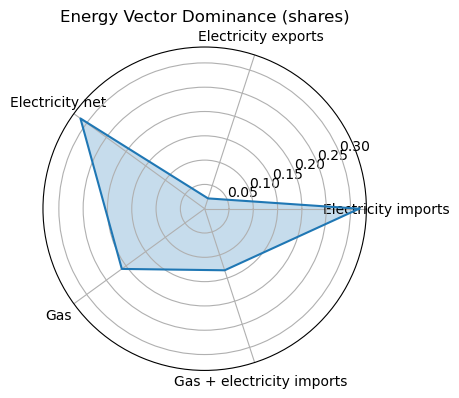

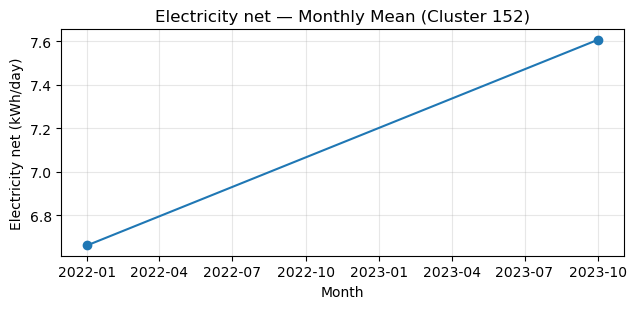

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2023

=== Cluster 153 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Sep 2021


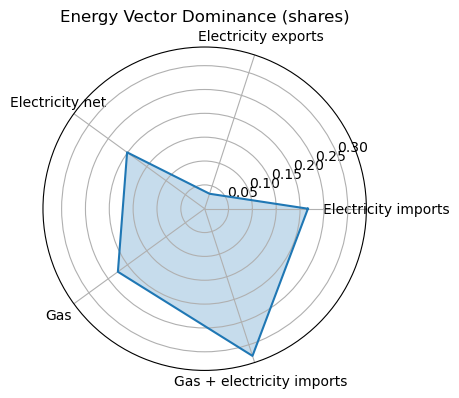

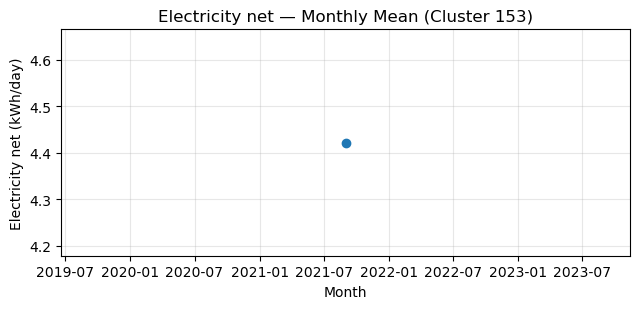

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Sep 2021

=== Cluster 154 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Feb 2021


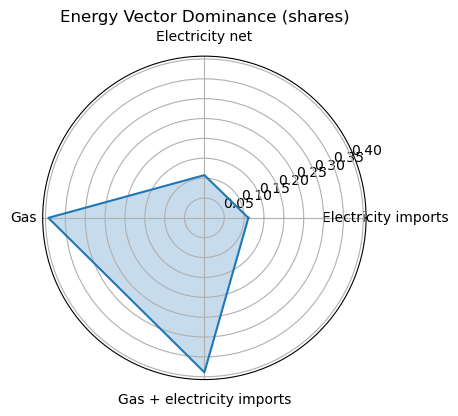

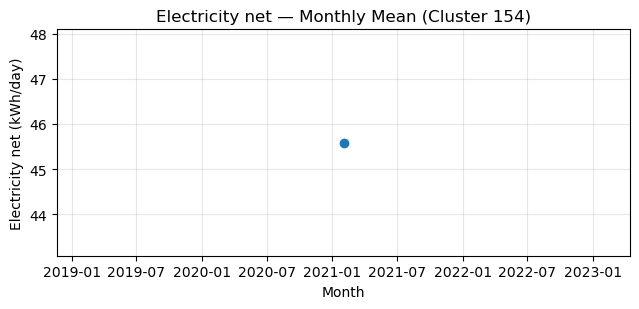

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2021

=== Cluster 155 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Nov 2023


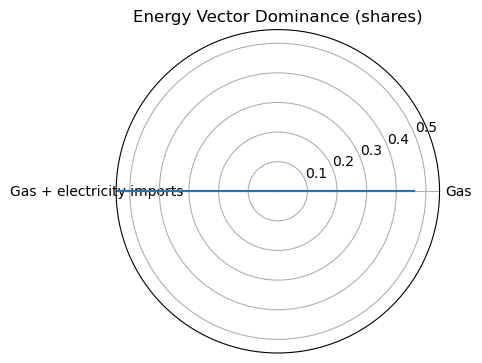

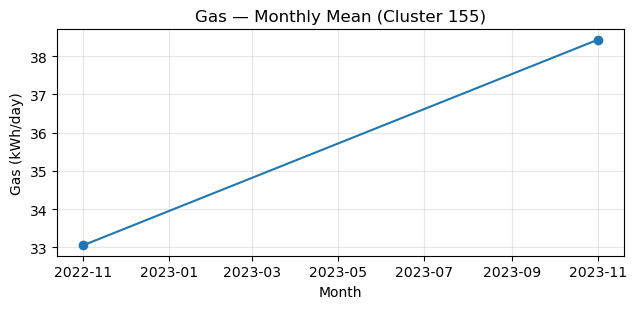

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2023

=== Cluster 156 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Nov 2023


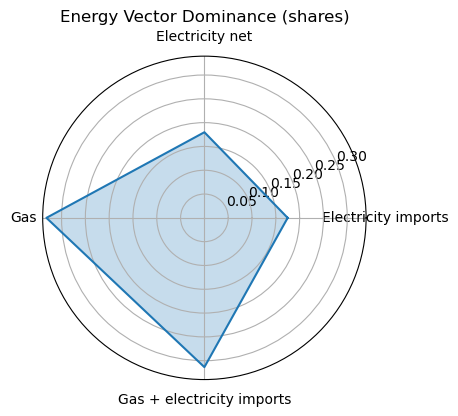

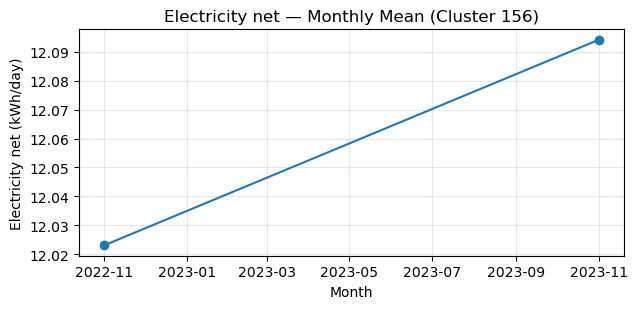

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2023

=== Cluster 157 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Aug 2021


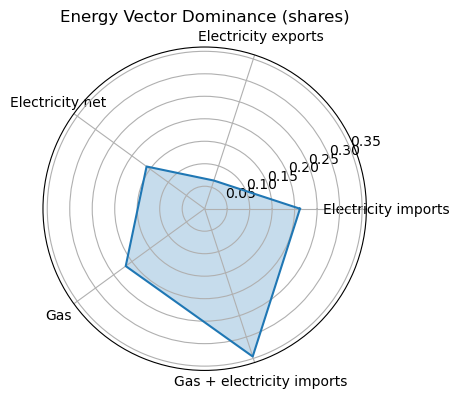

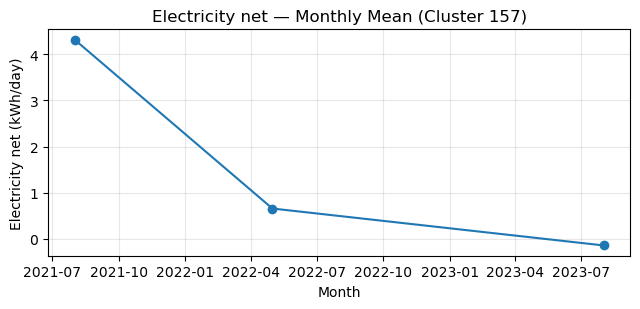

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Aug 2021

=== Cluster 158 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Jan 2021


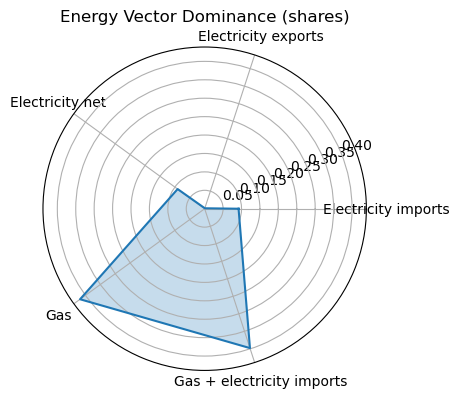

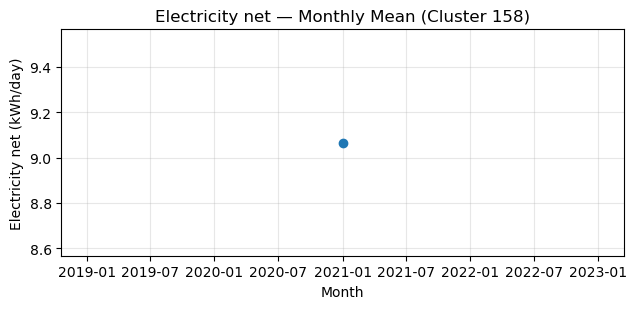

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2021

=== Cluster 159 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Oct 2022


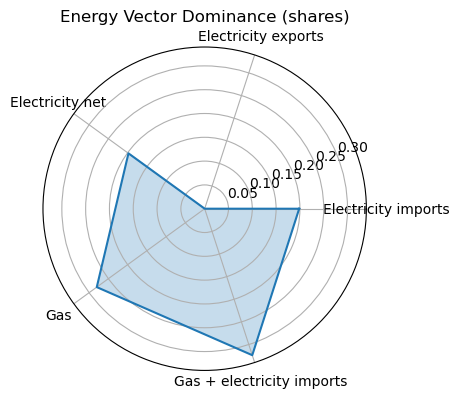

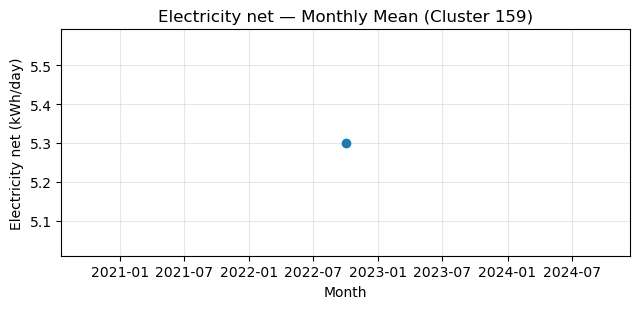

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2022

=== Cluster 160 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Oct 2022


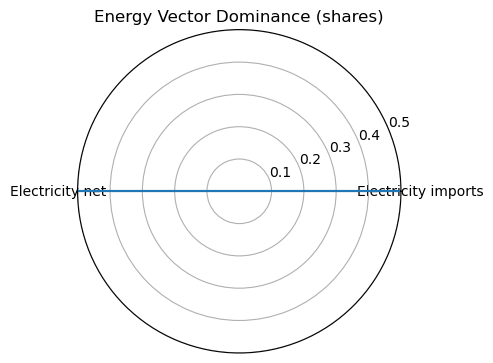

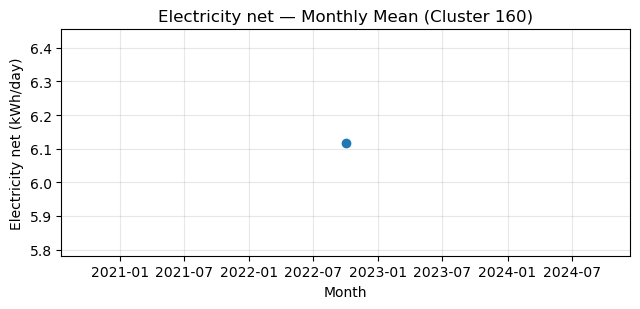

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2022

=== Cluster 161 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Aug 2022


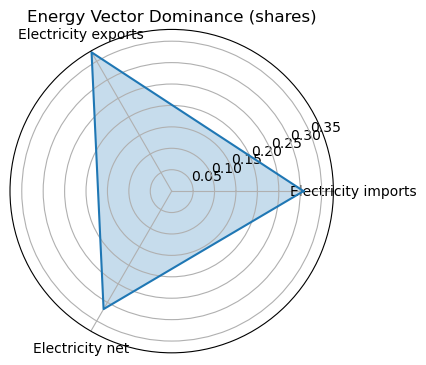

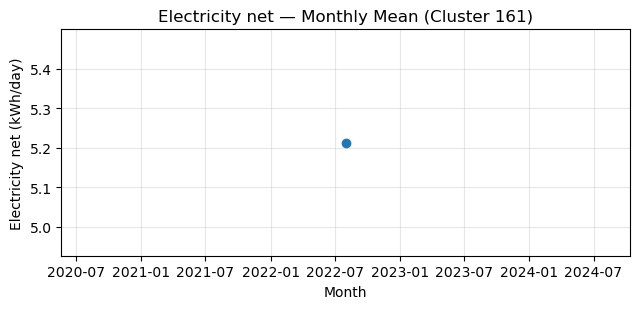

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Aug 2022

=== Cluster 162 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Mar 2022


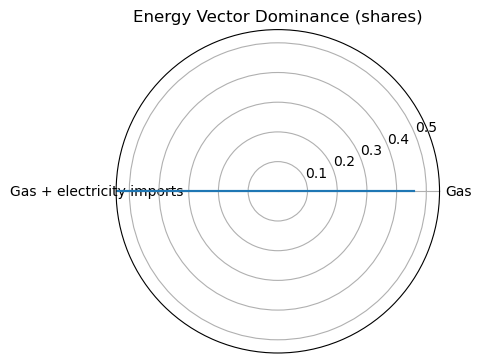

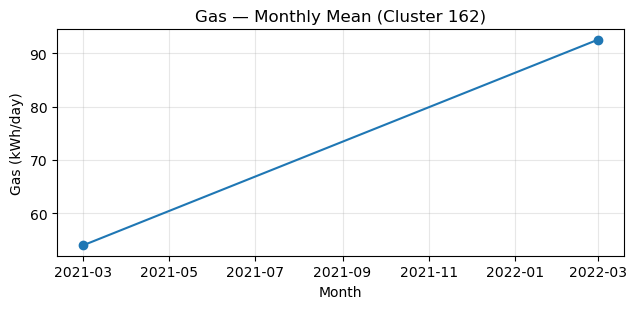

Target series: Gas | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2022

=== Cluster 163 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Feb 2023


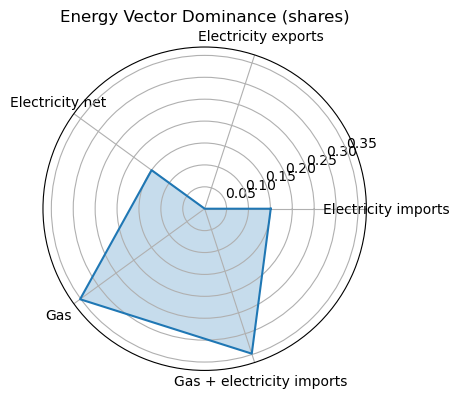

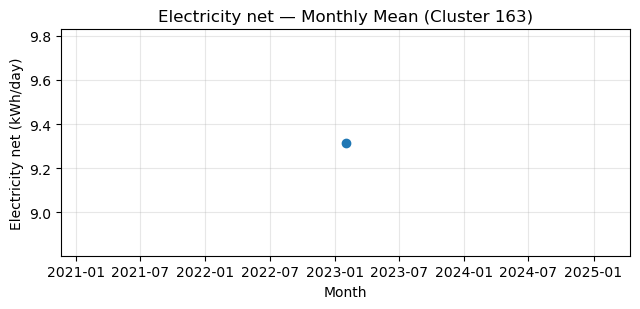

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2023

=== Cluster 164 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Mar 2022


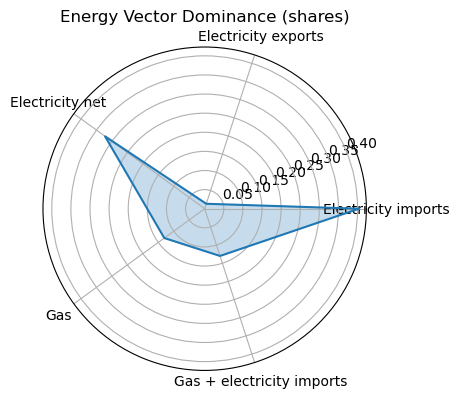

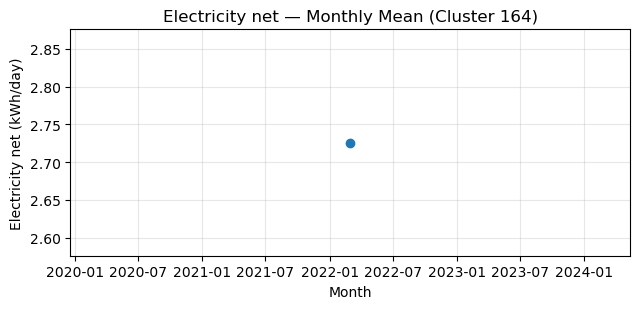

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2022

=== Cluster 165 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Oct 2023


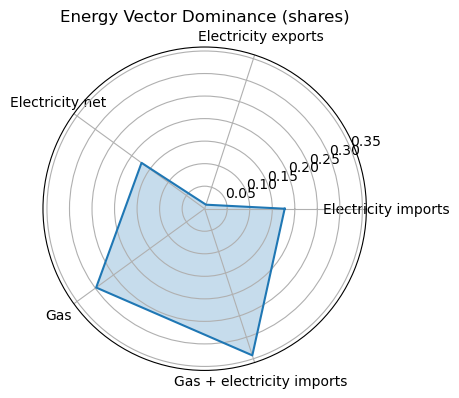

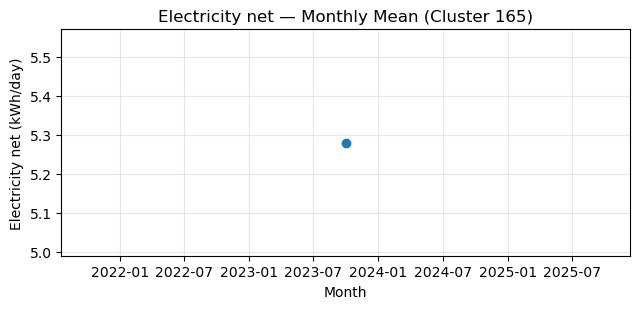

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2023

=== Cluster 166 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Oct 2023


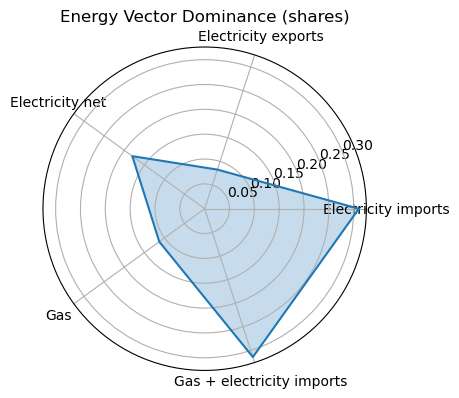

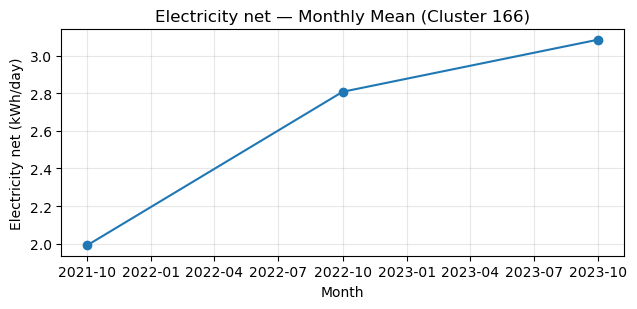

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Oct 2023

=== Cluster 167 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Apr 2021


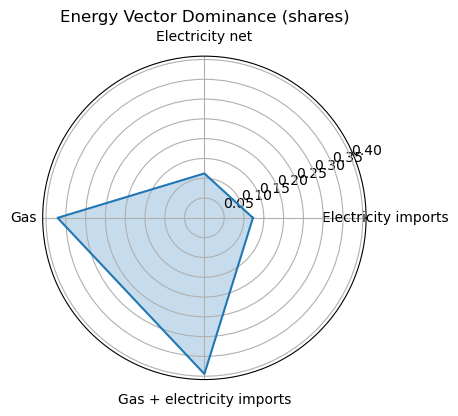

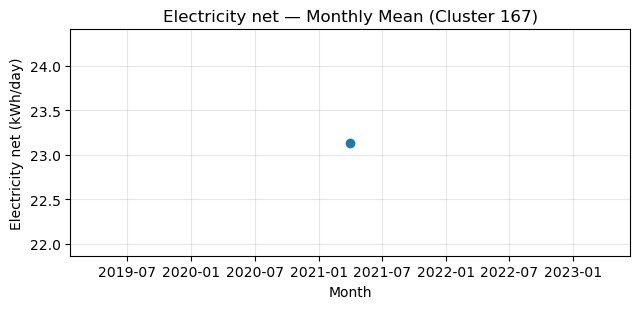

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2021

=== Cluster 168 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Dec 2021


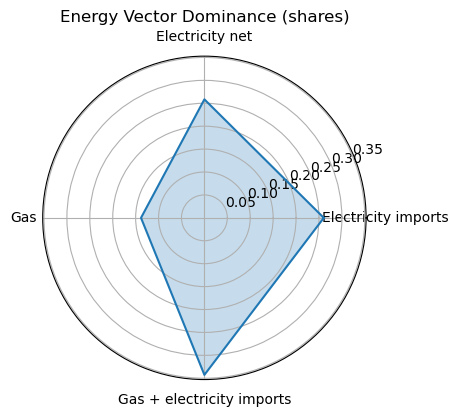

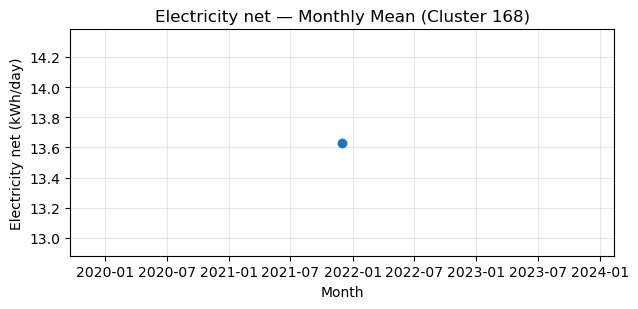

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2021

=== Cluster 169 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Dec 2021


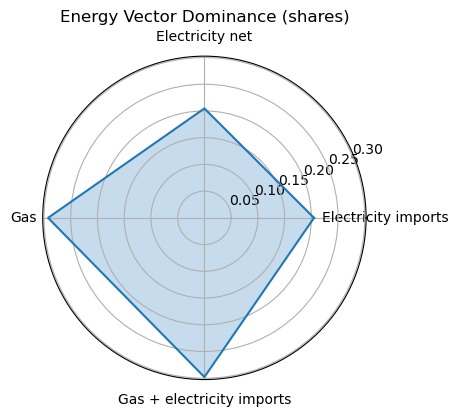

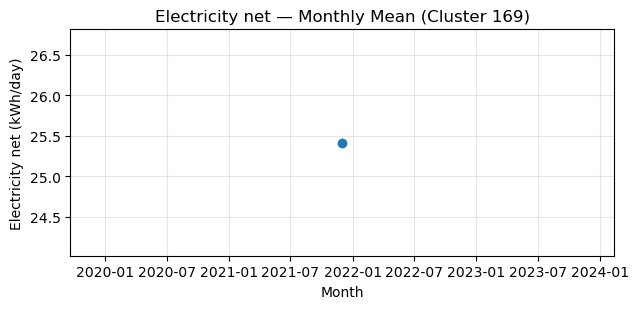

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2021

=== Cluster 170 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Mar 2022


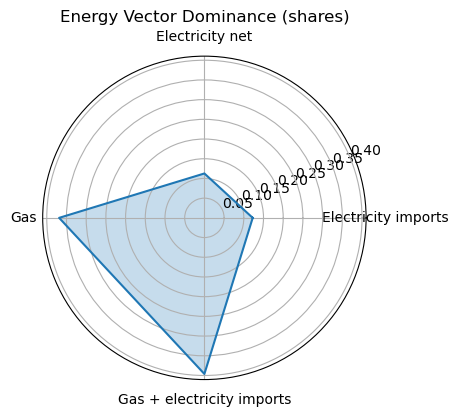

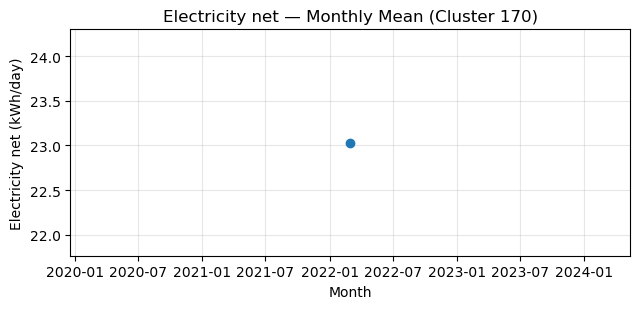

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2022

=== Cluster 171 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Mar 2022


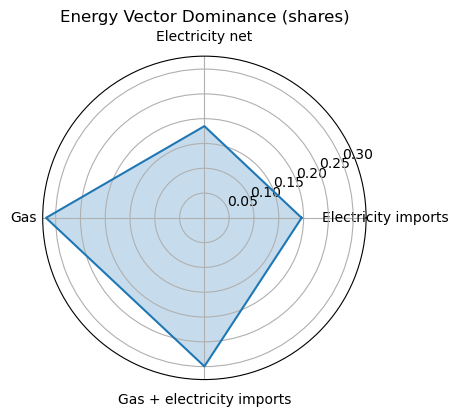

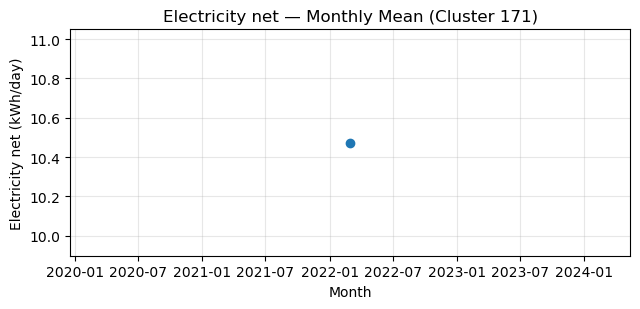

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2022

=== Cluster 172 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Mar 2021


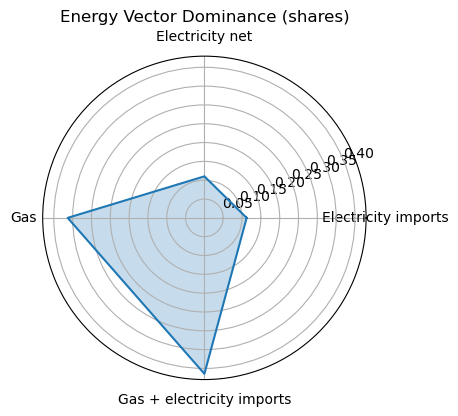

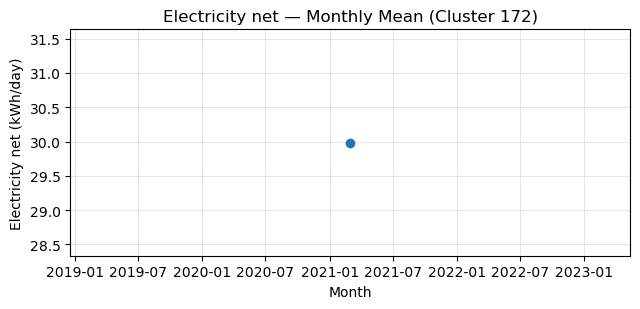

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2021

=== Cluster 173 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in May 2022


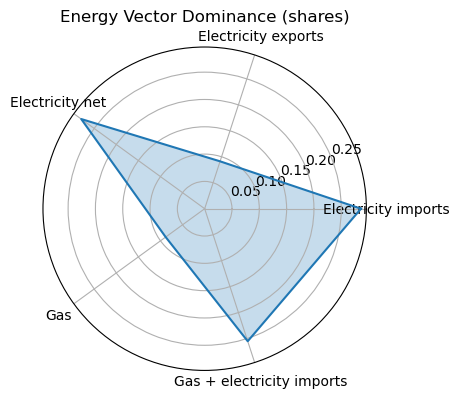

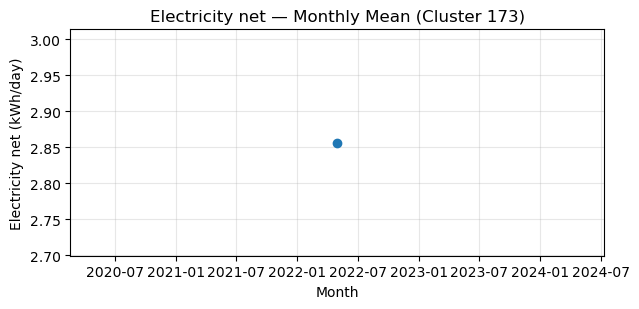

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2022

=== Cluster 174 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Feb 2023


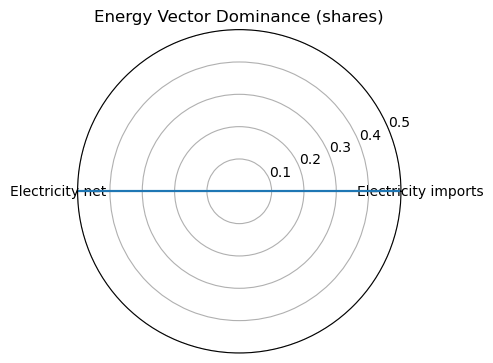

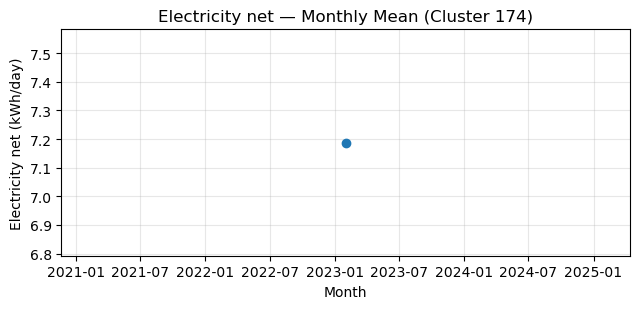

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2023

=== Cluster 175 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Nov 2021


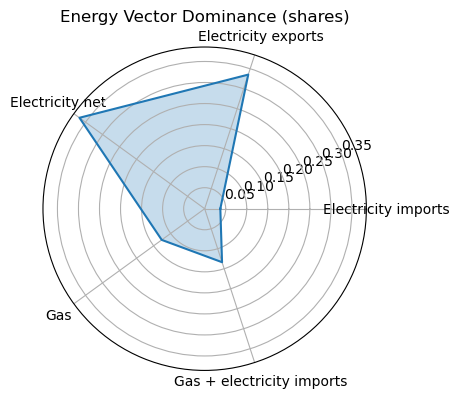

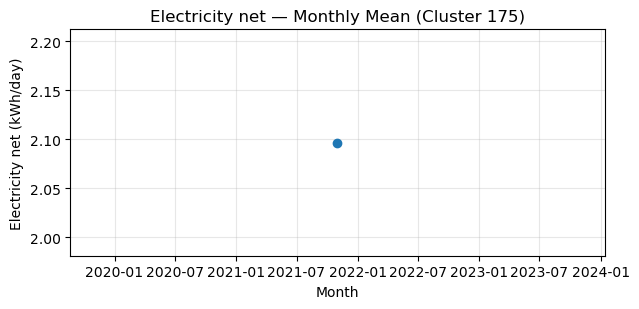

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2021

=== Cluster 176 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Nov 2023


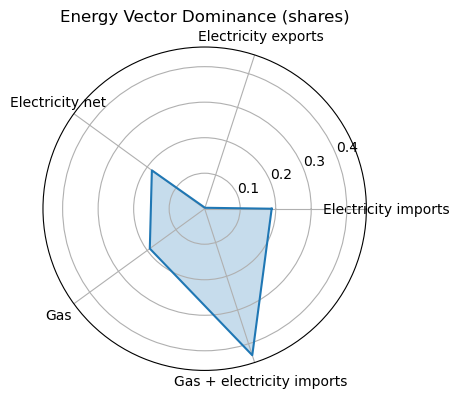

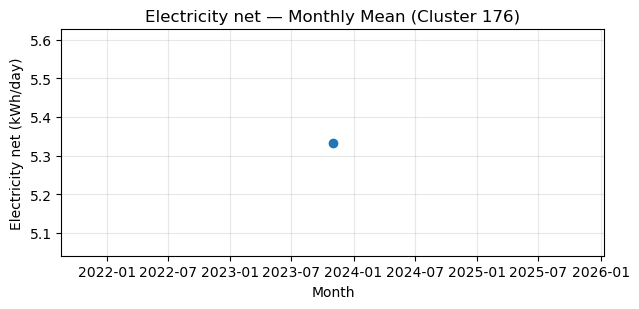

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2023

=== Cluster 177 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Aug 2022


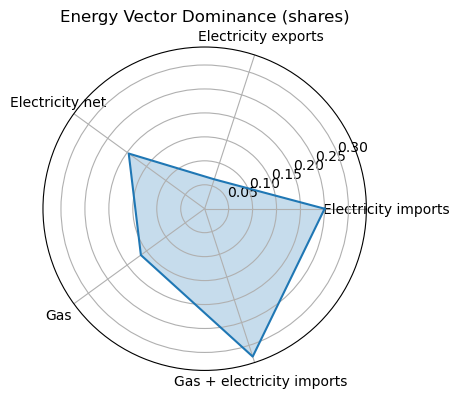

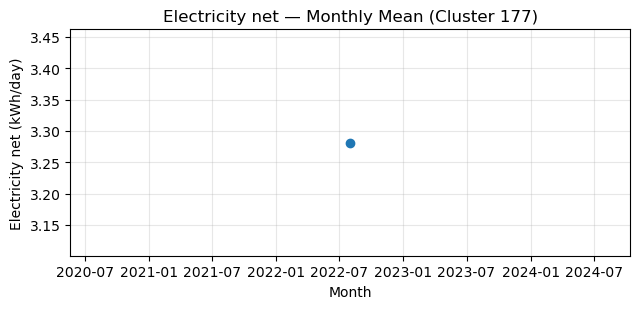

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Aug 2022

=== Cluster 178 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Nov 2021


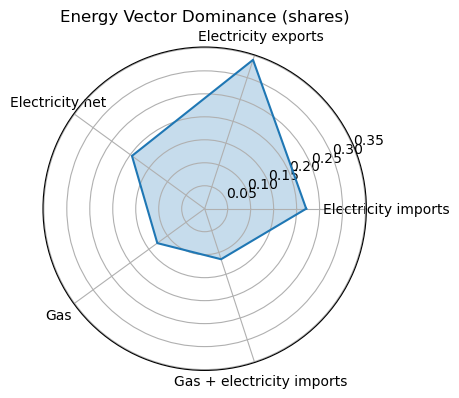

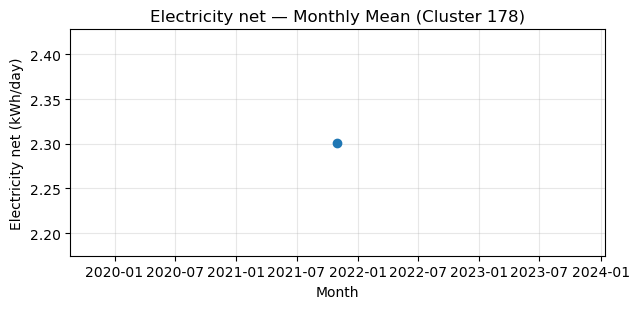

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2021

=== Cluster 179 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Jan 2023


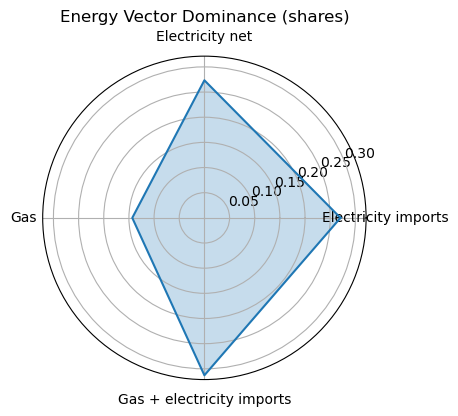

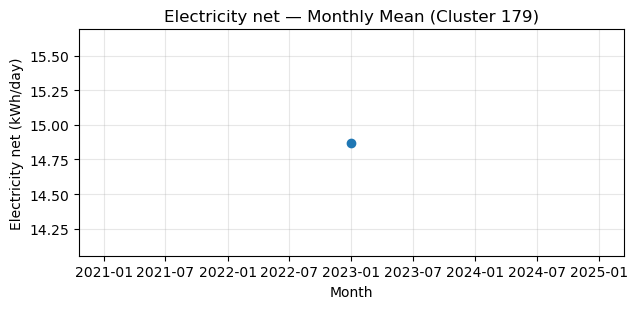

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2023

=== Cluster 180 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Jan 2023


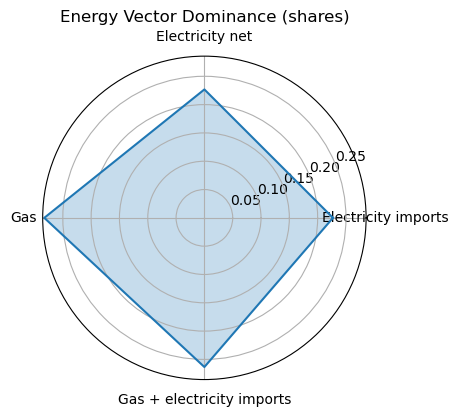

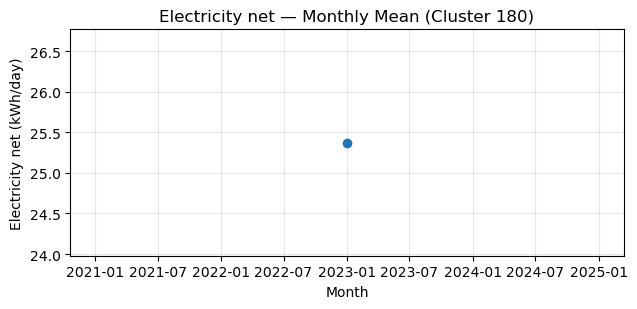

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Jan 2023

=== Cluster 181 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Apr 2021


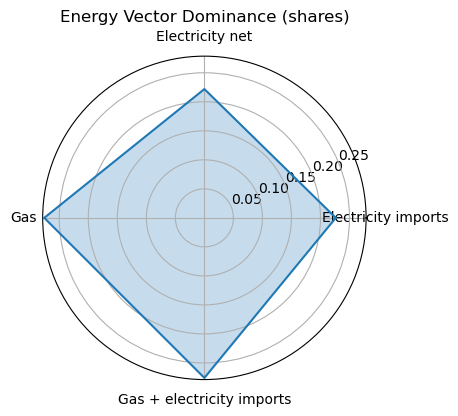

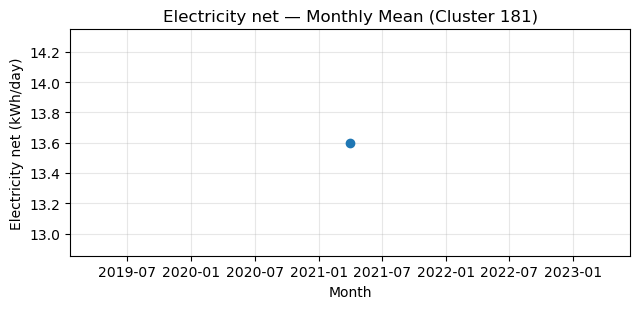

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2021

=== Cluster 182 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Apr 2021


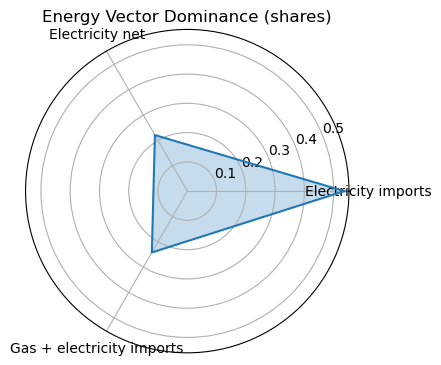

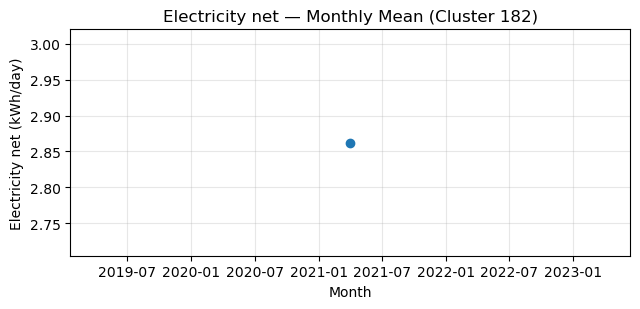

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Apr 2021

=== Cluster 183 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Aug 2022


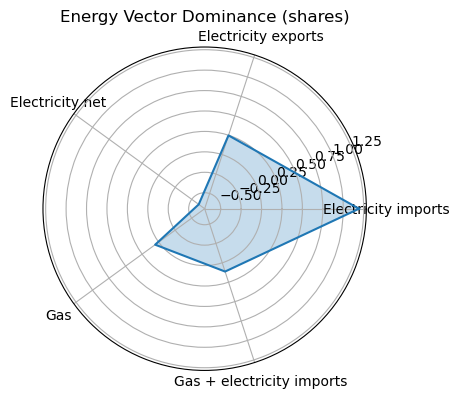

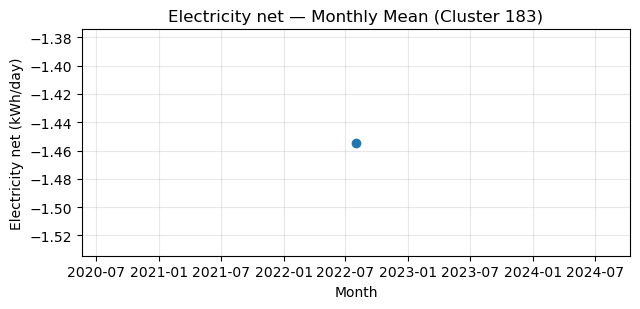

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Aug 2022

=== Cluster 184 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in Aug 2022


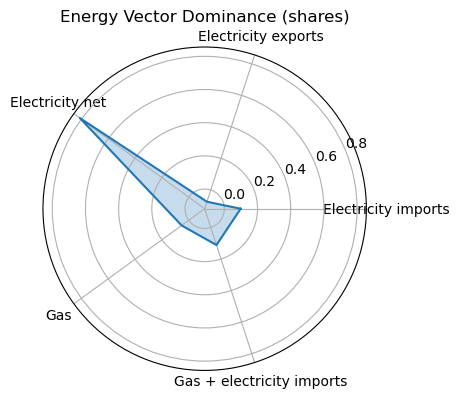

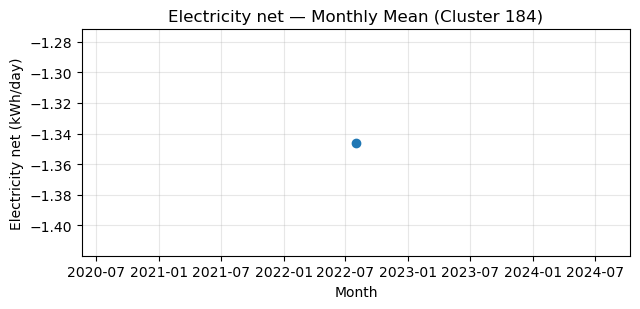

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Aug 2022

=== Cluster 185 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Feb 2023


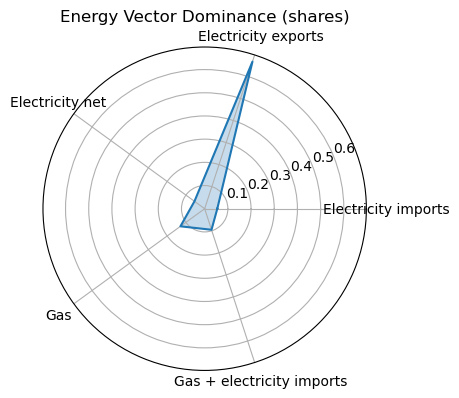

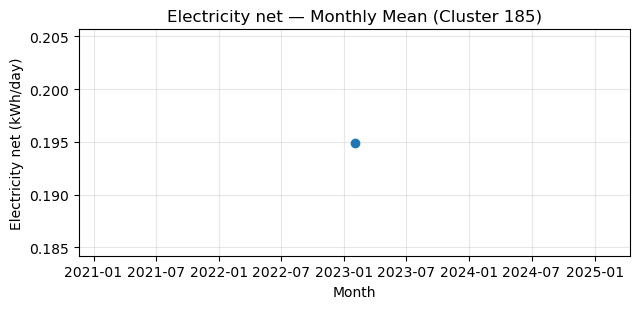

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2023

=== Cluster 186 ===
Persona Label: Solar Export-heavy, unknown seasonality, peak in Feb 2023


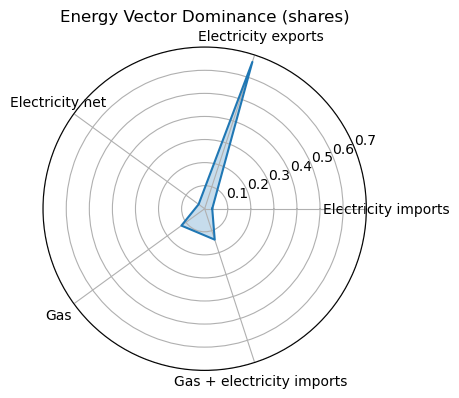

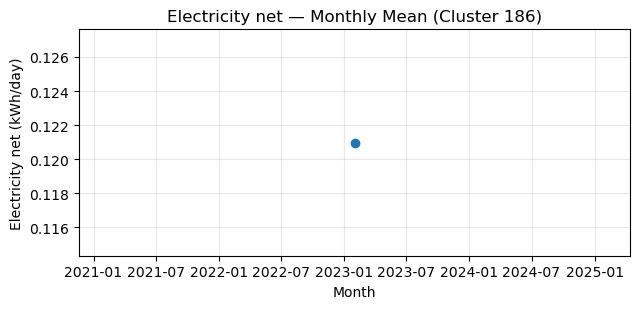

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2023

=== Cluster 187 ===
Persona Label: Mixed Imports, unknown seasonality, peak in May 2022


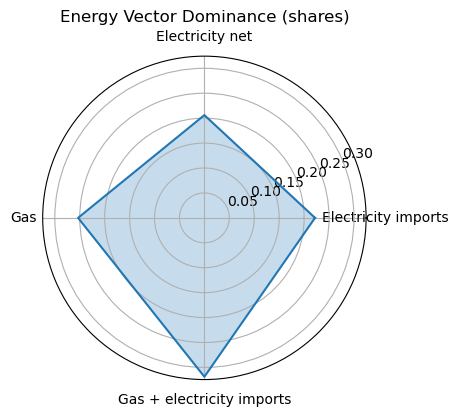

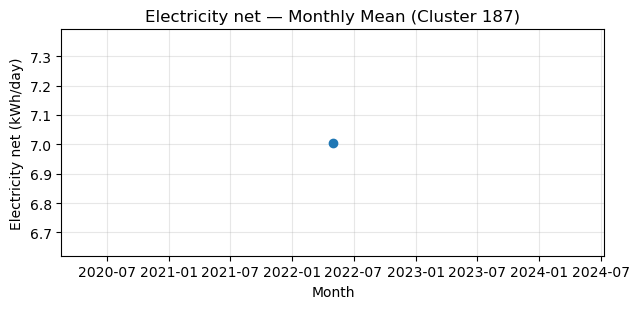

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2022

=== Cluster 188 ===
Persona Label: Net Electricity-heavy, unknown seasonality, peak in May 2022


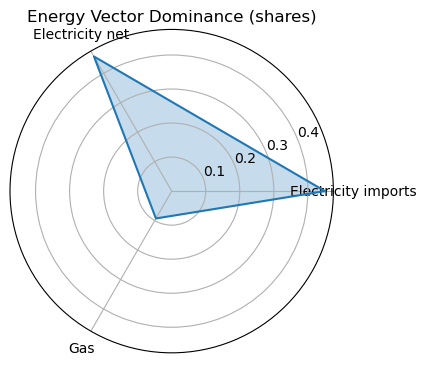

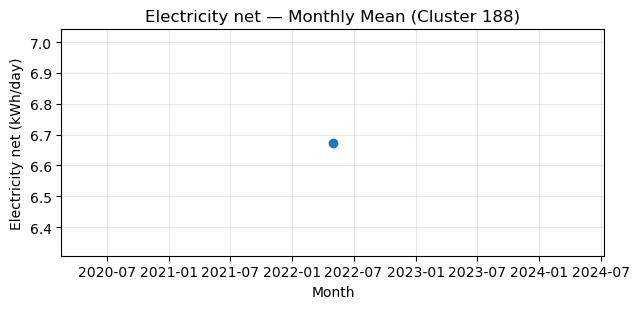

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: May 2022

=== Cluster 189 ===
Persona Label: Grid Import-heavy, unknown seasonality, peak in Nov 2021


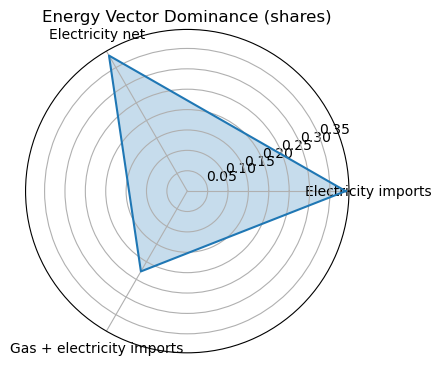

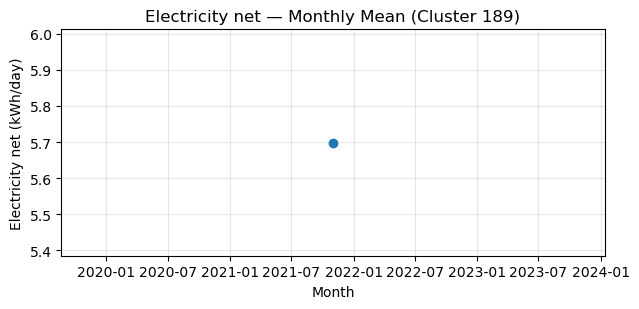

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2021

=== Cluster 190 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Mar 2021


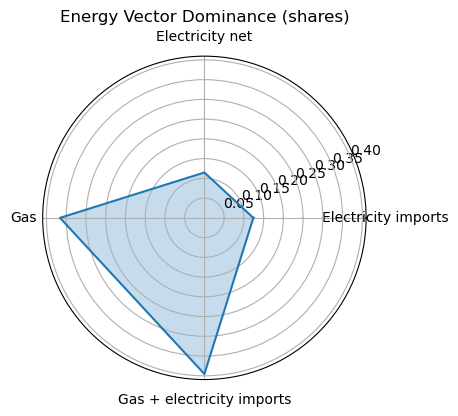

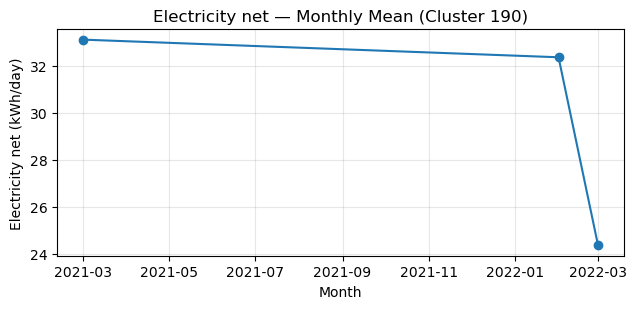

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Mar 2021

=== Cluster 191 ===
Persona Label: Gas-reliant, unknown seasonality, peak in Feb 2022


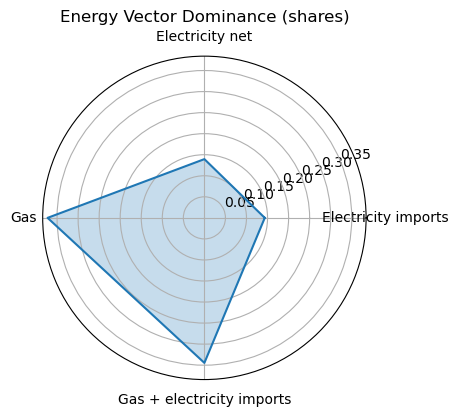

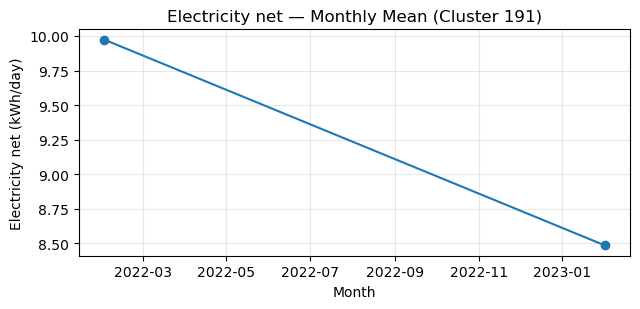

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Feb 2022

=== Cluster 192 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Dec 2021


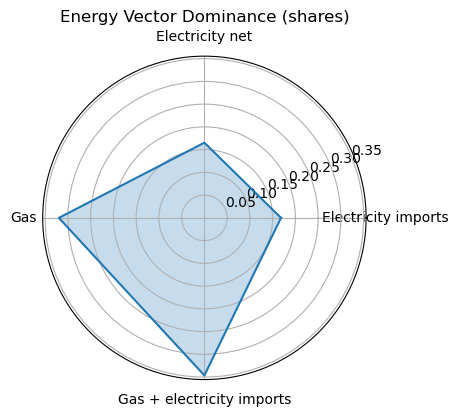

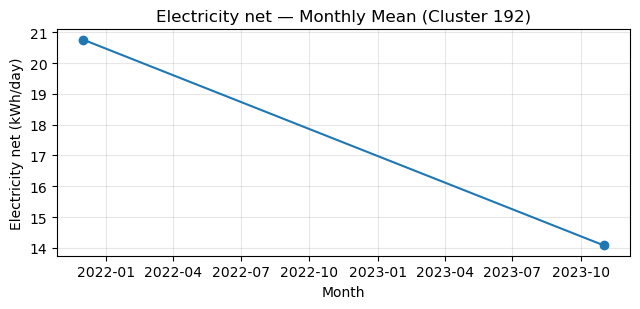

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Dec 2021

=== Cluster 193 ===
Persona Label: Mixed Imports, unknown seasonality, peak in Nov 2021


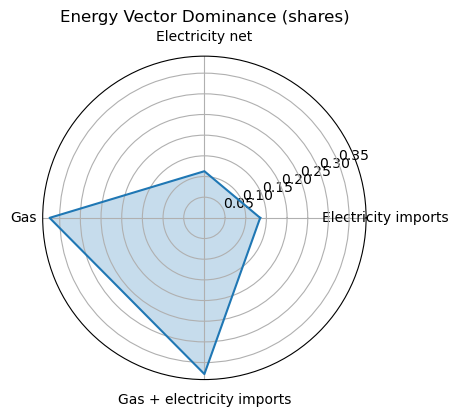

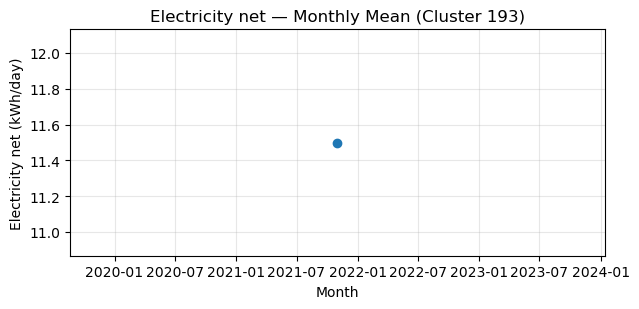

Target series: Electricity net | Seasonality strength (12-mo STL): unknown
Peak month: Nov 2021
Saved summary to: /Users/akanksha/Downloads/ERP_DSM_Dissertation_2025/code/cluster_persona_summary.csv


,cluster,dominant_vector,seasonality_strength,peak_month,persona_label,share_Electricity exports,share_Electricity imports,share_Electricity net,share_Gas,share_Gas + electricity imports
0,0,Gas + electricity imports,0.954335,Dec 2022,"Mixed Imports, strongly seasonal, peak in Dec ...",0.013216,0.141996,0.129009,0.341007,0.374773
1,1,Gas,NaN,Dec 2022,"Gas-reliant, unknown seasonality, peak in Dec ...",0.008292,0.140848,0.133052,0.362563,0.355246
2,2,Gas,NaN,Nov 2021,"Gas-reliant, unknown seasonality, peak in Nov ...",0.004118,0.106151,0.102014,0.394292,0.393424
3,3,Gas + electricity imports,NaN,Dec 2022,"Mixed Imports, unknown seasonality, peak in De...",0.007945,0.112544,0.104602,0.377333,0.397576
4,4,Gas + electricity imports,NaN,Apr 2023,"Mixed Imports, unknown seasonality, peak in Ap...",0.065265,0.171192,0.101476,0.122419,0.539648


In [1]:
import pandas as pd, numpy as np, matplotlib.pyplot as plt, math, warnings
from pathlib import Path
from statsmodels.tsa.seasonal import STL

# === CONFIG ===
CSV = Path("/Users/akanksha/Downloads/ERP_DSM_Dissertation_2025/code/clustering_results.csv")

# === LOAD ===
df = pd.read_csv(CSV)

# Basic sanity: we expect these columns in your file
required = {"aggregation_period","quantity","unit","mean","cluster"}
missing = required - set(df.columns)
if missing:
    raise ValueError(f"Missing required columns in CSV: {missing}")

# Parse monthly aggregation into datetime
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    # handles both 'YYYY-MM' and full dates
    df["aggregation_period"] = pd.to_datetime(df["aggregation_period"].astype(str), errors="coerce")

# OPTIONAL: filter to a canonical slice to reduce duplicates across segments
# (e.g., take all records but average over segmentation columns).
seg_cols = [c for c in ["weekday_weekend","primary_space_heating_fuel","has_PV","segmentation_variable_3","segment_3_value"] if c in df.columns]

base = df.copy()
# If you want only the "both / All / All" slice, uncomment:
# if "weekday_weekend" in base: base = base[base["weekday_weekend"].eq("both")]
# if "primary_space_heating_fuel" in base: base = base[base["primary_space_heating_fuel"].eq("All")]
# if "has_PV" in base: base = base[base["has_PV"].eq("All")]

# Collapse any remaining segmentation by averaging 'mean' within (cluster, quantity, month, unit)
group_keys = ["cluster","quantity","unit","aggregation_period"]
val = base.groupby(group_keys, dropna=False)["mean"].mean().reset_index()

# We’ll work cluster-by-cluster (skip noise cluster -1 if present)
clusters = sorted(k for k in val["cluster"].dropna().unique() if int(k) != -1)

# Helper: choose a target quantity to analyze for seasonality/line plot
def pick_target(avail_quantities):
    # prefer Electricity net -> Electricity imports -> Gas -> the first available
    order = ["Electricity net","Electricity imports","Gas","Gas + electricity imports","Electricity exports"]
    for q in order:
        if q in avail_quantities:
            return q
    return avail_quantities[0]

# Seasonality strength for monthly data (period=12)
def seasonality_strength_monthly(series):
    s = series.dropna()
    if len(s) < 36:  # need at least ~3 years for a decent seasonal read; relax if needed
        # still try with STL if at least 18 months
        if len(s) < 18:
            return float("nan")
    try:
        res = STL(s, period=12, robust=True).fit()
        var_resid = np.var(res.resid)
        var_seas  = np.var(res.seasonal + res.resid)
        return 0.0 if var_seas == 0 else float(1.0 - var_resid/var_seas)
    except Exception:
        return float("nan")

# Persona label builder (peak month instead of peak hour)
def persona_label(dominant, seas, peak_month_name):
    dom_map = {
        "Electricity imports": "Grid Import-heavy",
        "Electricity exports": "Solar Export-heavy",
        "Electricity net":     "Net Electricity-heavy",
        "Gas":                 "Gas-reliant",
        "Gas + electricity imports": "Mixed Imports",
        None:                  "Mixed"
    }
    dom = dom_map.get(dominant, "Mixed")
    if isinstance(seas, float) and math.isnan(seas):
        seas_label = "unknown seasonality"
    elif seas >= 0.70:
        seas_label = "strongly seasonal"
    elif seas >= 0.40:
        seas_label = "seasonal"
    else:
        seas_label = "weakly seasonal"
    peak_label = f"peak in {peak_month_name}" if peak_month_name else "peak month unknown"
    return f"{dom}, {seas_label}, {peak_label}"

# Display overall info
print("Unique quantities:", sorted(val["quantity"].unique()))
print("Units present:", sorted(val["unit"].unique()))

# Iterate clusters and show inline “cards”
for cid in clusters:
    sub = val[val["cluster"] == cid]

    # Compute dominance shares by quantity using mean of 'mean' across months/units
    # (If multiple units exist, we compute per unit then average normalized shares.)
    shares_rows = []
    for u in sub["unit"].unique():
        su = sub[sub["unit"] == u]
        q_means = su.groupby("quantity")["mean"].mean()
        denom = q_means.sum()
        if denom == 0 or np.isnan(denom):
            continue
        shares_rows.append((u, (q_means / denom)))
    if shares_rows:
        # average shares across units to a single vector
        aligned = pd.DataFrame({u: s for u, s in shares_rows}).fillna(0.0)
        share_vec = aligned.mean(axis=1)  # mean across units
    else:
        share_vec = pd.Series(dtype=float)

    # Dominant vector
    dominant = share_vec.idxmax() if not share_vec.empty else None

    # Pick target quantity for time-series seasonality
    avail_q = sorted(sub["quantity"].unique())
    target_q = pick_target(avail_q)

    # Build a monthly series for target (aggregate across units by averaging)
    ts = (sub[sub["quantity"] == target_q]
          .groupby("aggregation_period")["mean"]
          .mean()
          .sort_index())

    # Seasonality (monthly)
    seas_strength = seasonality_strength_monthly(ts)

    # Peak month
    if ts.dropna().empty:
        peak_month_name = None
    else:
        peak_tstamp = ts.idxmax()
        peak_month_name = peak_tstamp.strftime("%b %Y") if pd.notna(peak_tstamp) else None

    # Persona label text
    label = persona_label(dominant, seas_strength, peak_month_name)

    # === PRINT HEADER ===
    print(f"\n=== Cluster {int(cid)} ===")
    print("Persona Label:", label)

    # === RADAR: quantity shares ===
    if not share_vec.empty:
        # ensure consistent order for display (these will appear if present)
        order = ["Electricity imports","Electricity exports","Electricity net","Gas","Gas + electricity imports"]
        labels = [q for q in order if q in share_vec.index]
        vals   = [float(share_vec[q]) for q in labels]
        # close the loop
        stats = vals + vals[:1]
        angles = np.linspace(0, 2*np.pi, len(stats))
        fig = plt.figure(figsize=(4.2,4.2))
        ax = plt.subplot(111, polar=True)
        ax.plot(angles, stats)
        ax.fill(angles, stats, alpha=0.25)
        ax.set_xticks(angles[:-1])
        ax.set_xticklabels(labels)
        ax.set_title("Energy Vector Dominance (shares)")
        plt.show()
    else:
        print("(No share vector available for this cluster)")

    # === LINE: monthly series for target quantity ===
    if not ts.empty:
        plt.figure(figsize=(6.5,3.2))
        plt.plot(ts.index, ts.values, marker="o")
        plt.title(f"{target_q} — Monthly Mean (Cluster {int(cid)})")
        plt.xlabel("Month")
        plt.ylabel(f"{target_q} ({sub['unit'].iloc[0]})")
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.show()

        # Quick annotation
        seas_txt = "unknown" if (isinstance(seas_strength,float) and math.isnan(seas_strength)) else f"{seas_strength:.2f}"
        print(f"Target series: {target_q} | Seasonality strength (12-mo STL): {seas_txt}")
        if peak_month_name:
            print(f"Peak month: {peak_month_name}")
    else:
        print("(No time series available for target quantity)")

# === COLLECT SUMMARY FOR CSV ===
rows = []
for cid in clusters:
    sub = val[val["cluster"] == cid]

    # Compute shares
    shares_rows = []
    for u in sub["unit"].unique():
        su = sub[sub["unit"] == u]
        q_means = su.groupby("quantity")["mean"].mean()
        denom = q_means.sum()
        if denom == 0 or np.isnan(denom): 
            continue
        shares_rows.append((u, (q_means / denom)))
    if shares_rows:
        aligned = pd.DataFrame({u: s for u, s in shares_rows}).fillna(0.0)
        share_vec = aligned.mean(axis=1)
    else:
        share_vec = pd.Series(dtype=float)

    dominant = share_vec.idxmax() if not share_vec.empty else None
    avail_q = sorted(sub["quantity"].unique())
    target_q = pick_target(avail_q)
    ts = (sub[sub["quantity"] == target_q]
          .groupby("aggregation_period")["mean"]
          .mean()
          .sort_index())

    seas_strength = seasonality_strength_monthly(ts)
    if ts.dropna().empty:
        peak_month_name = None
    else:
        peak_tstamp = ts.idxmax()
        peak_month_name = peak_tstamp.strftime("%b %Y") if pd.notna(peak_tstamp) else None

    label = persona_label(dominant, seas_strength, peak_month_name)

    row = {
        "cluster": int(cid),
        "dominant_vector": dominant,
        "seasonality_strength": seas_strength,
        "peak_month": peak_month_name,
        "persona_label": label
    }

    # add shares for each quantity (columns like share_Electricity imports)
    for q in share_vec.index:
        row[f"share_{q}"] = share_vec[q]

    rows.append(row)

summary = pd.DataFrame(rows)

# === SAVE TO CSV ===
out_csv = CSV.parent / "cluster_persona_summary.csv"
summary.to_csv(out_csv, index=False)
print("Saved summary to:", out_csv)

# Show a preview
display(summary.head())


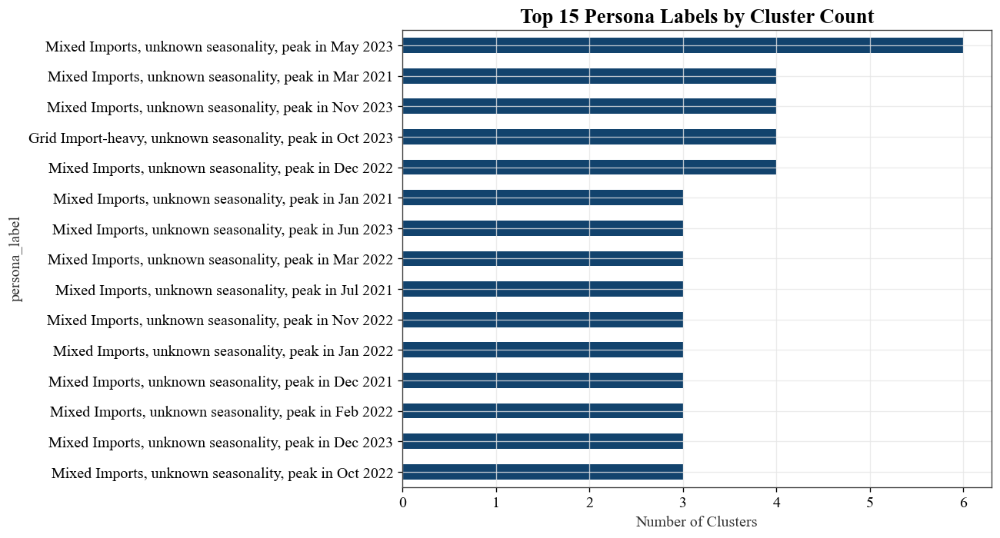

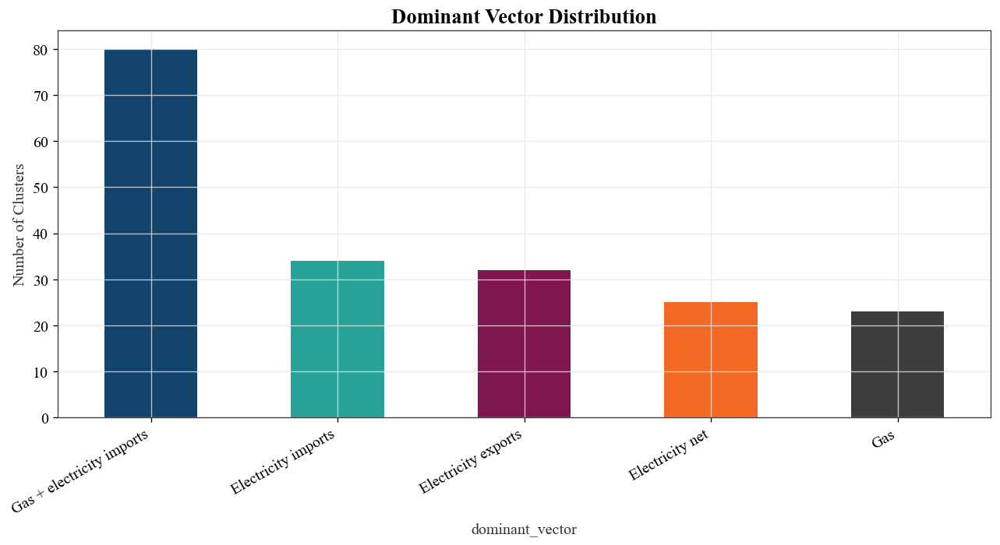

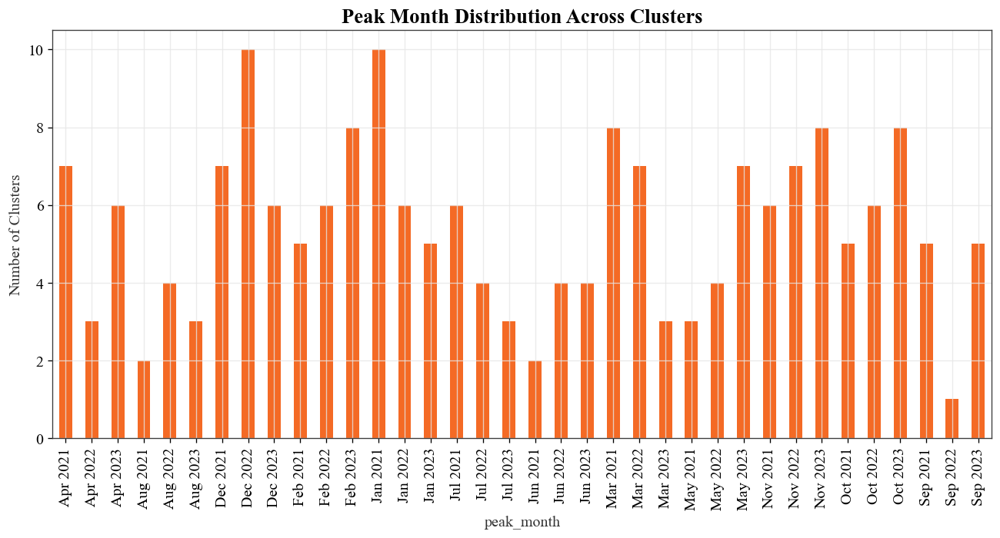

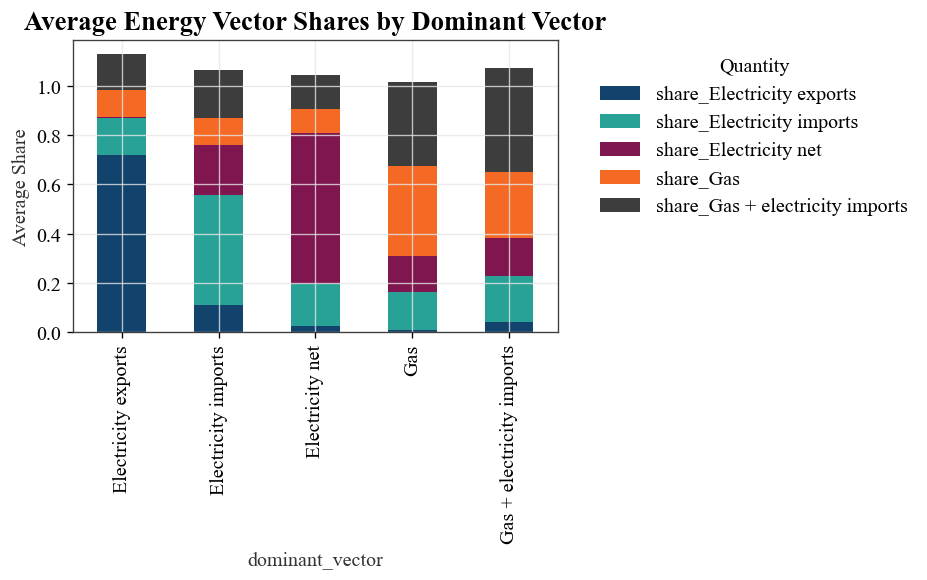

In [13]:
import matplotlib.pyplot as plt

# Define theme colors
PRIMARY_COLOR    = "#12436D"  # Dark blue
TURQUOISE_COLOR  = "#28A197"  # Turquoise
DARK_PINK_COLOR  = "#801650"  # Dark pink
ORANGE_COLOR     = "#F46A25"  # Orange
DARK_GREY        = "#3D3D3D"  # Dark grey
LIGHT_PURPLE     = "#A285D1"  # Light purple
LIGHT_BG         = "#F5F5F5"  # Light gray background
DARK_TEXT        = "#333333"  # Dark text

PALETTE = [
    PRIMARY_COLOR, TURQUOISE_COLOR, DARK_PINK_COLOR, ORANGE_COLOR,
    DARK_GREY, LIGHT_PURPLE
]
YEAR_COLORS = {2020: PRIMARY_COLOR, 2021: TURQUOISE_COLOR, 2022: DARK_PINK_COLOR, 2023: ORANGE_COLOR}

def set_theme():
    plt.rcParams.update({
        "figure.figsize": (11, 6),
        "figure.dpi": 120,
        "figure.facecolor": "#ffffff",
        "axes.facecolor": "#ffffff",
        "axes.edgecolor": DARK_GREY,
        "axes.labelcolor": DARK_TEXT,
        "axes.titlesize": 16,
        "axes.titleweight": "bold",
        "grid.color": "#E6E6E6",
        "grid.alpha": 0.8,
        "axes.grid": True,
        "font.size": 12,
        "legend.frameon": False,
        "legend.edgecolor": "#00000000",
    })

# Apply theme
set_theme()

# --- Redraw the four plots with the theme applied ---

# 1. Top 15 persona labels
summary["persona_label"].value_counts().head(15).plot(
    kind="barh", color=PRIMARY_COLOR
)
plt.gca().invert_yaxis()
plt.title("Top 15 Persona Labels by Cluster Count")
plt.xlabel("Number of Clusters")
plt.tight_layout()
plt.show()

# 2. Dominant vector distribution
summary["dominant_vector"].value_counts().plot(
    kind="bar", color=PALETTE
)
plt.title("Dominant Vector Distribution")
plt.ylabel("Number of Clusters")
plt.xticks(rotation=30, ha="right")
plt.tight_layout()
plt.show()

# 3. Peak month distribution
summary["peak_month"].dropna().value_counts().sort_index().plot(
    kind="bar", color=ORANGE_COLOR
)
plt.title("Peak Month Distribution Across Clusters")
plt.ylabel("Number of Clusters")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

# 4. Average shares by dominant vector
share_cols = [c for c in summary.columns if c.startswith("share_")]
avg_shares = summary.groupby("dominant_vector")[share_cols].mean()

avg_shares.plot(kind="bar", stacked=True, figsize=(8,5), color=PALETTE)
plt.title("Average Energy Vector Shares by Dominant Vector")
plt.ylabel("Average Share")
plt.legend(title="Quantity", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()
